# 3D Multi-class Segmentation with UNETR  (Muscle, Fat (subcut and internal), Bone, spleen,psoas,spinal cord) - Testing Travastin Data alone

## Setup environment

In [1]:
!pip install -q "monai-weekly[nibabel, tqdm, einops]"
!python -c "import matplotlib" || pip install -q matplotlib
%matplotlib inline

In [2]:
import os
import shutil
import tempfile

import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

from monai.losses import DiceCELoss
from monai.inferers import sliding_window_inference
from monai.transforms import (
    AsDiscrete,
    EnsureChannelFirstd,
    AddChanneld,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandFlipd,
    RandCropByPosNegLabeld,
    RandShiftIntensityd,
    ScaleIntensityRanged,
    Spacingd,
    RandRotate90d,
    ToTensord,
)

from monai.config import print_config
from monai.metrics import DiceMetric
from monai.networks.nets import UNETR

from monai.data import (
    DataLoader,
    CacheDataset,
    load_decathlon_datalist,
    decollate_batch,
)


import torch

print_config()

MONAI version: 0.10.dev2231
Numpy version: 1.23.1
Pytorch version: 1.12.0+cu102
MONAI flags: HAS_EXT = False, USE_COMPILED = False, USE_META_DICT = False
MONAI rev id: 8236821c099e5997f7ad0410c5374e4472f4ed14
MONAI __file__: /home/adminbthomas/miniconda3/envs/PT02/lib/python3.9/site-packages/monai/__init__.py

Optional dependencies:
Pytorch Ignite version: 0.4.9
Nibabel version: 4.0.1
scikit-image version: 0.19.3
Pillow version: 9.2.0
Tensorboard version: 2.9.1
gdown version: 4.5.1
TorchVision version: 0.13.0+cu102
tqdm version: 4.64.0
lmdb version: 1.3.0
psutil version: 5.9.1
pandas version: 1.4.3
einops version: 0.4.1
transformers version: 4.20.1
mlflow version: 1.27.0
pynrrd version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



## Setup data directory

You can specify a directory with the `MONAI_DATA_DIRECTORY` environment variable.  
This allows you to save results and reuse downloads.  
If not specified a temporary directory will be used.

In [3]:
# directory = os.environ.get("MONAI_DATA_DIRECTORY")
root_dir = "/home/adminbthomas/Downloads/data"# root_dir = tempfile.mkdtemp() if directory is None else directory
print(root_dir)

/home/adminbthomas/Downloads/data


## Setup transforms for training and validation

In [4]:
train_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 2.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"],
            a_min=0,
            a_max=200,
            b_min=0.0,
            b_max=1.0,
            clip=False,
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        RandCropByPosNegLabeld(
            keys=["image", "label"],
            label_key="label",
            spatial_size=(96, 96, 48),
            pos=1,
            neg=1,
            num_samples=4,
            image_key="image",
            image_threshold=0,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[0],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[1],
            prob=0.10,
        ),
        RandFlipd(
            keys=["image", "label"],
            spatial_axis=[2],
            prob=0.10,
        ),
        RandRotate90d(
            keys=["image", "label"],
            prob=0.10,
            max_k=3,
        ),
        RandShiftIntensityd(
            keys=["image"],
            offsets=0.10,
            prob=0.50,
        ),
        ToTensord(keys=["image", "label"]),
    ]
)
val_transforms = Compose(
    [
        LoadImaged(keys=["image", "label"], ensure_channel_first=True),
#         AddChanneld(keys=["image", "label"]),
        Orientationd(keys=["image", "label"], axcodes="RAS"),
        Spacingd(
            keys=["image", "label"],
            pixdim=(1.5, 1.5, 2.0),
            mode=("bilinear", "nearest"),
        ),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=200, b_min=0.0, b_max=1.0, clip=False
        ),
        CropForegroundd(keys=["image", "label"], source_key="image"),
        ToTensord(keys=["image", "label"]),
    ]
)

### DATA

In [5]:
data_dir = os.path.join(root_dir,"013123_MR/")

In [6]:
# data_dir = os.path.join(root_dir,"013123_MR/")
split_JSON = "dataset_MR.json"
datasets = data_dir + split_JSON
datalist = load_decathlon_datalist(datasets, True, "training")
val_files = load_decathlon_datalist(datasets, True, "validation")
train_ds = CacheDataset(
    data=datalist,
    transform=train_transforms,
    cache_num=24,
    cache_rate=1.0,
    num_workers=8,
)
train_loader = DataLoader(
    train_ds, batch_size=1, shuffle=True, num_workers=8, pin_memory=True
)
val_ds = CacheDataset(
    data=val_files, transform=val_transforms, cache_num=6, cache_rate=1.0, num_workers=4
)
val_loader = DataLoader(
    val_ds, batch_size=1, shuffle=False, num_workers=4, pin_memory=True
)

Loading dataset: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  5.88it/s]


In [6]:
data_dir = os.path.join(root_dir,"013123_MR/")
print(data_dir)

/home/adminbthomas/Downloads/data/013123_MR/


## Check data shape and visualize

image shape: torch.Size([1, 250, 176, 49]), label shape: torch.Size([1, 250, 176, 49])


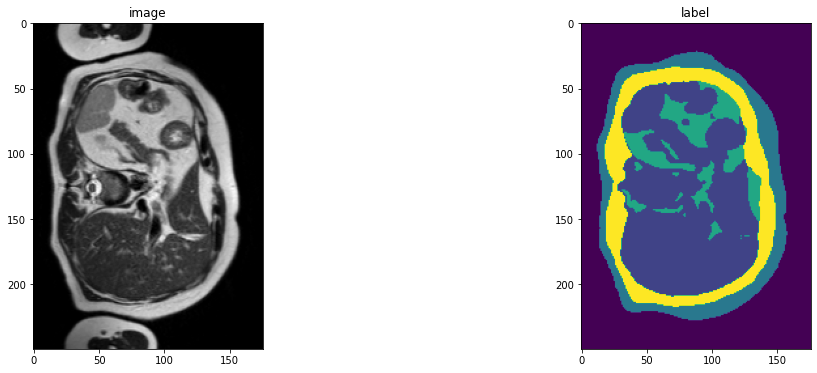

In [8]:
slice_map = {
    "A002_v3_T2W.nii.gz": 10,
    "A002_v3_T2W.nii.gz": 25,
    "A002_v3_T2W.nii.gz": 40
}
case_num = 0
img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
img = val_ds[case_num]["image"]
label = val_ds[case_num]["label"]
img_shape = img.shape
label_shape = label.shape
print(f"image shape: {img_shape}, label shape: {label_shape}")
plt.figure("image", (18, 6))
plt.subplot(1, 2, 1)
plt.title("image")
plt.imshow(img[0, :, :, slice_map[img_name]].detach().cpu(), cmap="gray")
plt.subplot(1, 2, 2)
plt.title("label")
plt.imshow(label[0, :, :, slice_map[img_name]].detach().cpu())
plt.show()

### Create Model, Loss, Optimizer


In [7]:
# os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
device = torch.device("cuda:0")

model = UNETR(
    in_channels=1,
    out_channels=6,
    img_size=(96, 96, 48),
    feature_size=16,
    hidden_size=768,
    mlp_dim=3072,
    num_heads=12,
    pos_embed="perceptron",
    norm_name="instance",
    res_block=True,
    dropout_rate=0.0,
).to(device)

loss_function = DiceCELoss(to_onehot_y=True, softmax=True)
torch.backends.cudnn.benchmark = True
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)

### Execute a typical PyTorch training process

In [9]:
def validation(epoch_iterator_val):
    model.eval()
    dice_vals = list()
    with torch.no_grad():
        for step, batch in enumerate(epoch_iterator_val):
            val_inputs, val_labels = (batch["image"].to(device), batch["label"].to(device))
            val_outputs = sliding_window_inference(val_inputs, (96, 96, 48), 4, model)
            val_labels_list = decollate_batch(val_labels)
            val_labels_convert = [
                post_label(val_label_tensor) for val_label_tensor in val_labels_list
            ]
            val_outputs_list = decollate_batch(val_outputs)
            val_output_convert = [
                post_pred(val_pred_tensor) for val_pred_tensor in val_outputs_list
            ]
            dice_metric(y_pred=val_output_convert, y=val_labels_convert)
            dice = dice_metric.aggregate().item()
            dice_vals.append(dice)
            epoch_iterator_val.set_description(
                "Validate (%d / %d Steps) (dice=%2.5f)" % (global_step, 10.0, dice)
            )
        dice_metric.reset()
    mean_dice_val = np.mean(dice_vals)
    return mean_dice_val


def train(global_step, train_loader, dice_val_best, global_step_best):
    model.train()
    epoch_loss = 0
    step = 0
    epoch_iterator = tqdm(
        train_loader, desc="Training (X / X Steps) (loss=X.X)", dynamic_ncols=True
    )
    for step, batch in enumerate(epoch_iterator):
        step += 1
        x, y = (batch["image"].to(device), batch["label"].to(device))
        logit_map = model(x)
        loss = loss_function(logit_map, y)
        loss.backward()
        epoch_loss += loss.item()
        optimizer.step()
        optimizer.zero_grad()
        epoch_iterator.set_description(
            "Training (%d / %d Steps) (loss=%2.5f)" % (global_step, max_iterations, loss)
        )
        if (
            global_step % eval_num == 0 and global_step != 0
        ) or global_step == max_iterations:
            epoch_iterator_val = tqdm(
                val_loader, desc="Validate (X / X Steps) (dice=X.X)", dynamic_ncols=True
            )
            dice_val = validation(epoch_iterator_val)
            epoch_loss /= step
            epoch_loss_values.append(epoch_loss)
            metric_values.append(dice_val)
            if dice_val > dice_val_best:
                dice_val_best = dice_val
                global_step_best = global_step
                torch.save(
                    model.state_dict(), os.path.join(data_dir, "best_metric_model_multiclassUNetR_MR02_May23.pth")
                )
                print(
                    "Model Was Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
            else:
                print(
                    "Model Was Not Saved ! Current Best Avg. Dice: {} Current Avg. Dice: {}".format(
                        dice_val_best, dice_val
                    )
                )
        global_step += 1
    return global_step, dice_val_best, global_step_best


max_iterations = 70000
eval_num = 500
post_label = AsDiscrete(to_onehot=6)
post_pred = AsDiscrete(argmax=True, to_onehot=6)
dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
global_step = 0
dice_val_best = 0.0
global_step_best = 0
epoch_loss_values = []
metric_values = []
while global_step < max_iterations:
    global_step, dice_val_best, global_step_best = train(
        global_step, train_loader, dice_val_best, global_step_best
    )
model.load_state_dict(torch.load(os.path.join(data_dir, "best_metric_model_multiclassUNetR_MR02_May23.pth")))

Training (500 / 70000 Steps) (loss=1.73551):  75%|█████████████████████████████████████████████▊               | 9/12 [00:09<00:06,  2.03s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6595682501792908 Current Avg. Dice: 0.6595682501792908


Validate (996 / 10 Steps) (dice=0.67570):  75%|████████████████████████████████████████████████▊                | 6/8 [00:04<00:01,  1.69it/s]


Training (1000 / 70000 Steps) (loss=1.32793):  42%|█████████████████████████                                   | 5/12 [00:07<00:16,  2.36s/it]

Model Was Saved ! Current Best Avg. Dice: 0.6838333159685135 Current Avg. Dice: 0.6838333159685135


Validate (1500 / 10 Steps) (dice=0.70981):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.71it/s]


Training (1500 / 70000 Steps) (loss=0.98923):   8%|█████                                                       | 1/12 [00:06<01:12,  6.56s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7180393785238266 Current Avg. Dice: 0.7180393785238266


Training (2000 / 70000 Steps) (loss=1.66183):  75%|█████████████████████████████████████████████               | 9/12 [00:09<00:06,  2.02s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7231377512216568 Current Avg. Dice: 0.7231377512216568


Validate (2496 / 10 Steps) (dice=0.72103):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.70it/s]


Training (2500 / 70000 Steps) (loss=0.87966):  42%|█████████████████████████                                   | 5/12 [00:07<00:16,  2.34s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7288098186254501 Current Avg. Dice: 0.7288098186254501


Validate (3000 / 10 Steps) (dice=0.72267):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.70it/s]


Training (3000 / 70000 Steps) (loss=0.67299):   8%|█████                                                       | 1/12 [00:06<01:11,  6.50s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7296841368079185 Current Avg. Dice: 0.7296841368079185


Training (3500 / 70000 Steps) (loss=0.91272):  75%|█████████████████████████████████████████████               | 9/12 [00:09<00:06,  2.03s/it]

Model Was Saved ! Current Best Avg. Dice: 0.749706819653511 Current Avg. Dice: 0.749706819653511


Validate (3996 / 10 Steps) (dice=0.74251):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.71it/s]


Training (4000 / 70000 Steps) (loss=0.73399):  42%|█████████████████████████                                   | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.749706819653511 Current Avg. Dice: 0.7485589757561684


Validate (4500 / 10 Steps) (dice=0.74984):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.70it/s]


Training (4500 / 70000 Steps) (loss=2.51216):   8%|█████                                                       | 1/12 [00:06<01:09,  6.30s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7557168900966644 Current Avg. Dice: 0.7557168900966644


Training (5000 / 70000 Steps) (loss=0.90594):  75%|█████████████████████████████████████████████               | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7557168900966644 Current Avg. Dice: 0.7544782683253288


Validate (5496 / 10 Steps) (dice=0.74152):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.71it/s]


Training (5500 / 70000 Steps) (loss=1.14606):  42%|█████████████████████████                                   | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7557168900966644 Current Avg. Dice: 0.7470946237444878


Validate (6000 / 10 Steps) (dice=0.75552):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.70it/s]


Training (6000 / 70000 Steps) (loss=0.76145):   8%|█████                                                       | 1/12 [00:06<01:09,  6.30s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7607414871454239


Training (6500 / 70000 Steps) (loss=0.69277):  75%|█████████████████████████████████████████████               | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7556444928050041


Validate (6996 / 10 Steps) (dice=0.75321):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.70it/s]


Training (7000 / 70000 Steps) (loss=2.51888):  42%|█████████████████████████                                   | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7599199265241623


Validate (7500 / 10 Steps) (dice=0.75345):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.72it/s]


Training (7500 / 70000 Steps) (loss=0.72571):   8%|█████                                                       | 1/12 [00:05<01:03,  5.79s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7573602572083473


Training (8000 / 70000 Steps) (loss=0.87023):  75%|█████████████████████████████████████████████               | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7550252974033356


Validate (8496 / 10 Steps) (dice=0.75565):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.71it/s]


Training (8500 / 70000 Steps) (loss=2.41608):  42%|█████████████████████████                                   | 5/12 [00:07<00:15,  2.18s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7607414871454239 Current Avg. Dice: 0.7604926005005836


Validate (9000 / 10 Steps) (dice=0.75681):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.71it/s]


Training (9000 / 70000 Steps) (loss=0.45554):   8%|█████                                                       | 1/12 [00:06<01:09,  6.33s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7610792890191078 Current Avg. Dice: 0.7610792890191078


Training (9500 / 70000 Steps) (loss=0.47278):  75%|█████████████████████████████████████████████               | 9/12 [00:09<00:06,  2.02s/it]

Model Was Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.7633209452033043


Validate (9996 / 10 Steps) (dice=0.75321):  75%|████████████████████████████████████████████████                | 6/8 [00:04<00:01,  1.72it/s]


Training (10000 / 70000 Steps) (loss=0.55323):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.16s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.7563779056072235


Validate (10500 / 10 Steps) (dice=0.75863):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.70it/s]


Training (10500 / 70000 Steps) (loss=0.45653):   8%|████▉                                                      | 1/12 [00:05<01:04,  5.88s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.7630301862955093


Training (11000 / 70000 Steps) (loss=0.78599):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.7607298865914345


Validate (11496 / 10 Steps) (dice=0.75386):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (11500 / 70000 Steps) (loss=0.54151):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.19s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.759241096675396


Validate (12000 / 10 Steps) (dice=0.75373):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (12000 / 70000 Steps) (loss=0.48688):   8%|████▉                                                      | 1/12 [00:05<01:03,  5.80s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.7633209452033043 Current Avg. Dice: 0.7594876438379288


Training (12500 / 70000 Steps) (loss=0.43933):  75%|████████████████████████████████████████████▎              | 9/12 [00:09<00:06,  2.03s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8011803701519966 Current Avg. Dice: 0.8011803701519966


Validate (12996 / 10 Steps) (dice=0.86531):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (13000 / 70000 Steps) (loss=1.13526):  42%|████████████████████████▌                                  | 5/12 [00:07<00:16,  2.30s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8680742159485817 Current Avg. Dice: 0.8680742159485817


Validate (13500 / 10 Steps) (dice=0.89088):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (13500 / 70000 Steps) (loss=0.46615):   8%|████▉                                                      | 1/12 [00:06<01:12,  6.55s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8892691284418106 Current Avg. Dice: 0.8892691284418106


Training (14000 / 70000 Steps) (loss=0.68518):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8892691284418106 Current Avg. Dice: 0.879797637462616


Validate (14496 / 10 Steps) (dice=0.88745):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (14500 / 70000 Steps) (loss=0.99804):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.16s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8892691284418106 Current Avg. Dice: 0.888271763920784


Validate (15000 / 10 Steps) (dice=0.89070):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (15000 / 70000 Steps) (loss=0.42738):   8%|████▉                                                      | 1/12 [00:06<01:10,  6.38s/it]

Model Was Saved ! Current Best Avg. Dice: 0.894015297293663 Current Avg. Dice: 0.894015297293663


Training (15500 / 70000 Steps) (loss=0.33767):  75%|████████████████████████████████████████████▎              | 9/12 [00:09<00:06,  2.05s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8971402123570442 Current Avg. Dice: 0.8971402123570442


Validate (15996 / 10 Steps) (dice=0.89451):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (16000 / 70000 Steps) (loss=0.40581):  42%|████████████████████████▌                                  | 5/12 [00:07<00:14,  2.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8971402123570442 Current Avg. Dice: 0.8946276530623436


Validate (16500 / 10 Steps) (dice=0.89781):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (16500 / 70000 Steps) (loss=0.37679):   8%|████▉                                                      | 1/12 [00:06<01:09,  6.35s/it]

Model Was Saved ! Current Best Avg. Dice: 0.8997250869870186 Current Avg. Dice: 0.8997250869870186


Training (17000 / 70000 Steps) (loss=0.45296):  75%|████████████████████████████████████████████▎              | 9/12 [00:09<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8997250869870186 Current Avg. Dice: 0.898655466735363


Validate (17496 / 10 Steps) (dice=0.89026):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (17500 / 70000 Steps) (loss=0.41181):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.8997250869870186 Current Avg. Dice: 0.8918789476156235


Validate (18000 / 10 Steps) (dice=0.90169):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (18000 / 70000 Steps) (loss=0.54343):   8%|████▉                                                      | 1/12 [00:06<01:09,  6.31s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9018696174025536 Current Avg. Dice: 0.9018696174025536


Training (18500 / 70000 Steps) (loss=0.58194):  75%|████████████████████████████████████████████▎              | 9/12 [00:09<00:05,  1.92s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9018696174025536 Current Avg. Dice: 0.9016276150941849


Validate (18996 / 10 Steps) (dice=0.88337):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (19000 / 70000 Steps) (loss=0.45841):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9018696174025536 Current Avg. Dice: 0.892887182533741


Validate (19500 / 10 Steps) (dice=0.88702):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (19500 / 70000 Steps) (loss=0.46066):   8%|████▉                                                      | 1/12 [00:05<01:05,  5.94s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9018696174025536 Current Avg. Dice: 0.8825860545039177


Training (20000 / 70000 Steps) (loss=0.35040):  75%|████████████████████████████████████████████▎              | 9/12 [00:09<00:06,  2.04s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9041412845253944 Current Avg. Dice: 0.9041412845253944


Validate (20496 / 10 Steps) (dice=0.90674):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (20500 / 70000 Steps) (loss=0.59157):  42%|████████████████████████▌                                  | 5/12 [00:07<00:16,  2.33s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.9065568894147873


Validate (21000 / 10 Steps) (dice=0.89601):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (21000 / 70000 Steps) (loss=0.36186):   8%|████▉                                                      | 1/12 [00:05<01:03,  5.77s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.8965150564908981


Training (21500 / 70000 Steps) (loss=0.43952):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.9032350927591324


Validate (21996 / 10 Steps) (dice=0.89969):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.70it/s]


Training (22000 / 70000 Steps) (loss=0.38022):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.18s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.8967937603592873


Validate (22500 / 10 Steps) (dice=0.89857):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.71it/s]


Training (22500 / 70000 Steps) (loss=0.32024):   8%|████▉                                                      | 1/12 [00:05<01:05,  5.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.9024160355329514


Training (23000 / 70000 Steps) (loss=0.41364):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.9014523774385452


Validate (23496 / 10 Steps) (dice=0.90420):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.70it/s]


Training (23500 / 70000 Steps) (loss=0.38431):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9065568894147873 Current Avg. Dice: 0.9031947329640388


Validate (24000 / 10 Steps) (dice=0.90957):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.70it/s]


Training (24000 / 70000 Steps) (loss=0.31165):   8%|████▉                                                      | 1/12 [00:06<01:09,  6.36s/it]

Model Was Saved ! Current Best Avg. Dice: 0.90877415984869 Current Avg. Dice: 0.90877415984869


Training (24500 / 70000 Steps) (loss=0.35058):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.90877415984869 Current Avg. Dice: 0.899516835808754


Validate (24996 / 10 Steps) (dice=0.87703):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (25000 / 70000 Steps) (loss=0.32183):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.17s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.90877415984869 Current Avg. Dice: 0.8910723254084587


Training (26000 / 70000 Steps) (loss=0.48749):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.90877415984869 Current Avg. Dice: 0.8917425274848938


Validate (26496 / 10 Steps) (dice=0.89320):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.69it/s]


Training (26500 / 70000 Steps) (loss=0.76421):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.20s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.90877415984869 Current Avg. Dice: 0.8978527337312698


Training (26954 / 70000 Steps) (loss=0.72951):  17%|█████████▊                                                 | 2/12 [00:01<00:05,  1.67it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Training (34000 / 70000 Steps) (loss=0.33345):  42%|████████████████████████▌                                  | 5/12 [00:07<00:16,  2.36s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9115899279713631 Current Avg. Dice: 0.9115899279713631


Validate (34500 / 10 Steps) (dice=0.90833):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.69it/s]


Training (34500 / 70000 Steps) (loss=0.42697):   8%|████▉                                                      | 1/12 [00:05<01:05,  5.94s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9115899279713631 Current Avg. Dice: 0.90885841101408


Training (34879 / 70000 Steps) (loss=0.51906):  58%|██████████████████████████████████▍                        | 7/12 [00:03<00:01,  2.54it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Training (42000 / 70000 Steps) (loss=0.41453):   8%|████▉                                                      | 1/12 [00:05<01:04,  5.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9086593240499496


Training (42500 / 70000 Steps) (loss=0.34242):  75%|████████████████████████████████████████████▎              | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9105133786797523


Validate (42996 / 10 Steps) (dice=0.90696):  75%|███████████████████████████████████████████████▎               | 6/8 [00:04<00:01,  1.72it/s]


Training (43000 / 70000 Steps) (loss=0.24552):  42%|████████████████████████▌                                  | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9078235253691673


Training (43038 / 70000 Steps) (loss=0.81570):  58%|██████████████████████████████████▍                        | 7/12 [00:03<00:01,  2.53it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Training (44000 / 70000 Steps) (loss=0.73070):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.8943386077880859


Training (44500 / 70000 Steps) (loss=0.50597):  42%|███████████▎               | 5/12 [00:07<00:15,  2.18s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9101784527301788


Training (45000 / 70000 Steps) (loss=0.28664):   8%|██▎                        | 1/12 [00:05<01:03,  5.80s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9012982547283173


Training (45500 / 70000 Steps) (loss=0.70764):  75%|████████████████████▎      | 9/12 [00:09<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9125770851969719 Current Avg. Dice: 0.9107913970947266


Training (46000 / 70000 Steps) (loss=0.40143):  42%|███████████▎               | 5/12 [00:08<00:16,  2.36s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9143706485629082


Training (46500 / 70000 Steps) (loss=0.65835):   8%|██▎                        | 1/12 [00:05<01:05,  5.96s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9053094759583473


Training (47000 / 70000 Steps) (loss=0.54620):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.90784952044487


Training (47500 / 70000 Steps) (loss=0.32536):  42%|███████████▎               | 5/12 [00:07<00:15,  2.19s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9106394052505493


Training (48000 / 70000 Steps) (loss=0.33190):   8%|██▎                        | 1/12 [00:05<01:02,  5.69s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.8994396105408669


Training (48500 / 70000 Steps) (loss=0.60417):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.88s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9130668714642525


Training (49000 / 70000 Steps) (loss=0.24850):  42%|███████████▎               | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9053486660122871


Training (49500 / 70000 Steps) (loss=0.32972):   8%|██▎                        | 1/12 [00:05<01:05,  5.92s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9090530052781105


Training (50000 / 70000 Steps) (loss=0.49132):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9062502086162567


Training (50500 / 70000 Steps) (loss=0.21378):  42%|███████████▎               | 5/12 [00:07<00:15,  2.16s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.907350055873394


Training (51000 / 70000 Steps) (loss=0.35420):   8%|██▎                        | 1/12 [00:05<01:03,  5.77s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9059532284736633


Training (51500 / 70000 Steps) (loss=0.25183):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9143706485629082 Current Avg. Dice: 0.9133781641721725


Training (52000 / 70000 Steps) (loss=0.42582):  42%|███████████▎               | 5/12 [00:07<00:16,  2.33s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9146601930260658


Training (52500 / 70000 Steps) (loss=0.34827):   8%|██▎                        | 1/12 [00:05<01:03,  5.81s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9090252369642258


Training (53000 / 70000 Steps) (loss=0.33877):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9097562655806541


Training (53500 / 70000 Steps) (loss=2.17314):  42%|███████████▎               | 5/12 [00:07<00:15,  2.18s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9082255661487579


Training (54000 / 70000 Steps) (loss=0.43950):   8%|██▎                        | 1/12 [00:05<01:05,  5.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9066788554191589


Training (54500 / 70000 Steps) (loss=0.24360):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9139024987816811


Training (55000 / 70000 Steps) (loss=0.37153):  42%|███████████▎               | 5/12 [00:07<00:15,  2.19s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9146601930260658 Current Avg. Dice: 0.9097342640161514


Training (55500 / 70000 Steps) (loss=0.34782):   8%|██▎                        | 1/12 [00:06<01:11,  6.46s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9153282716870308


Training (56000 / 70000 Steps) (loss=0.26508):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.92s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9087268710136414


Training (56500 / 70000 Steps) (loss=0.33275):  42%|███████████▎               | 5/12 [00:07<00:14,  2.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9141943603754044


Training (57000 / 70000 Steps) (loss=0.85519):   8%|██▎                        | 1/12 [00:06<01:06,  6.06s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.8890408053994179


Training (57500 / 70000 Steps) (loss=0.36079):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9070361033082008


Training (58000 / 70000 Steps) (loss=0.27925):  42%|███████████▎               | 5/12 [00:07<00:14,  2.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9126427546143532


Training (58500 / 70000 Steps) (loss=0.22031):   8%|██▎                        | 1/12 [00:05<01:02,  5.71s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9139693826436996


Training (59000 / 70000 Steps) (loss=0.45774):  75%|████████████████████▎      | 9/12 [00:09<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9091659709811211


Training (59500 / 70000 Steps) (loss=0.33195):  42%|███████████▎               | 5/12 [00:07<00:14,  2.14s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9007187187671661


Training (60000 / 70000 Steps) (loss=0.32653):   8%|██▎                        | 1/12 [00:05<01:04,  5.82s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.912916362285614


Training (60500 / 70000 Steps) (loss=0.34561):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9119405969977379


Training (61000 / 70000 Steps) (loss=0.34023):  42%|███████████▎               | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9106308072805405


Training (61500 / 70000 Steps) (loss=0.34101):   8%|██▎                        | 1/12 [00:05<01:03,  5.81s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9113129153847694


Training (62000 / 70000 Steps) (loss=0.31798):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9138938561081886


Training (62500 / 70000 Steps) (loss=0.31682):  42%|███████████▎               | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9098273664712906


Training (63000 / 70000 Steps) (loss=0.27580):   8%|██▎                        | 1/12 [00:05<01:05,  5.93s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9135713949799538


Training (63500 / 70000 Steps) (loss=0.39825):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9034035727381706


Training (64000 / 70000 Steps) (loss=0.33593):  42%|███████████▎               | 5/12 [00:07<00:15,  2.18s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9107341542840004


Training (64500 / 70000 Steps) (loss=0.28132):   8%|██▎                        | 1/12 [00:05<01:04,  5.88s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9126982688903809


Training (65000 / 70000 Steps) (loss=0.39011):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.89s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9153282716870308 Current Avg. Dice: 0.9105226397514343


Training (65500 / 70000 Steps) (loss=0.30266):  42%|███████████▎               | 5/12 [00:07<00:16,  2.37s/it]

Model Was Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9164848998188972


Training (66000 / 70000 Steps) (loss=0.24095):   8%|██▎                        | 1/12 [00:05<01:03,  5.75s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9135380238294601


Training (66500 / 70000 Steps) (loss=0.49556):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.90s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9155158922076225


Training (67000 / 70000 Steps) (loss=0.56908):  42%|███████████▎               | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9041058197617531


Training (67500 / 70000 Steps) (loss=0.34412):   8%|██▎                        | 1/12 [00:06<01:06,  6.05s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9074089229106903


Training (68000 / 70000 Steps) (loss=0.18199):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.91s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9131054505705833


Training (68500 / 70000 Steps) (loss=0.40650):  42%|███████████▎               | 5/12 [00:07<00:15,  2.15s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9112697616219521


Training (69000 / 70000 Steps) (loss=0.30896):   8%|██▎                        | 1/12 [00:06<01:07,  6.13s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9095511958003044


Training (69500 / 70000 Steps) (loss=0.27301):  75%|████████████████████▎      | 9/12 [00:08<00:05,  1.87s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9106263592839241


Training (70000 / 70000 Steps) (loss=0.44070):  42%|███████████▎               | 5/12 [00:07<00:15,  2.20s/it]

Model Was Not Saved ! Current Best Avg. Dice: 0.9164848998188972 Current Avg. Dice: 0.9119865745306015


Training (70007 / 70000 Steps) (loss=0.21264): 100%|██████████████████████████| 12/12 [00:10<00:00,  1.18it/s]


<All keys matched successfully>

In [10]:
print(
    f"train completed, best_metric: {dice_val_best:.4f} "
    f"at iteration: {global_step_best}"
)

train completed, best_metric: 0.9165 at iteration: 65500


In [ ]:
6062500/380133
12062500/731025
250*250*49
12062500/(250*250)

### Plot the loss and metric

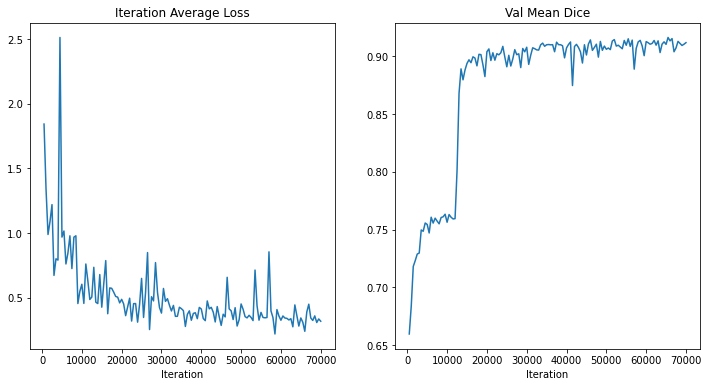

In [11]:
plt.figure("train", (12, 6))
plt.subplot(1, 2, 1)
plt.title("Iteration Average Loss")
x = [eval_num * (i + 1) for i in range(len(epoch_loss_values))]
y = epoch_loss_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.subplot(1, 2, 2)
plt.title("Val Mean Dice")
x = [eval_num * (i + 1) for i in range(len(metric_values))]
y = metric_values
plt.xlabel("Iteration")
plt.plot(x, y)
plt.show()

### Check best model output with the input image and label

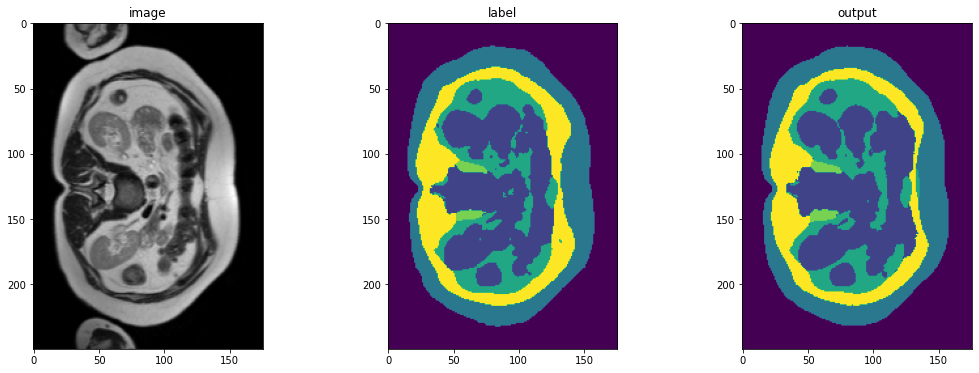

In [12]:
case_num = 0
model.load_state_dict(torch.load(os.path.join(data_dir, "best_metric_model_multiclassUNetR_MR02_May23.pth")))
model.eval()
with torch.no_grad():
    img_name = os.path.split(val_ds[case_num]["image_meta_dict"]["filename_or_obj"])[1]
    img = val_ds[case_num]["image"]
    label = val_ds[case_num]["label"]
    val_inputs = torch.unsqueeze(img, 1).to(device)
    val_labels = torch.unsqueeze(label, 1).to(device)
    val_outputs = sliding_window_inference(
        val_inputs, (96, 96, 48), 4, model, overlap=0.8
    )
    plt.figure("check", (18, 6))
    plt.subplot(1, 3, 1)
    plt.title("image")
    plt.imshow(val_inputs.cpu().numpy()[0, 0, :, :, 5], cmap="gray")
    plt.subplot(1, 3, 2)
    plt.title("label")
    plt.imshow(val_labels.cpu().numpy()[0, 0, :, :, 5])
    plt.subplot(1, 3, 3)
    plt.title("output")
    plt.imshow(
        torch.argmax(val_outputs, dim=1).detach().cpu()[0, :, :, 5]
    )
    plt.show()
    

In [ ]:
val_inputs.shape

### Inference on test images

In [ ]:
# if directory is None:
#     shutil.rmtree(root_dir)

In [8]:
import glob
from monai.data import Dataset
from monai.handlers.utils import from_engine
from monai.transforms import (
    AsDiscrete,
    AsDiscreted,
    EnsureChannelFirstd,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandCropByPosNegLabeld,
    SaveImaged,
    ScaleIntensityRanged,
    Spacingd,
    EnsureTyped,
    EnsureType,
    Invertd,
)

test_images = sorted(
    glob.glob(os.path.join(data_dir, "imagesTs/AllVisits", "*.nii.gz")))

test_data = [{"image": image} for image in test_images]


test_org_transforms = Compose(
    [
        LoadImaged(keys="image"),
        EnsureChannelFirstd(keys="image"),
        Orientationd(keys=["image"], axcodes="RAS"),
        Spacingd(keys=["image"], pixdim=(
            1.5, 1.5, 2.0), mode="bilinear"),
        ScaleIntensityRanged(
            keys=["image"], a_min=0, a_max=200,
            b_min=0.0, b_max=1.0, clip=False,
        ),
        CropForegroundd(keys=["image"], source_key="image"),
        EnsureTyped(keys="image"),
    ]
)

test_org_ds = Dataset(
    data=test_data, transform=test_org_transforms)

test_org_loader = DataLoader(test_org_ds, batch_size=1, num_workers=4)

post_transforms = Compose([
    EnsureTyped(keys="pred"),
    Invertd(
        keys="pred",
        transform=test_org_transforms,
        orig_keys="image",
        meta_keys="pred_meta_dict",
        orig_meta_keys="image_meta_dict",
        meta_key_postfix="meta_dict",
        nearest_interp=False,
        to_tensor=True,
    ),
    AsDiscreted(keys="pred", argmax=True, to_onehot=6),
    SaveImaged(keys="pred", meta_keys="pred_meta_dict", output_dir="./outMR02_Jul23_plotcohorts", output_postfix="seg", resample=False, separate_folder=False),
])

In [9]:
print(data_dir)

/home/adminbthomas/Downloads/data/013123_MR/


Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]
Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]
Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]
Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]


2023-07-17 11:25:27,678 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A002_v1_T2W_seg.nii.gz


Modifying image pixdim from [1.4648438 1.4648438 4.        0.       ] to [  1.46484375   1.46484375   4.         268.45717811]


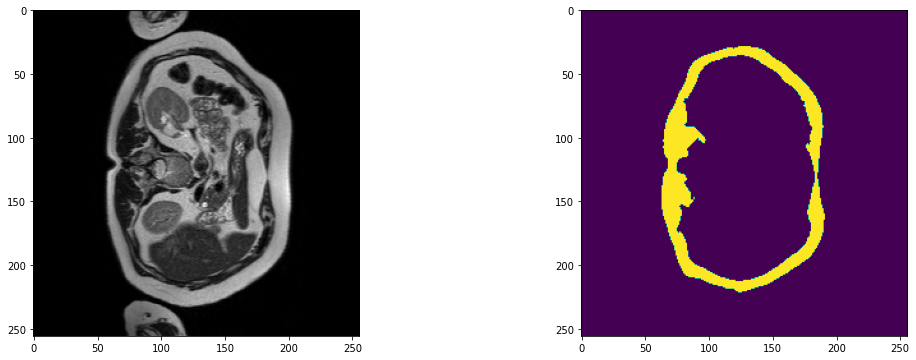

2023-07-17 11:25:30,599 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A002_v2_T2W_seg.nii.gz


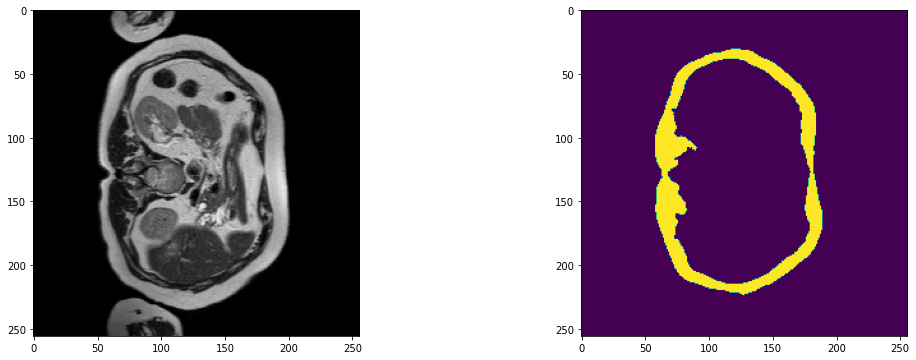

2023-07-17 11:25:33,422 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A002_v3_T2W_seg.nii.gz


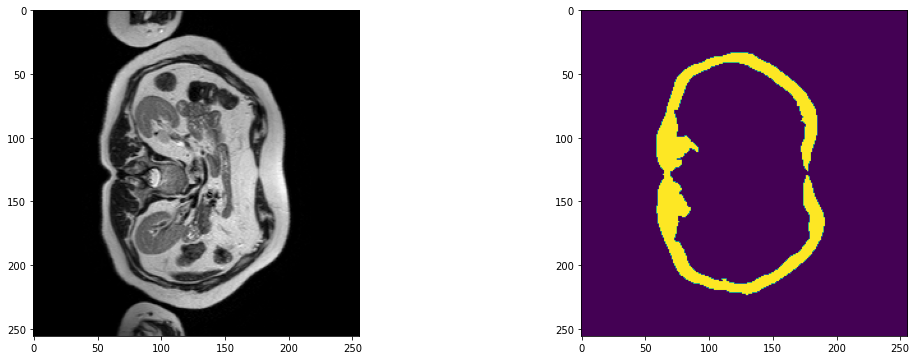

2023-07-17 11:25:36,389 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A002_v4_T2W_seg.nii.gz


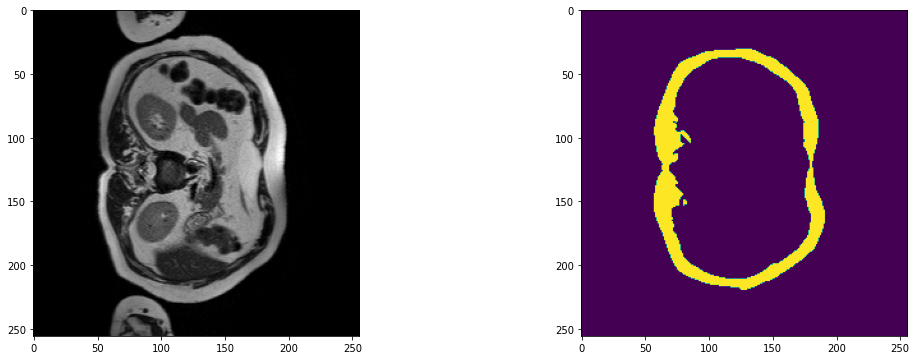

2023-07-17 11:25:39,275 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A002_v5_T2W_seg.nii.gz


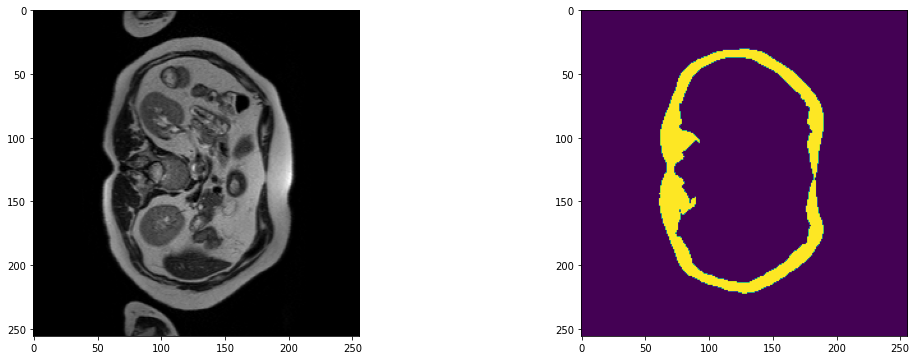

2023-07-17 11:25:42,106 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v1_T2W_seg.nii.gz


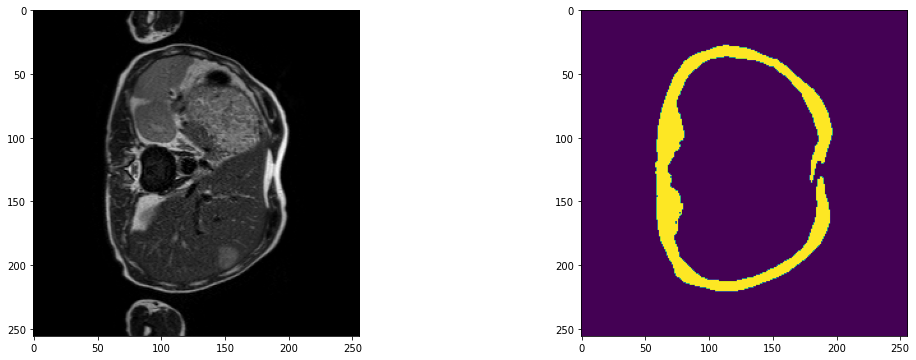

2023-07-17 11:25:44,918 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v2_T2W_seg.nii.gz


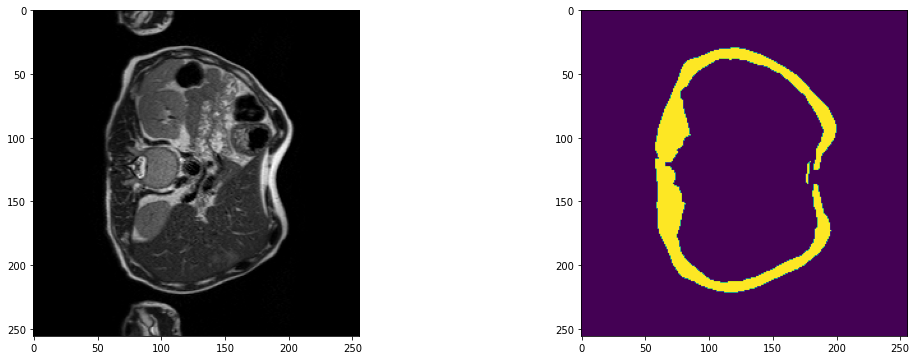

2023-07-17 11:25:47,758 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v3_T2W_seg.nii.gz


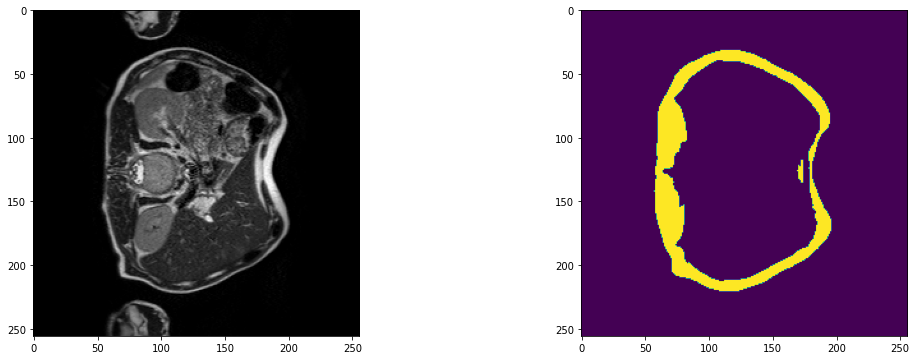

2023-07-17 11:25:50,625 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v4_T2W_seg.nii.gz


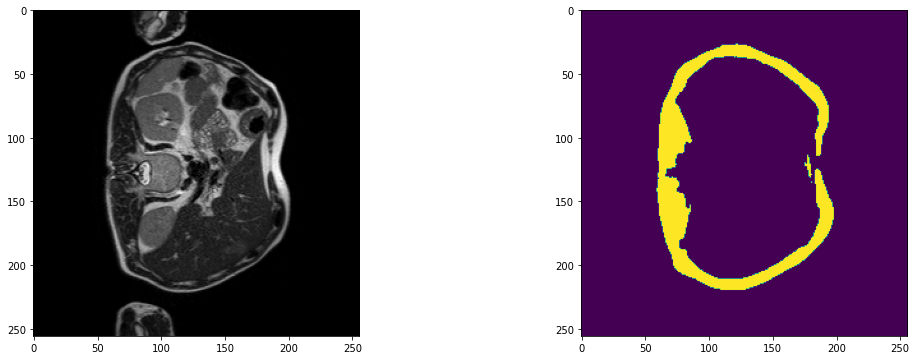

2023-07-17 11:25:53,499 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v5_T2W_seg.nii.gz


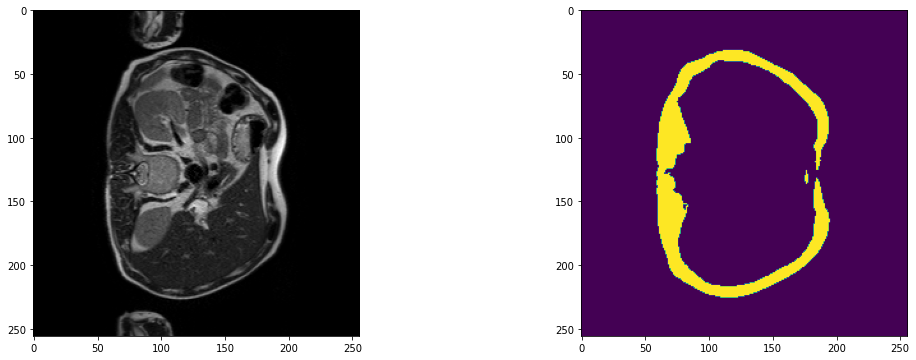

2023-07-17 11:25:56,340 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v6_T2W_seg.nii.gz


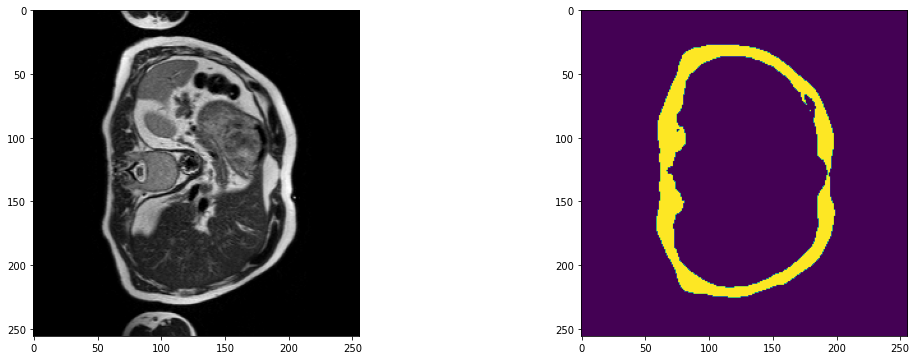

2023-07-17 11:25:59,201 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A003_v7_T2W_seg.nii.gz


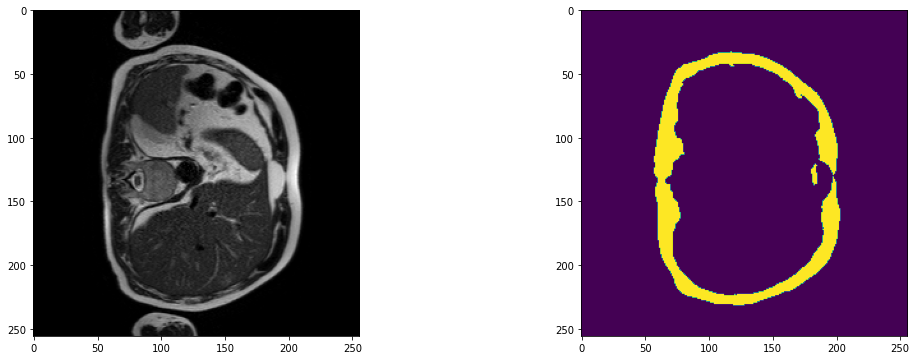

2023-07-17 11:26:02,070 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v1_T2W_seg.nii.gz


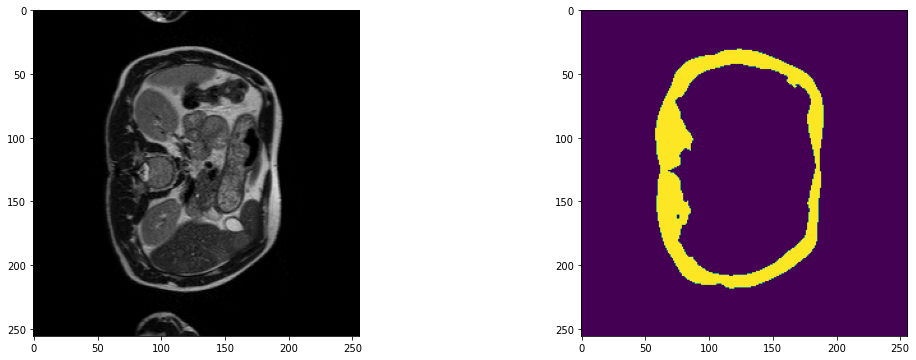

2023-07-17 11:26:04,991 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v2_T2W_seg.nii.gz


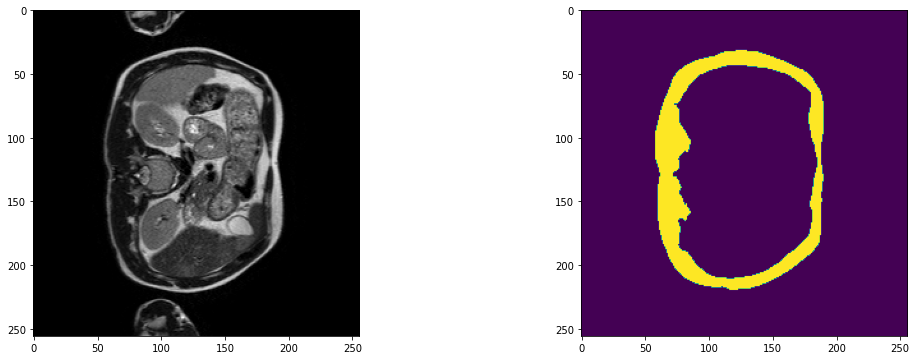

2023-07-17 11:26:07,868 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v3_T2W_seg.nii.gz


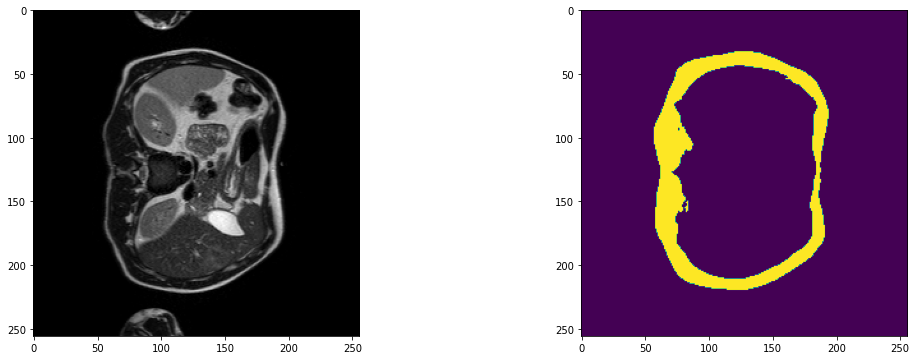

2023-07-17 11:26:10,741 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v4_T2W_seg.nii.gz


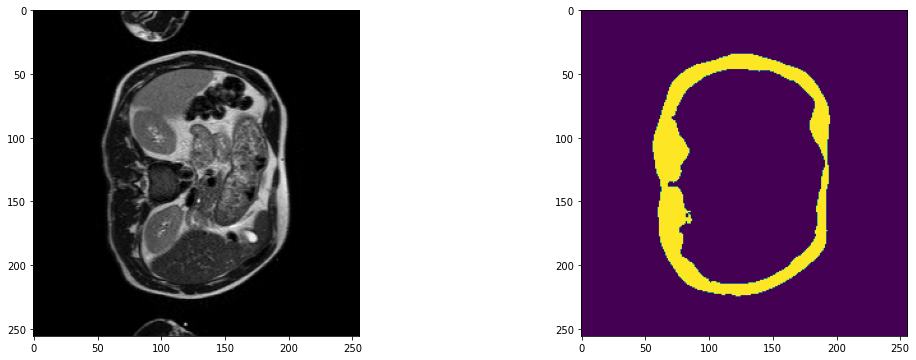

2023-07-17 11:26:13,778 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v5_T2W_seg.nii.gz


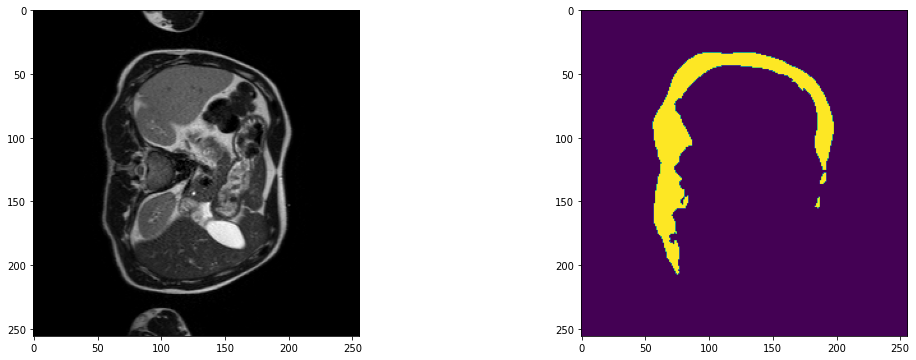

2023-07-17 11:26:16,664 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A009_v6_T2W_seg.nii.gz


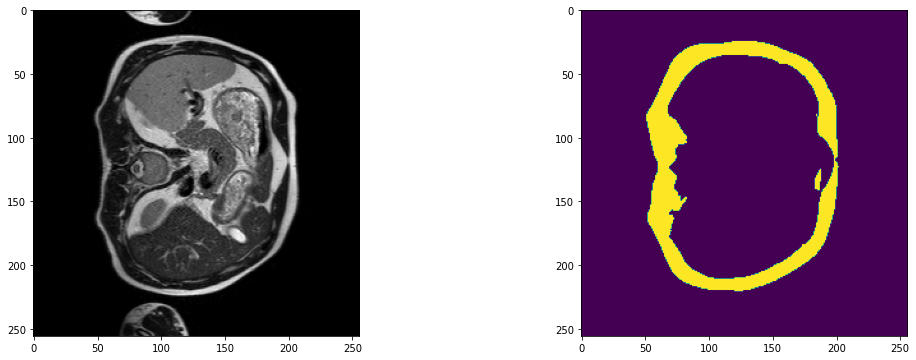

2023-07-17 11:26:19,537 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v1_T2W_seg.nii.gz


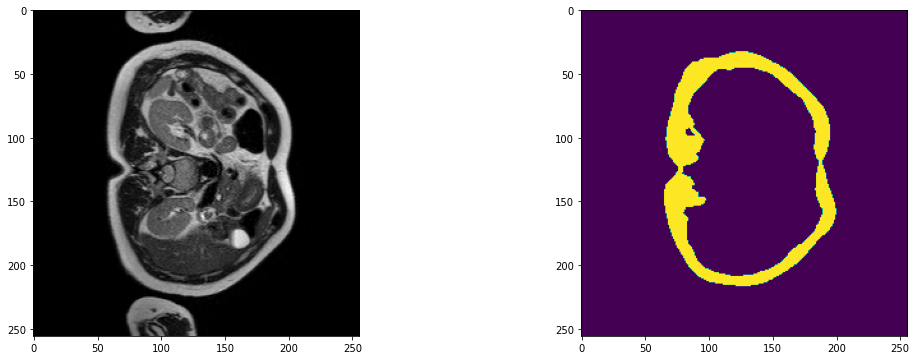

2023-07-17 11:26:22,411 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v2_T2W_seg.nii.gz


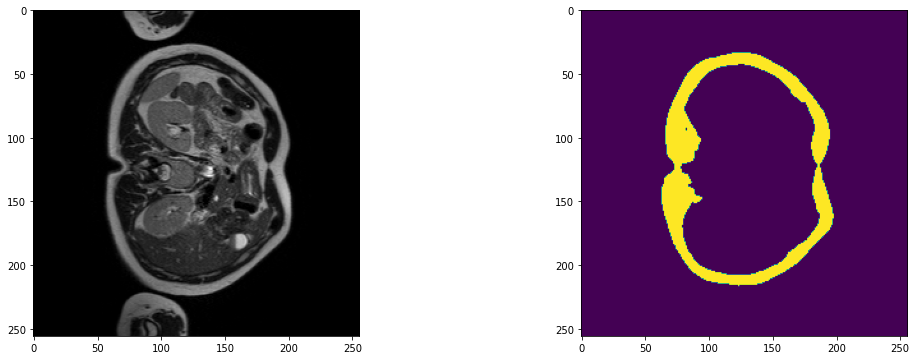

2023-07-17 11:26:25,290 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v3_T2W_seg.nii.gz


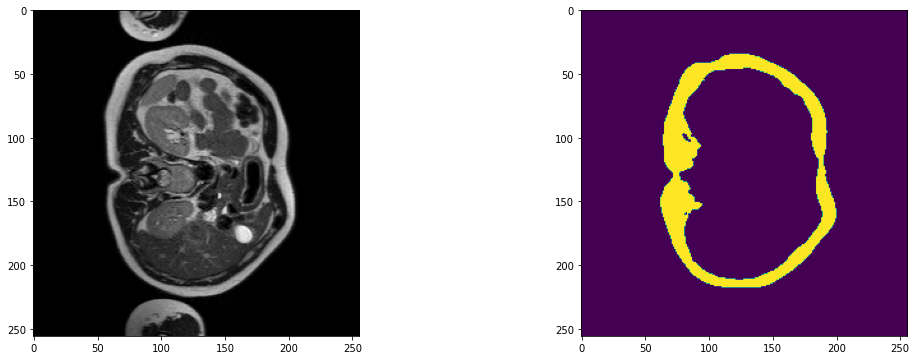

2023-07-17 11:26:28,176 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v4_T2W_seg.nii.gz


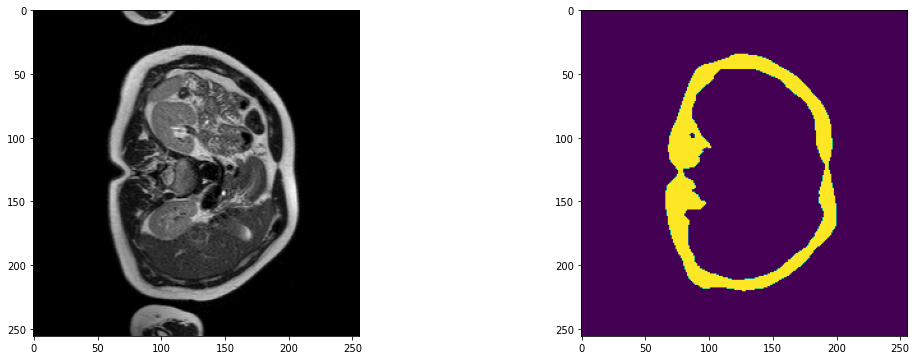

2023-07-17 11:26:31,067 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v5_T2W_seg.nii.gz


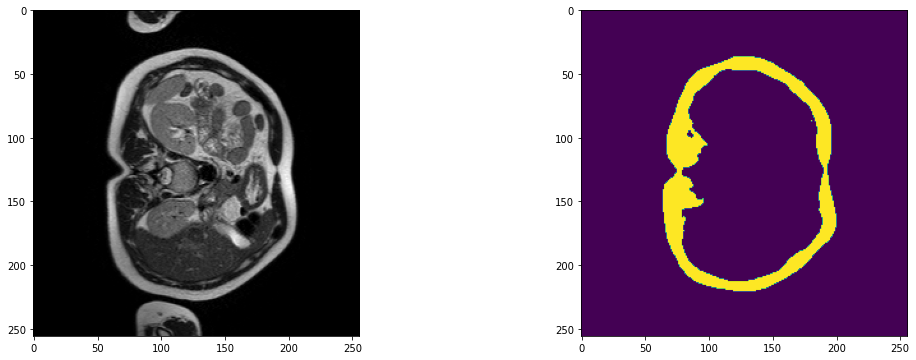

2023-07-17 11:26:33,971 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v6_T2W_seg.nii.gz


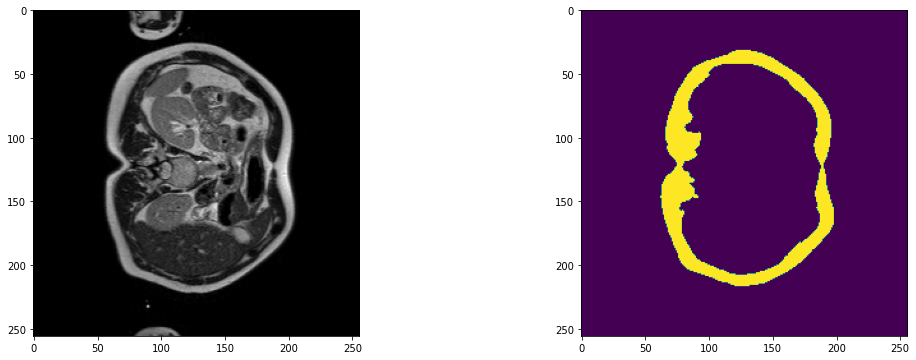

2023-07-17 11:26:36,878 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v7_T2W_seg.nii.gz


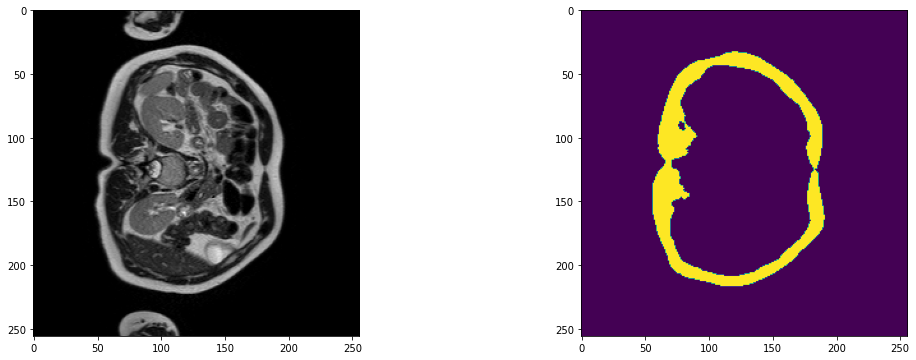

2023-07-17 11:26:39,810 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v8_T2W_seg.nii.gz


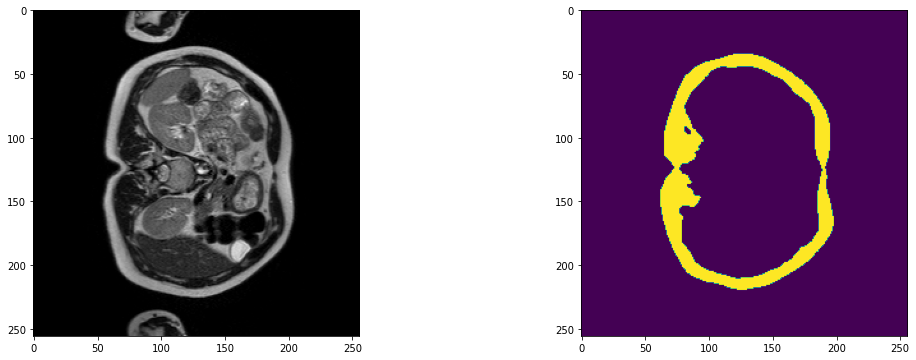

2023-07-17 11:26:42,706 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A011_v9_T2W_seg.nii.gz


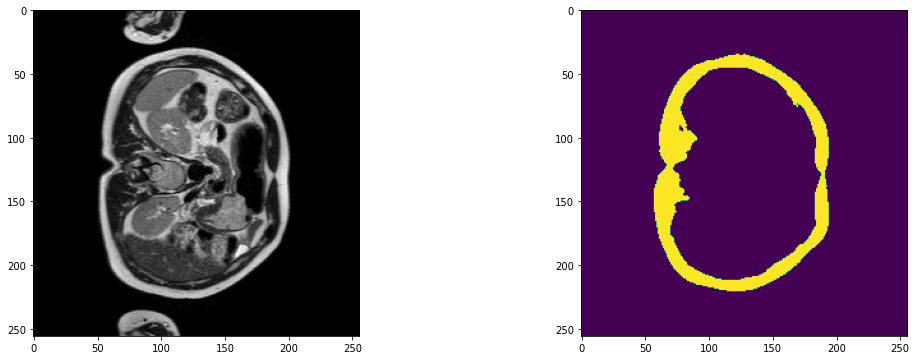

2023-07-17 11:26:45,596 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A013_v1_T2W_seg.nii.gz


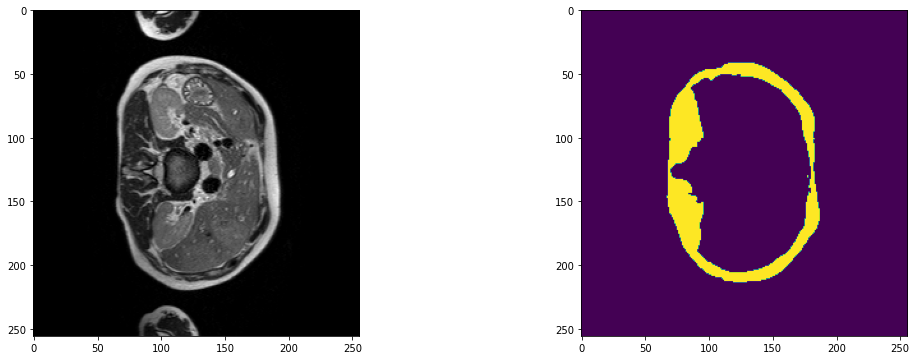

2023-07-17 11:26:48,142 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A013_v2_T2W_seg.nii.gz


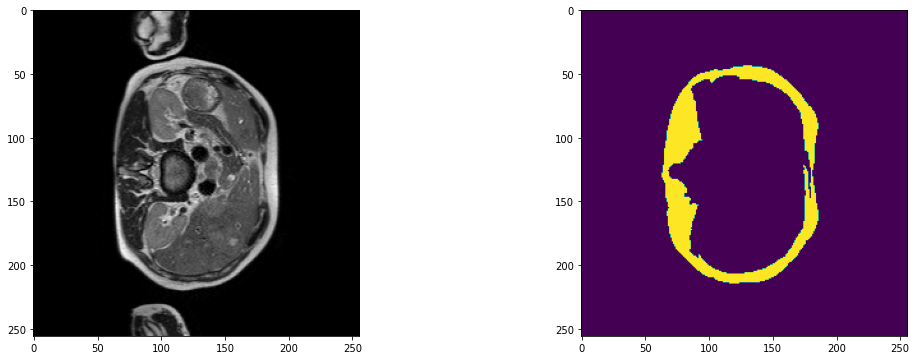

2023-07-17 11:26:50,813 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A013_v3_T2W_seg.nii.gz


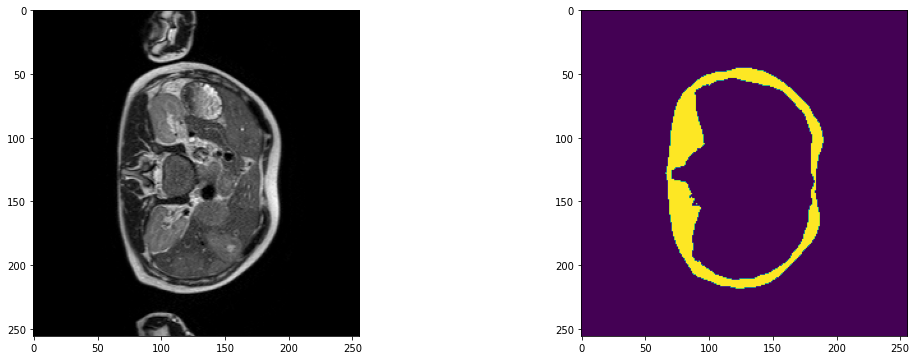

2023-07-17 11:26:53,349 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A013_v4_T2W_seg.nii.gz


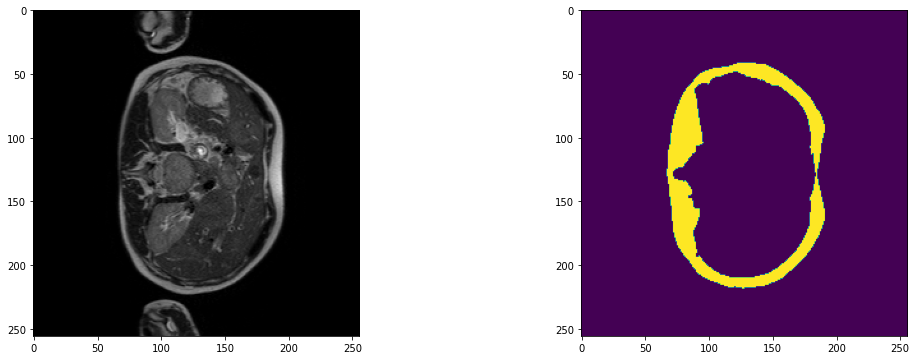

2023-07-17 11:26:55,876 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A013_v5_T2W_seg.nii.gz


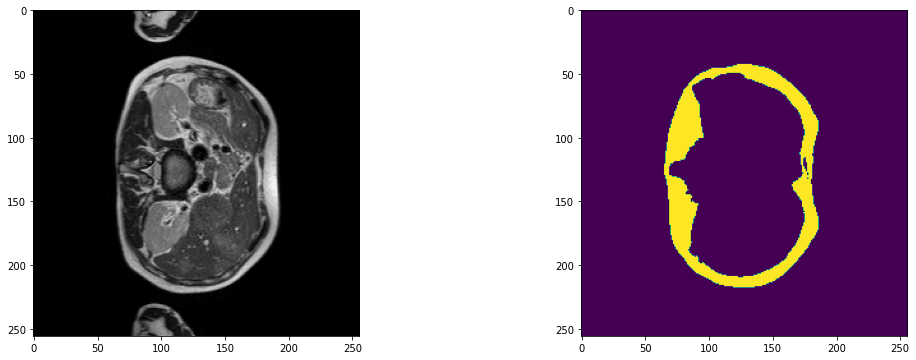

2023-07-17 11:26:58,790 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v1_T2W_seg.nii.gz


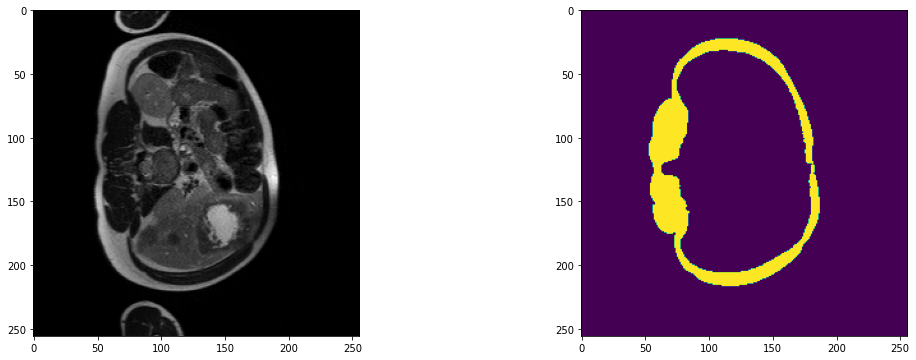

2023-07-17 11:27:01,710 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v2_T2W_seg.nii.gz


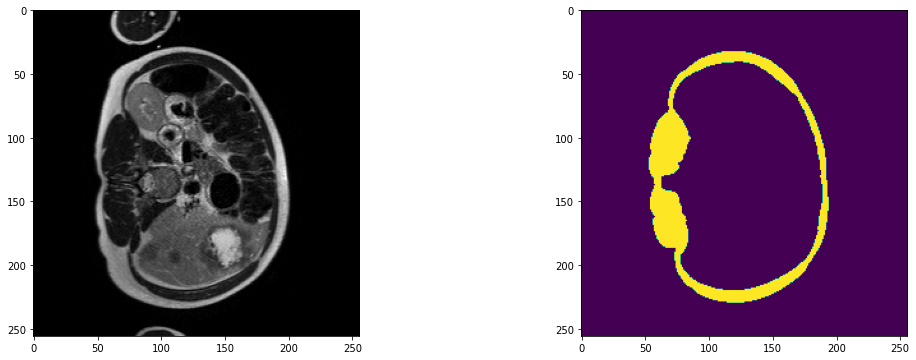

2023-07-17 11:27:04,621 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v3_T2W_seg.nii.gz


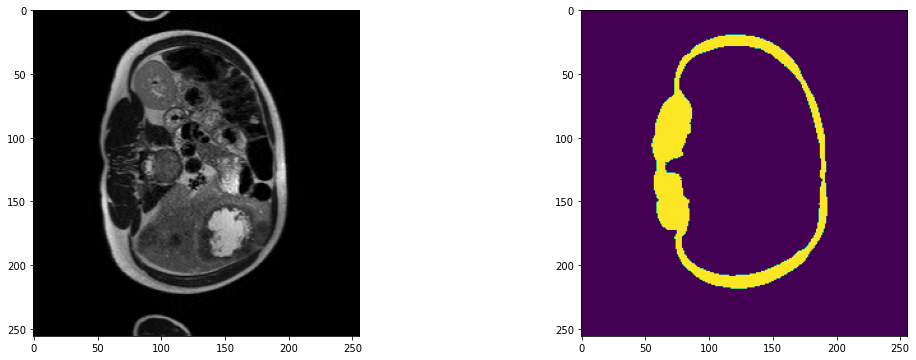

2023-07-17 11:27:07,546 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v4_T2W_seg.nii.gz


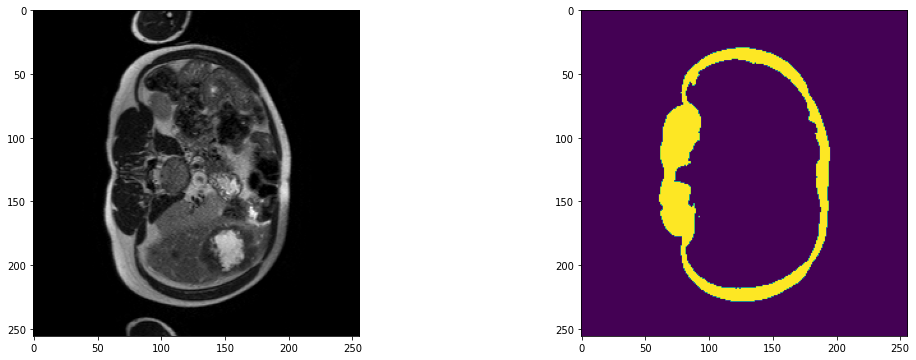

2023-07-17 11:27:10,478 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v5_T2W_seg.nii.gz


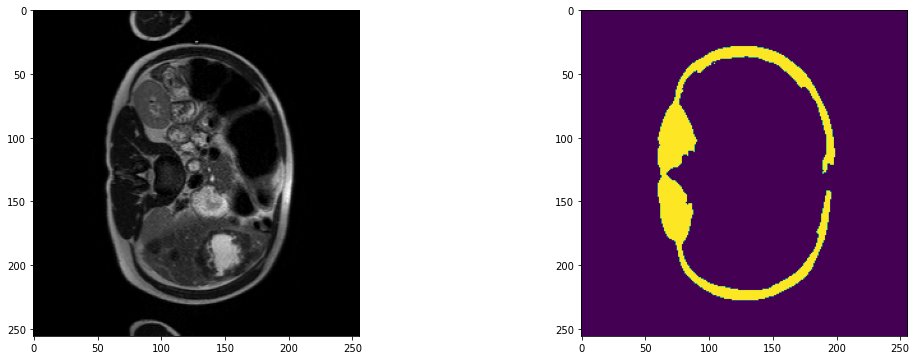

2023-07-17 11:27:13,013 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v6_T2W_seg.nii.gz


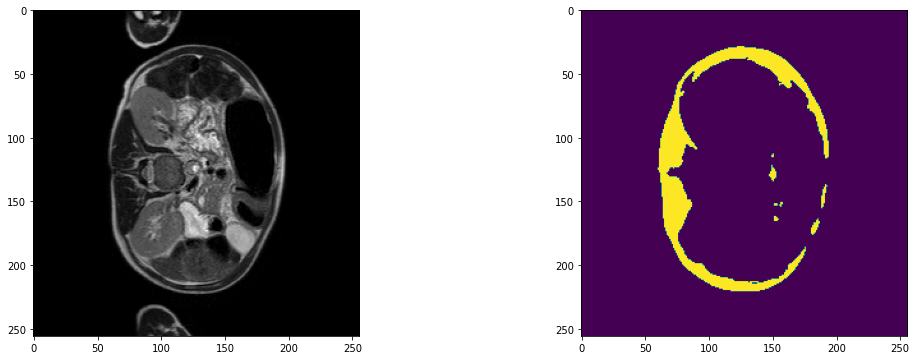

2023-07-17 11:27:15,937 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A014_v7_T2W_seg.nii.gz


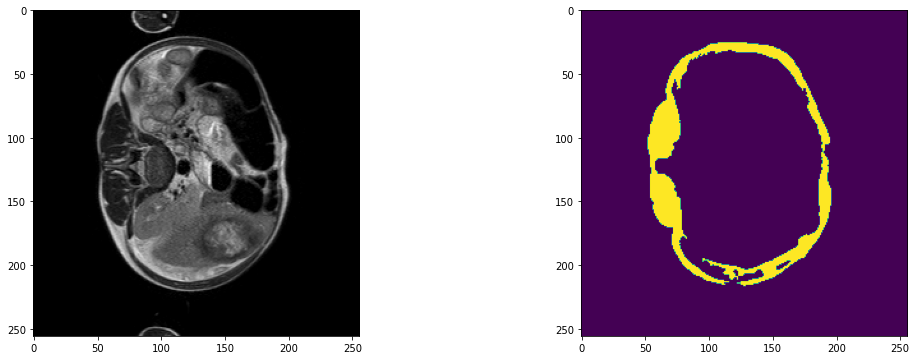

2023-07-17 11:27:18,846 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v1_T2W_seg.nii.gz


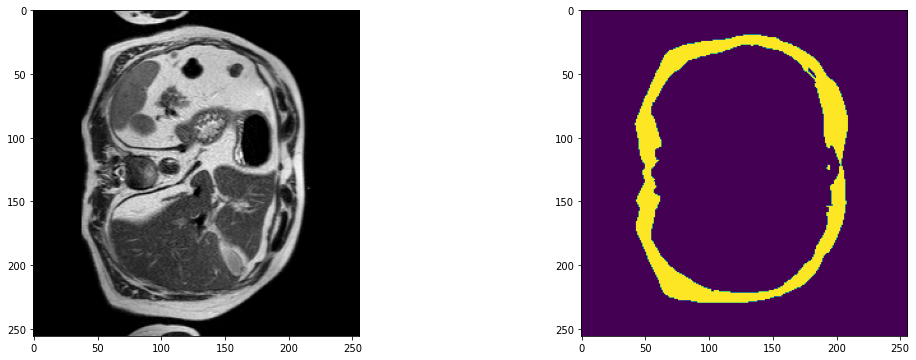

2023-07-17 11:27:21,769 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v2_T2W_seg.nii.gz


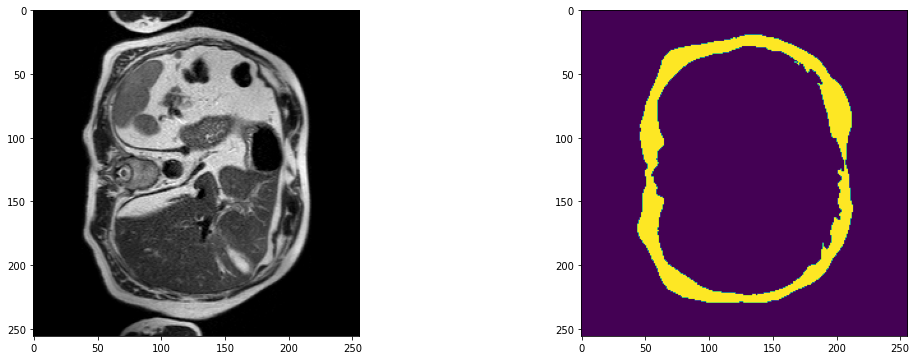

2023-07-17 11:27:24,686 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v3_T2W_seg.nii.gz


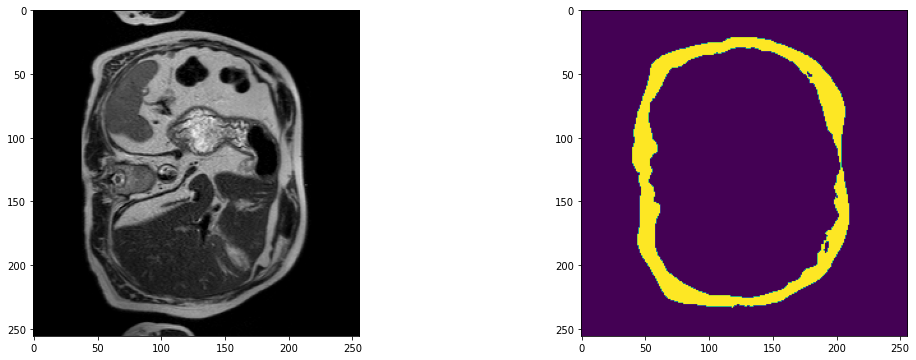

2023-07-17 11:27:27,747 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v4_T2W_seg.nii.gz


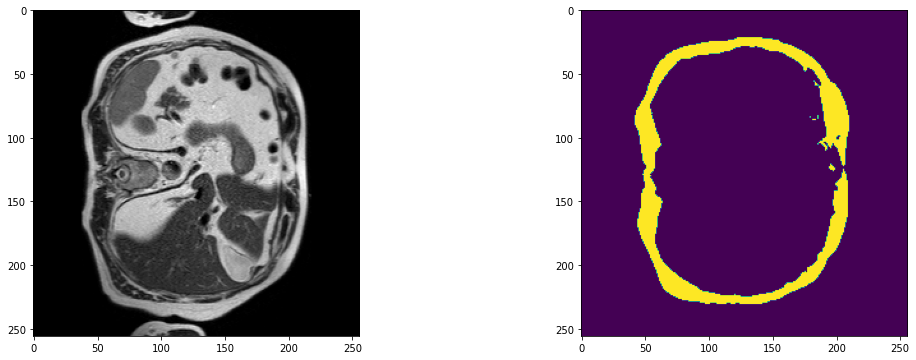

2023-07-17 11:27:30,666 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v5_T2W_seg.nii.gz


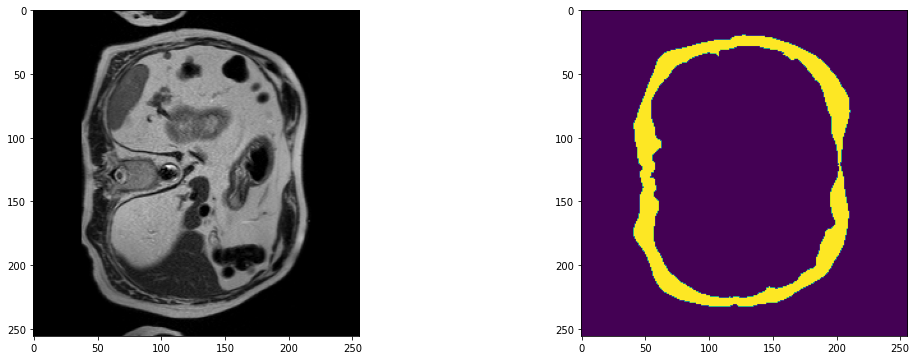

2023-07-17 11:27:33,574 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v6_T2W_seg.nii.gz


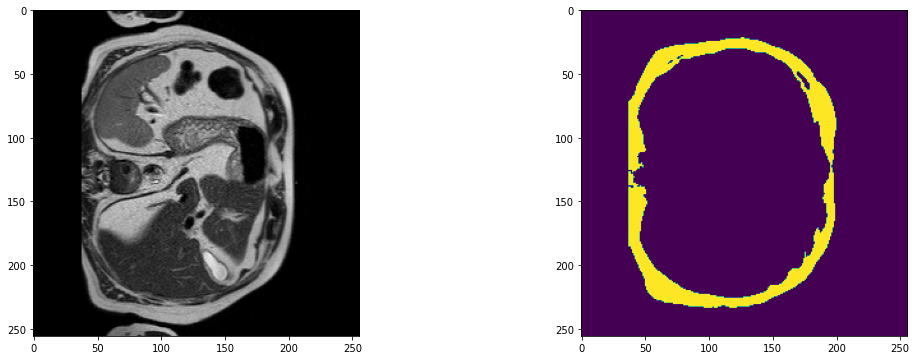

2023-07-17 11:27:36,502 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v7_T2W_seg.nii.gz


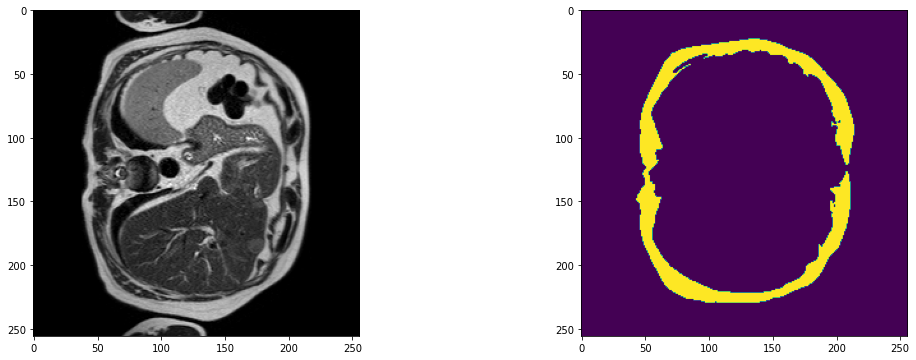

2023-07-17 11:27:39,424 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A015_v8_T2W_seg.nii.gz


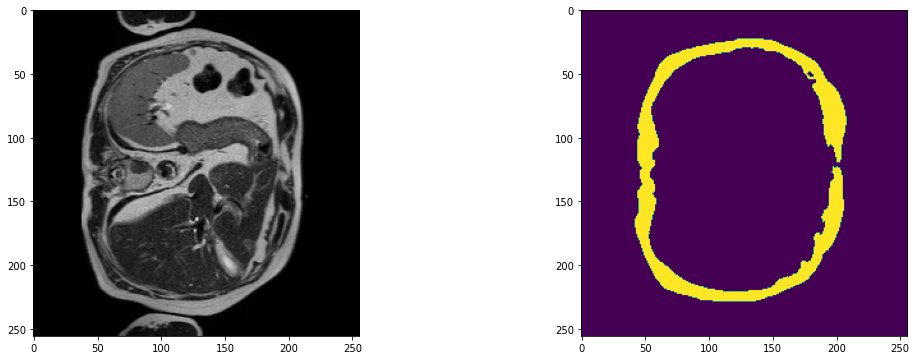

2023-07-17 11:27:42,359 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v1_T2W_seg.nii.gz


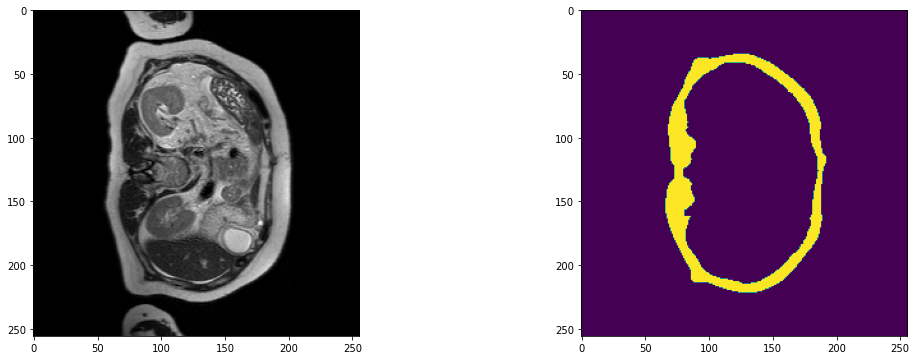

2023-07-17 11:27:45,276 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v2_T2W_seg.nii.gz


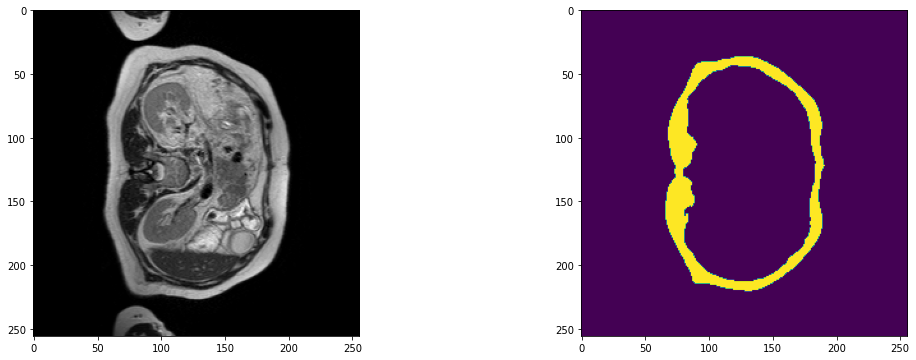

2023-07-17 11:27:48,207 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v3_T2W_seg.nii.gz


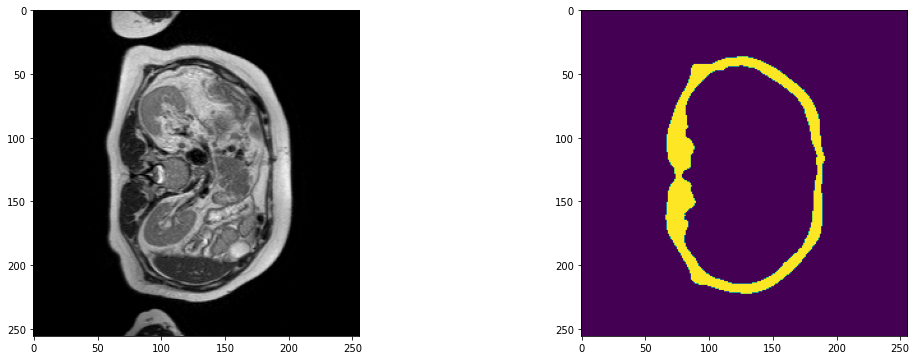

2023-07-17 11:27:51,120 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v4_T2W_seg.nii.gz


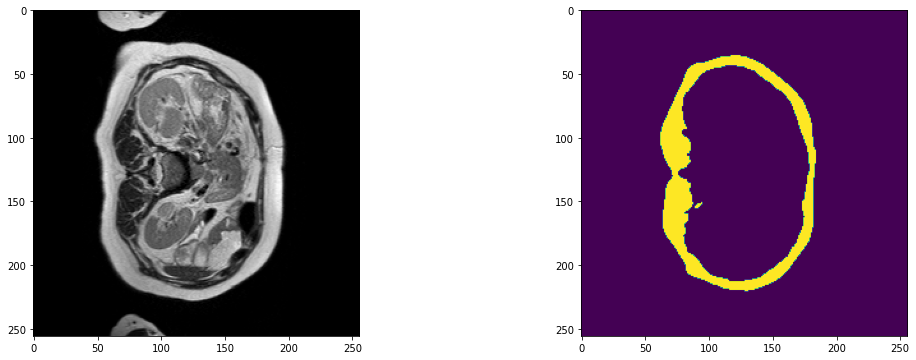

2023-07-17 11:27:54,051 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v5_T2W_seg.nii.gz


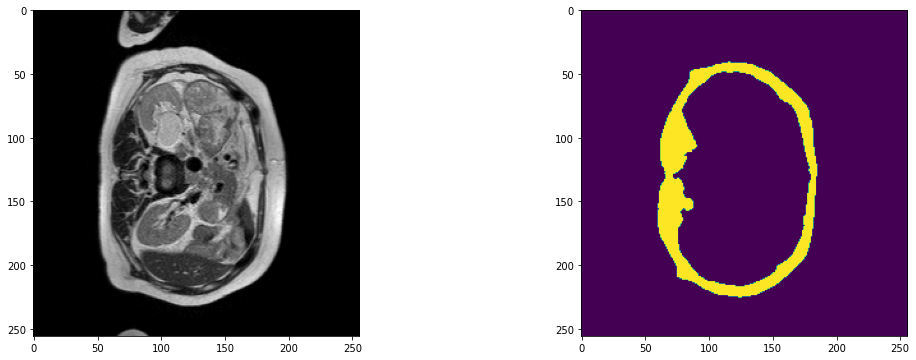

2023-07-17 11:27:56,968 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v6_T2W_seg.nii.gz


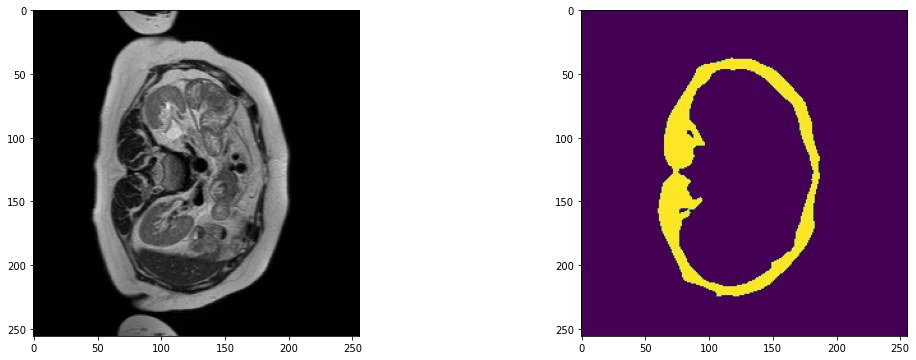

2023-07-17 11:27:59,914 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A016_v7_T2W_seg.nii.gz


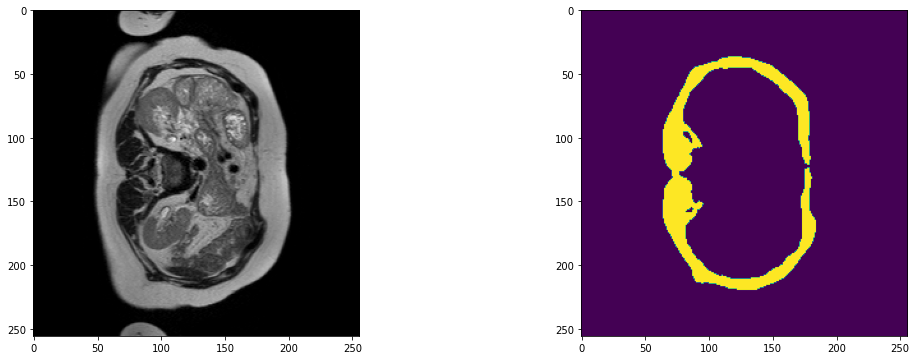

2023-07-17 11:28:02,831 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v1_T2W_seg.nii.gz


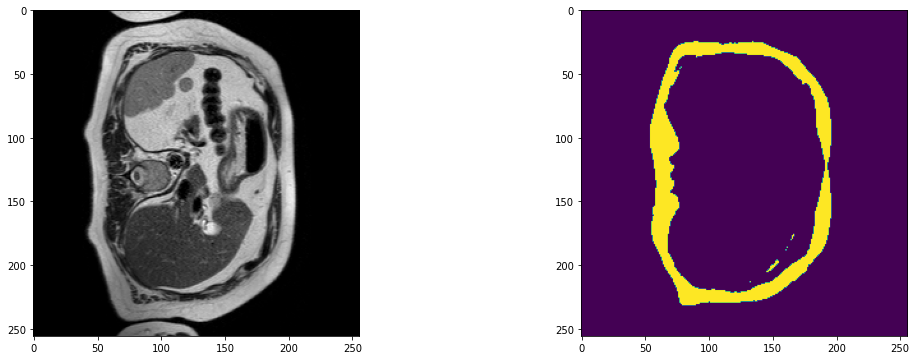

2023-07-17 11:28:05,923 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v2_T2W_seg.nii.gz


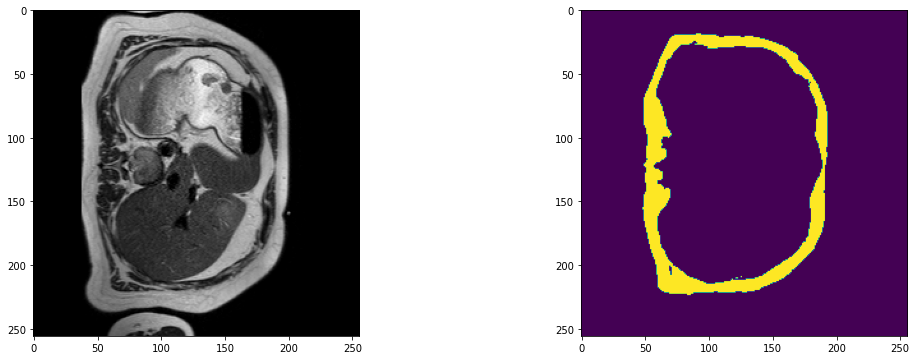

2023-07-17 11:28:08,854 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v3_T2W_seg.nii.gz


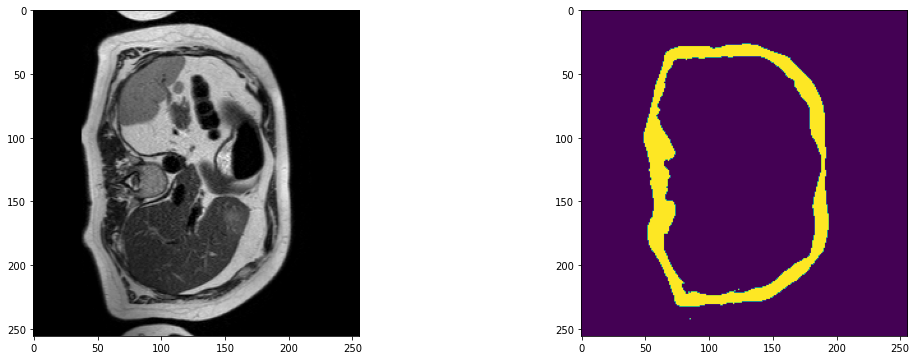

2023-07-17 11:28:11,776 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v4_T2W_seg.nii.gz


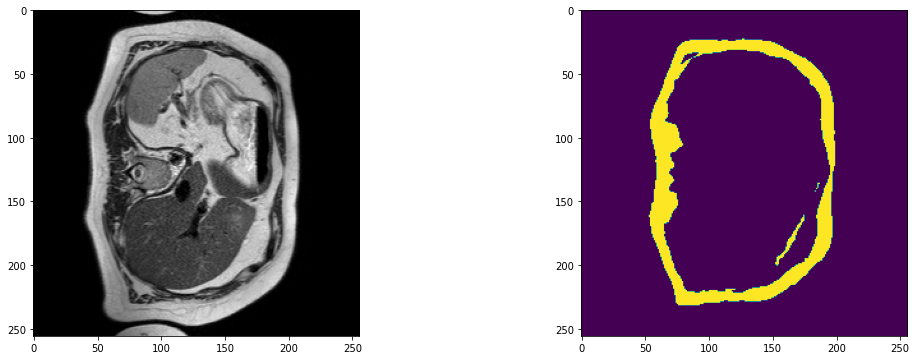

2023-07-17 11:28:14,695 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v5_T2W_seg.nii.gz


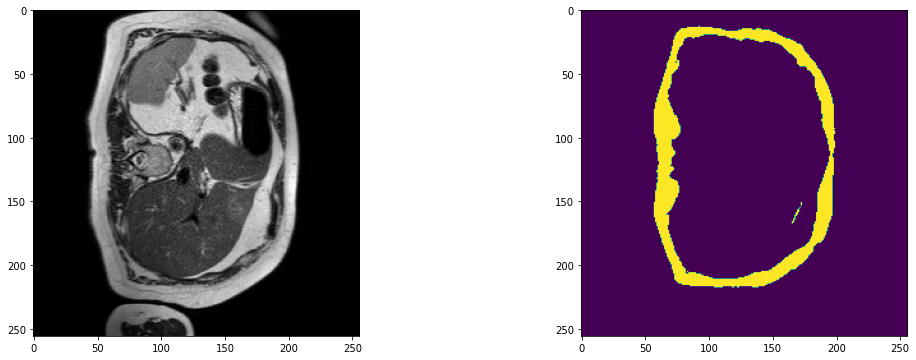

2023-07-17 11:28:17,627 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v6_T2W_seg.nii.gz


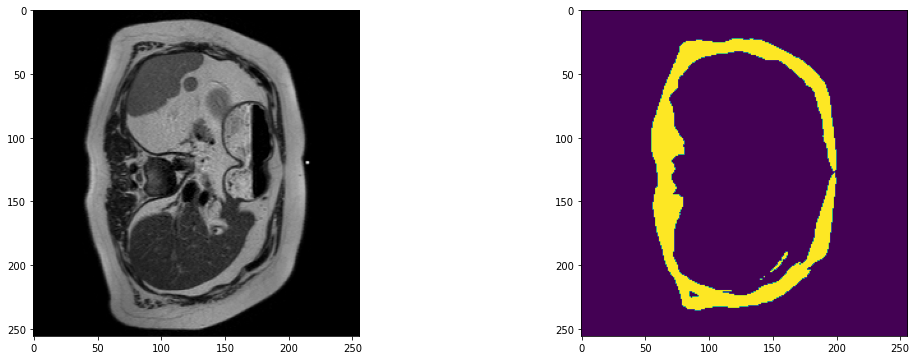

2023-07-17 11:28:20,552 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A017_v7_T2W_seg.nii.gz


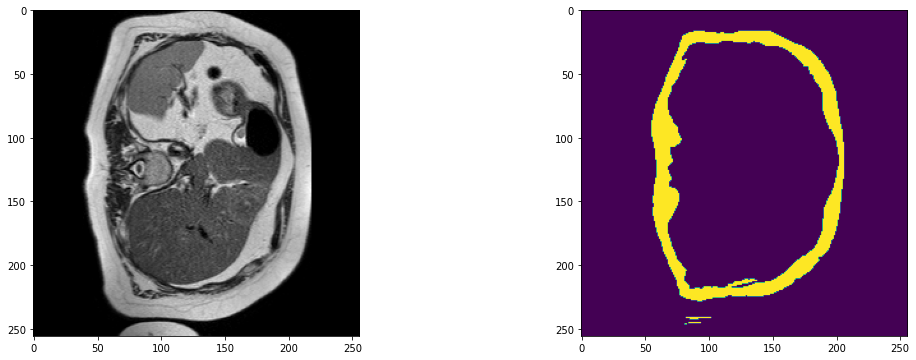

2023-07-17 11:28:23,477 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v1_T2W_seg.nii.gz


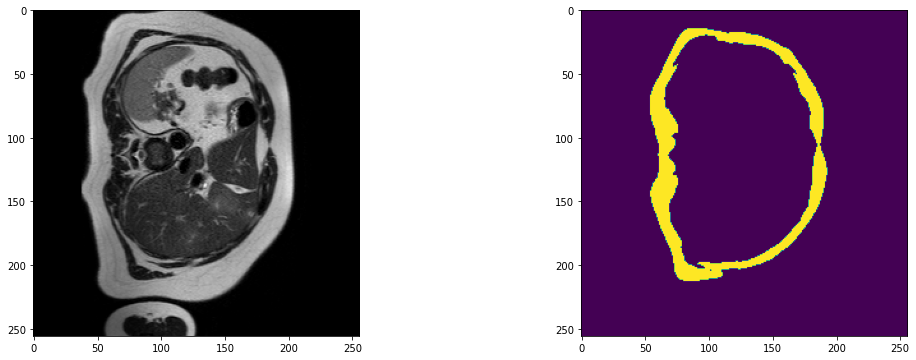

2023-07-17 11:28:26,400 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v2_T2W_seg.nii.gz


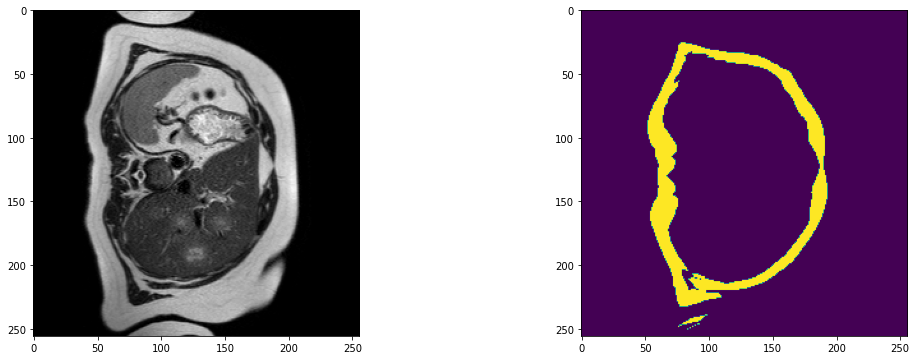

2023-07-17 11:28:29,320 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v3_T2W_seg.nii.gz


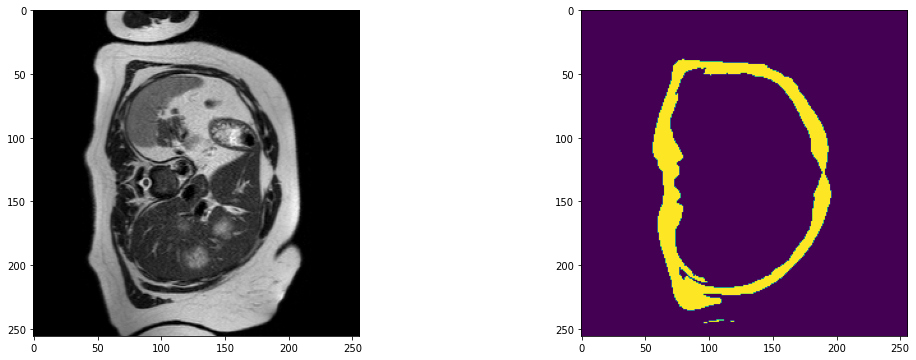

2023-07-17 11:28:32,260 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v4_T2W_seg.nii.gz


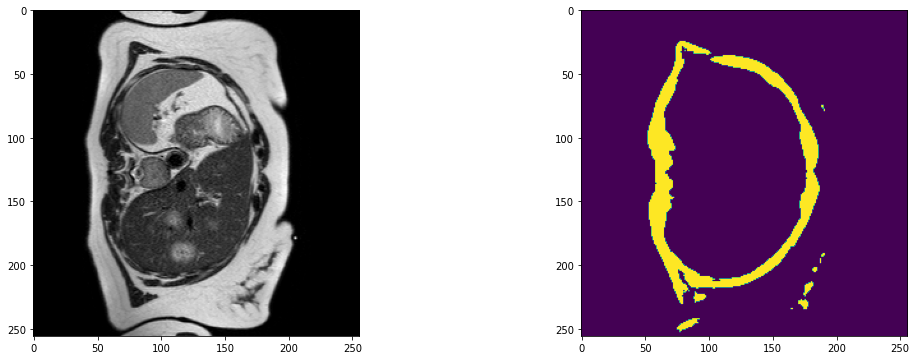

2023-07-17 11:28:35,199 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v5_T2W_seg.nii.gz


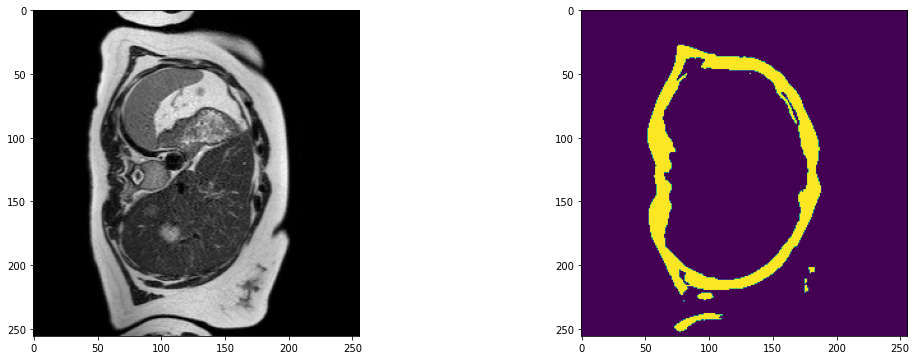

2023-07-17 11:28:38,145 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v6_T2W_seg.nii.gz


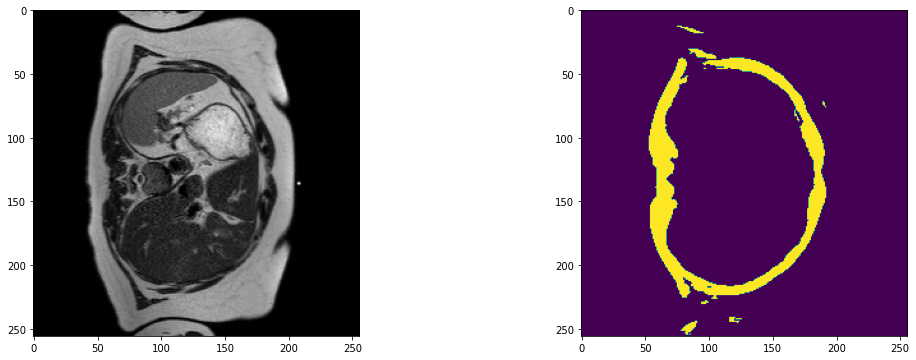

Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]


2023-07-17 11:28:41,088 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A018_v7_T2W_seg.nii.gz


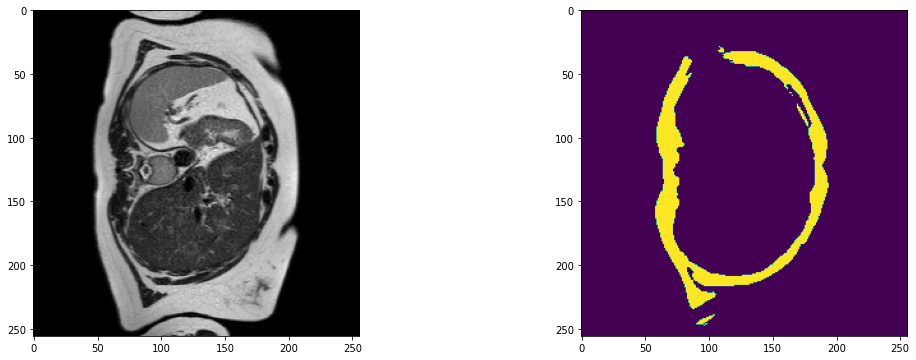

Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]


2023-07-17 11:28:44,171 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v1_T2W_seg.nii.gz


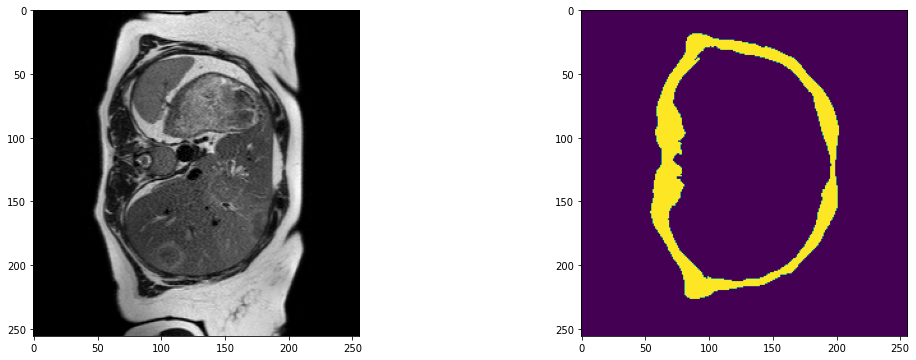

Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]


2023-07-17 11:28:47,131 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v2_T2W_seg.nii.gz


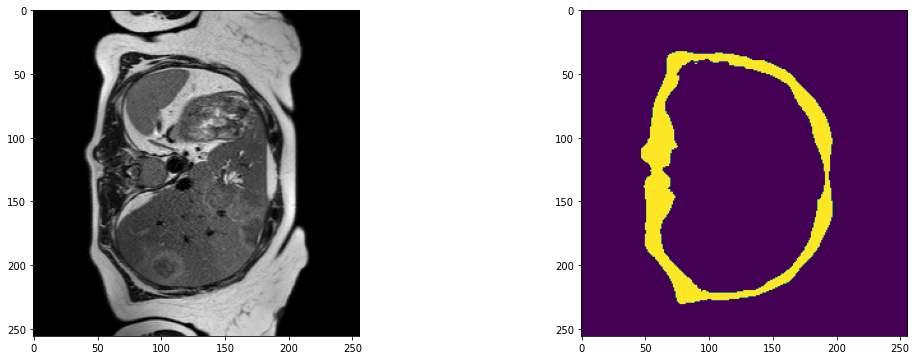

Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]


2023-07-17 11:28:50,092 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v3_T2W_seg.nii.gz


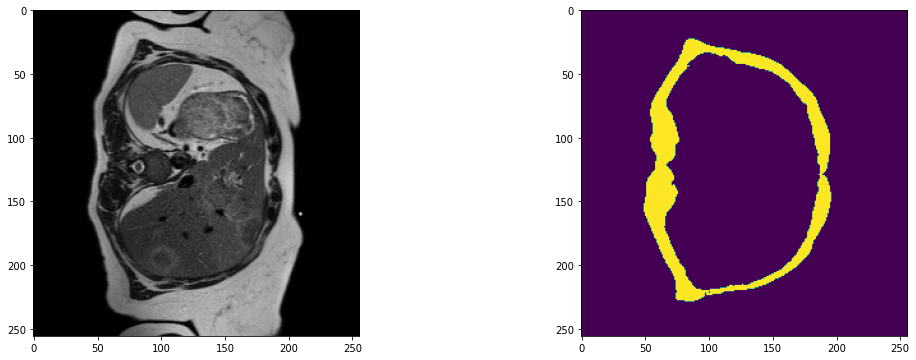

2023-07-17 11:28:53,022 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v4_T2W_seg.nii.gz


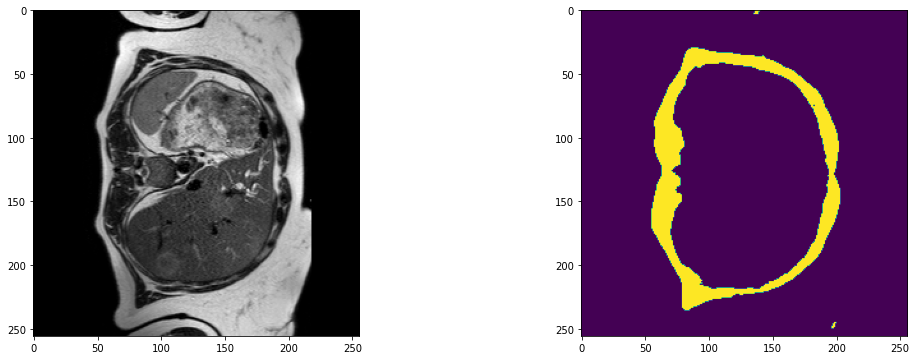

2023-07-17 11:28:55,948 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v5_T2W_seg.nii.gz


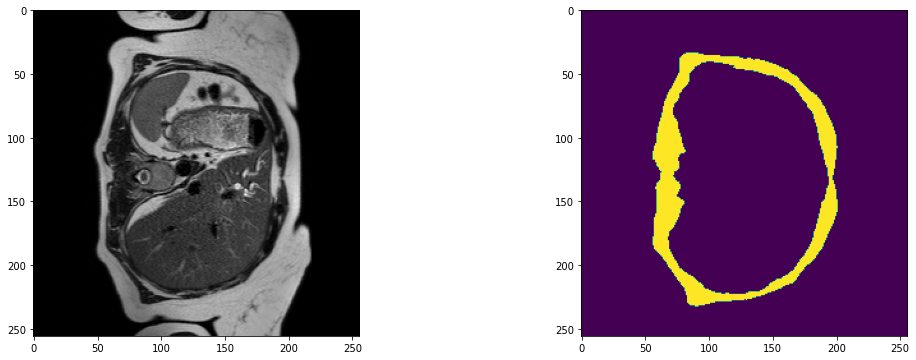

2023-07-17 11:28:58,888 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v6_T2W_seg.nii.gz


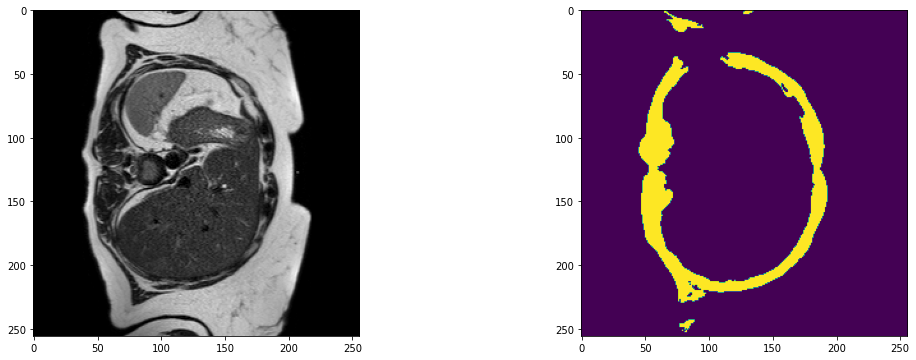

2023-07-17 11:29:01,831 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A021_v7_T2W_seg.nii.gz


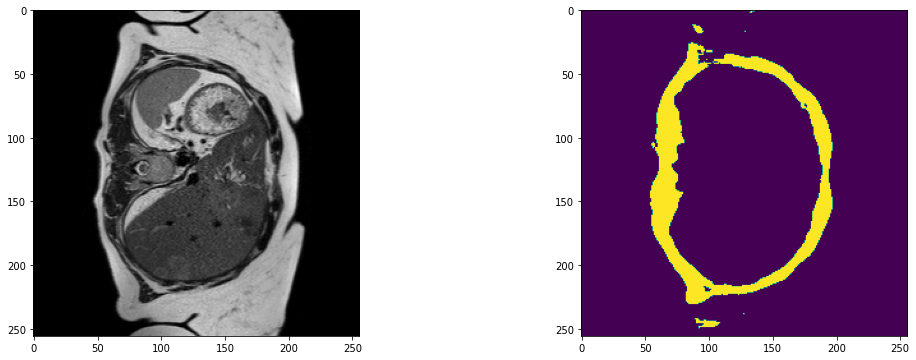

2023-07-17 11:29:10,440 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v1_T2W_seg.nii.gz


Modifying image pixdim from [1.4648438 1.4648438 8.        0.       ] to [  1.46484375   1.46484375   8.         281.03604124]


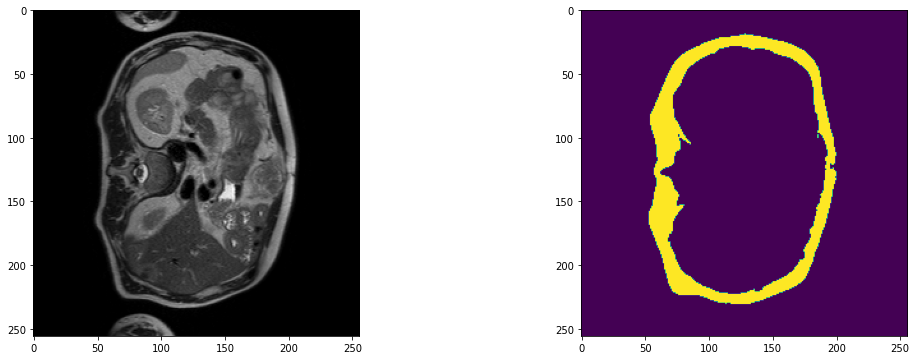

2023-07-17 11:29:19,067 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v2_T2W_seg.nii.gz


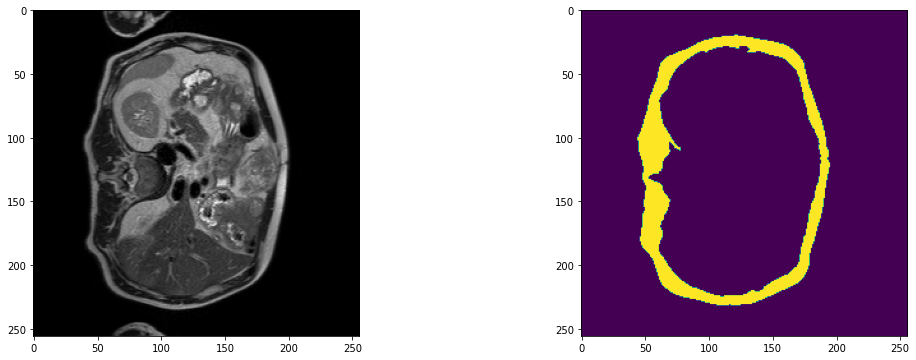

2023-07-17 11:29:27,708 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v3_T2W_seg.nii.gz


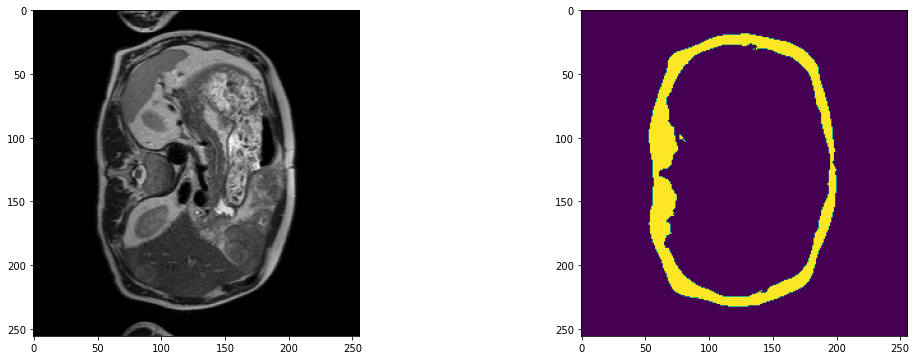

2023-07-17 11:29:36,363 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v4_T2W_seg.nii.gz


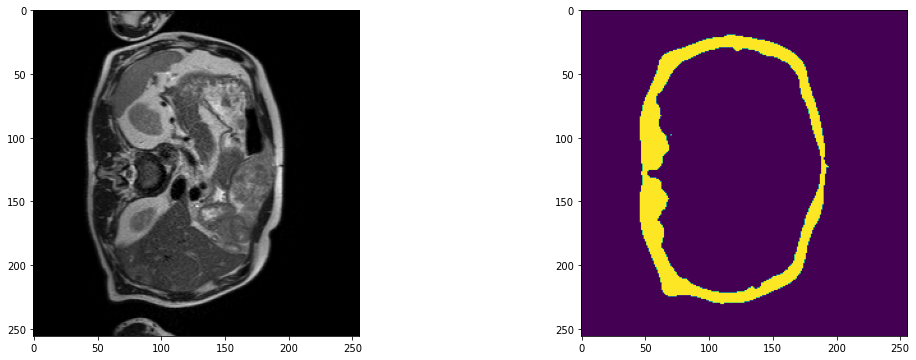

2023-07-17 11:29:44,995 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v5_T2W_seg.nii.gz


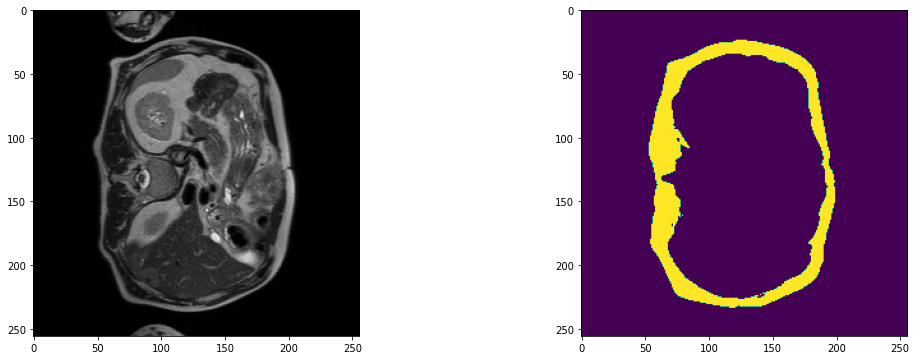

2023-07-17 11:29:53,635 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v6_T2W_seg.nii.gz


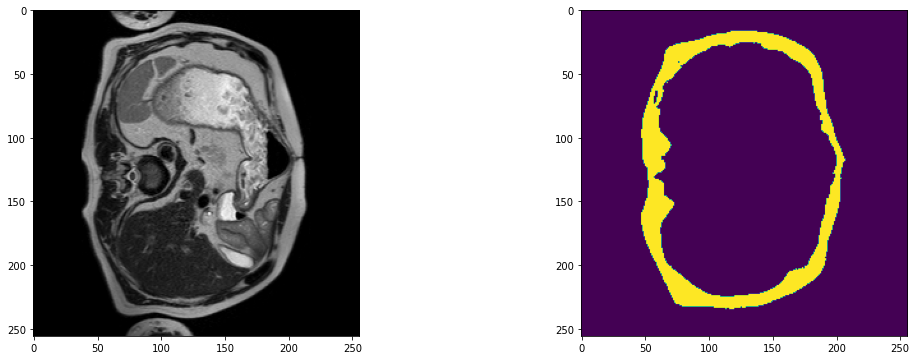

2023-07-17 11:30:02,431 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v7_T2W_seg.nii.gz


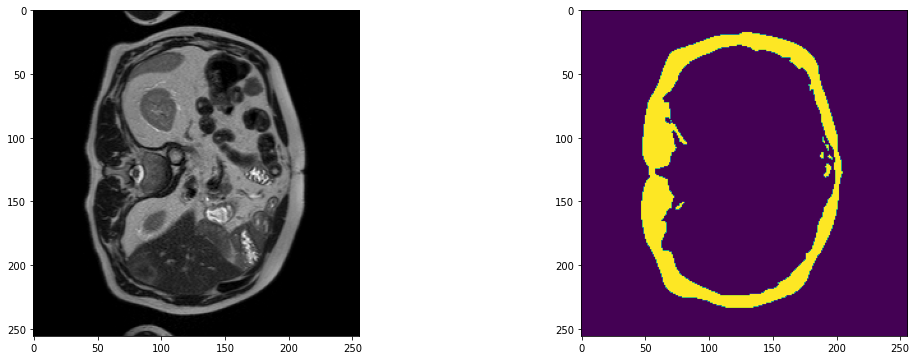

2023-07-17 11:30:11,080 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v8_T2W_seg.nii.gz


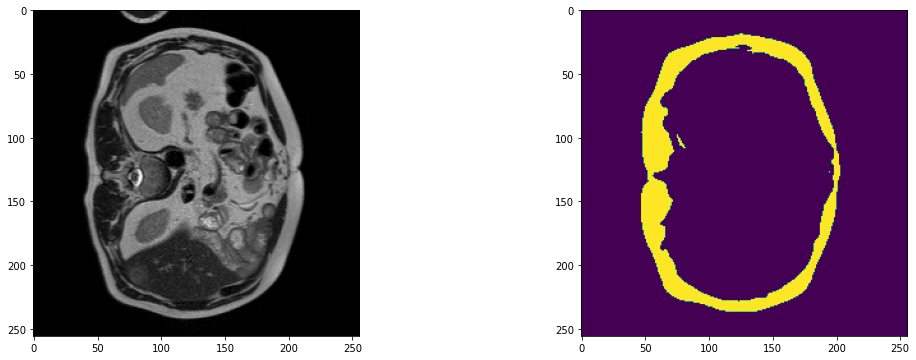

2023-07-17 11:30:19,756 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A022_v9_T2W_seg.nii.gz


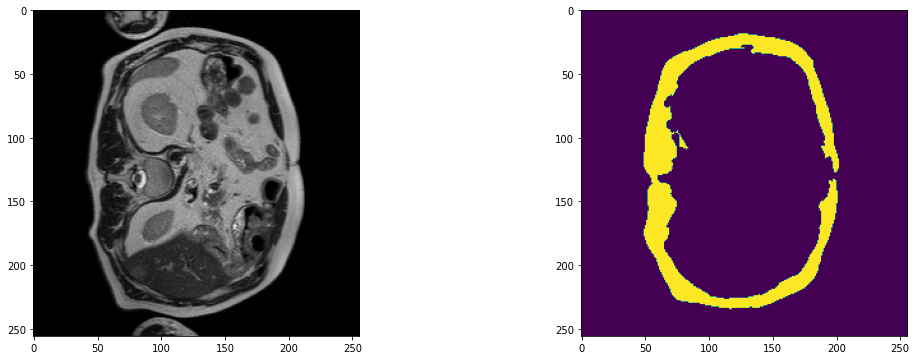

2023-07-17 11:30:22,702 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v1_T2W_seg.nii.gz


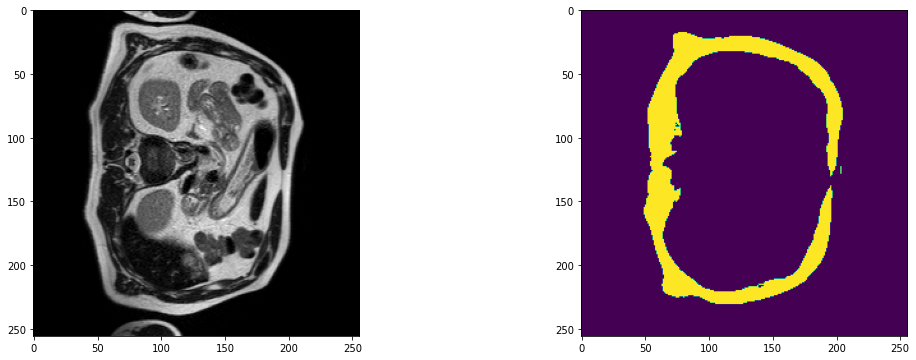

2023-07-17 11:30:25,656 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v2_T2W_seg.nii.gz


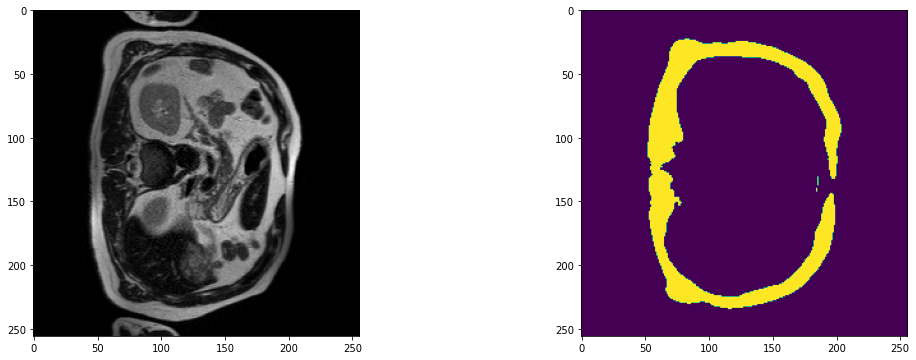

2023-07-17 11:30:28,589 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v3_T2W_seg.nii.gz


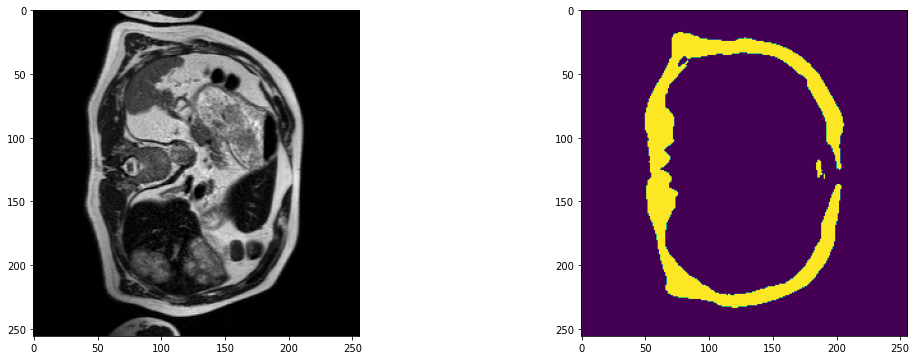

2023-07-17 11:30:31,525 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v4_T2W_seg.nii.gz


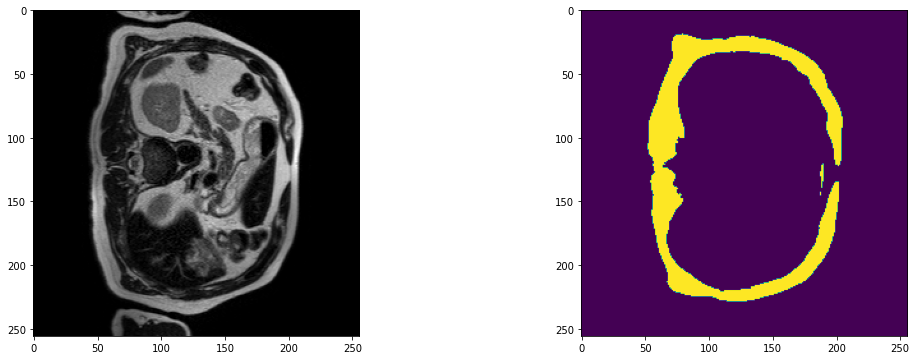

2023-07-17 11:30:34,454 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v5_T2W_seg.nii.gz


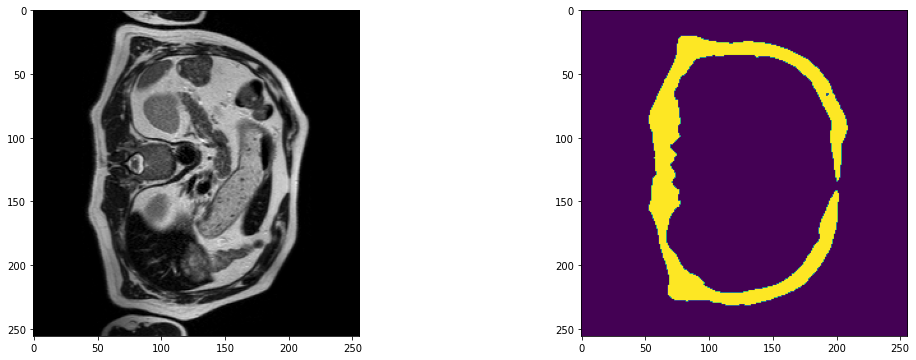

2023-07-17 11:30:37,423 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v6_T2W_seg.nii.gz


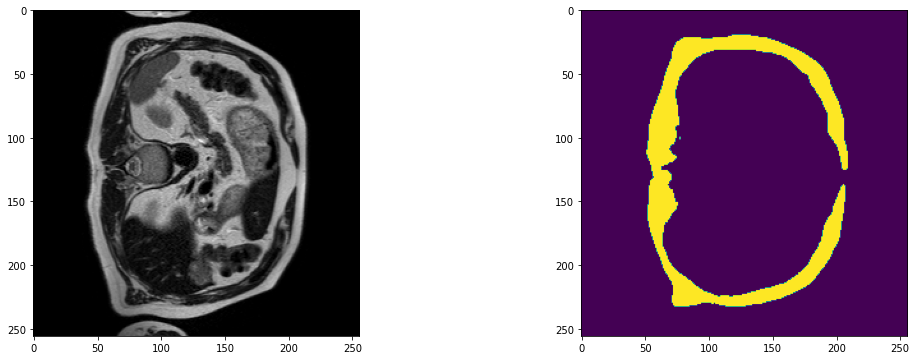

2023-07-17 11:30:40,399 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v7_T2W_seg.nii.gz


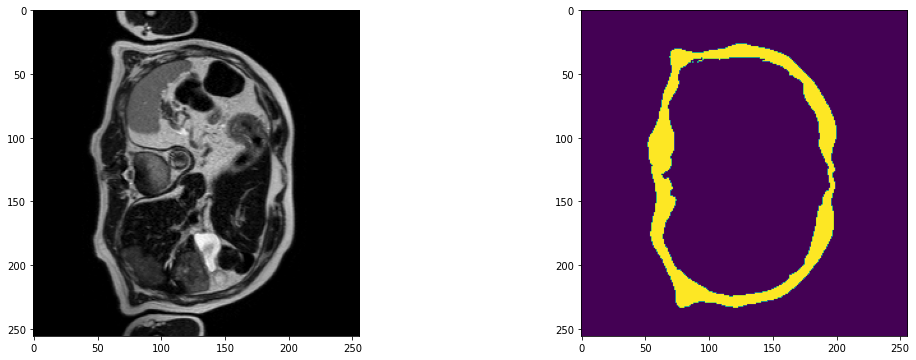

2023-07-17 11:30:43,354 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v8_T2W_seg.nii.gz


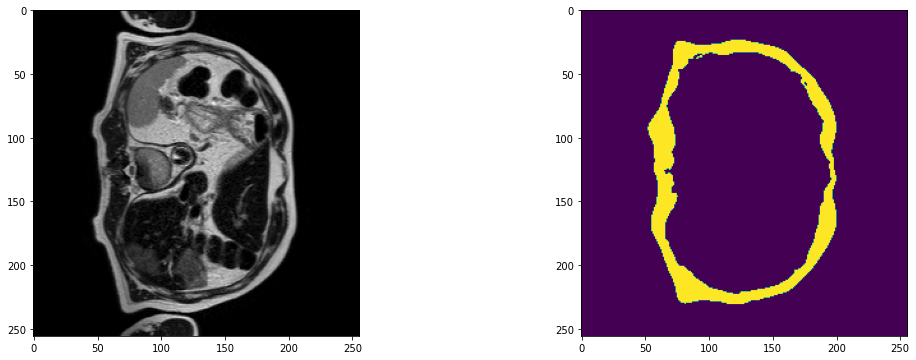

2023-07-17 11:30:46,292 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A024_v9_T2W_seg.nii.gz


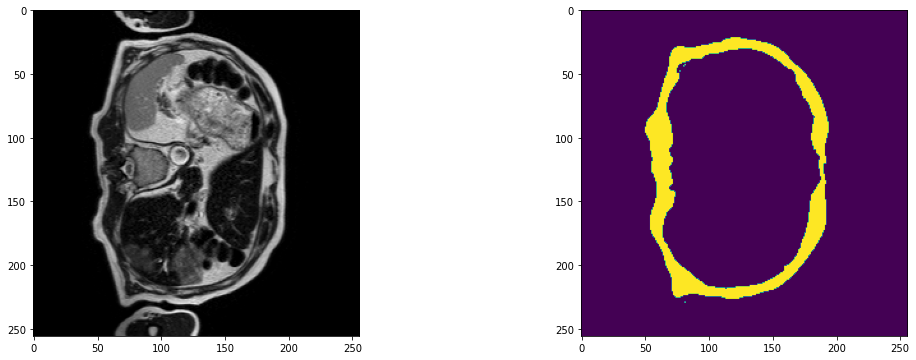

2023-07-17 11:30:54,906 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A026_v1_T2W_seg.nii.gz


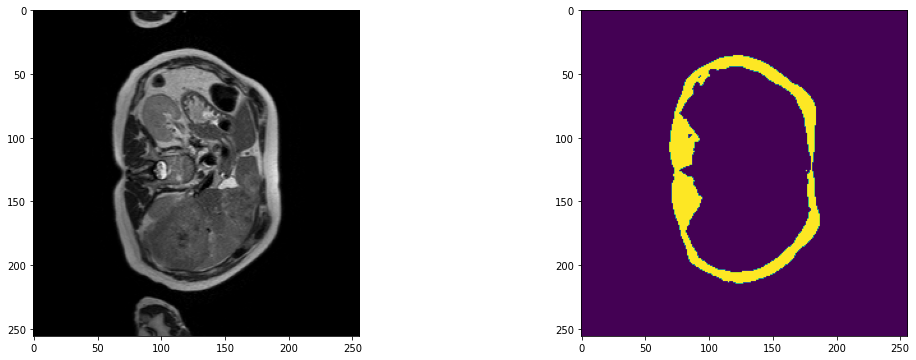

2023-07-17 11:31:03,691 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A026_v2_T2W_seg.nii.gz


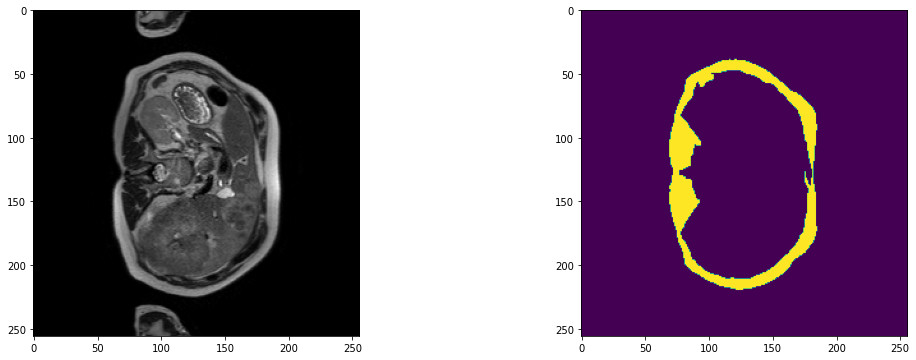

2023-07-17 11:31:12,318 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A026_v3_T2W_seg.nii.gz


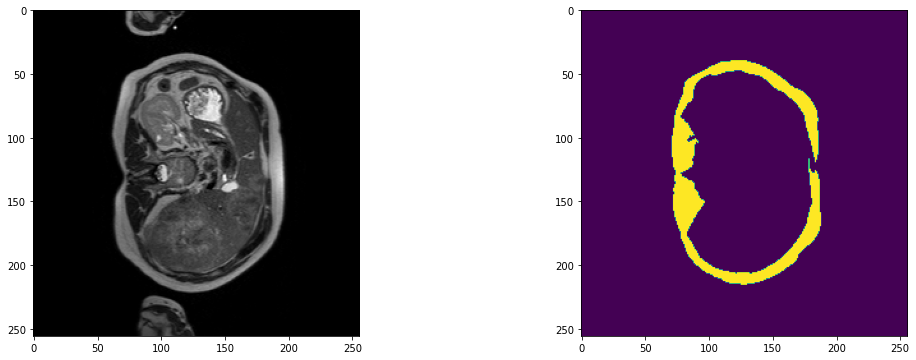

2023-07-17 11:31:20,954 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A026_v4_T2W_seg.nii.gz


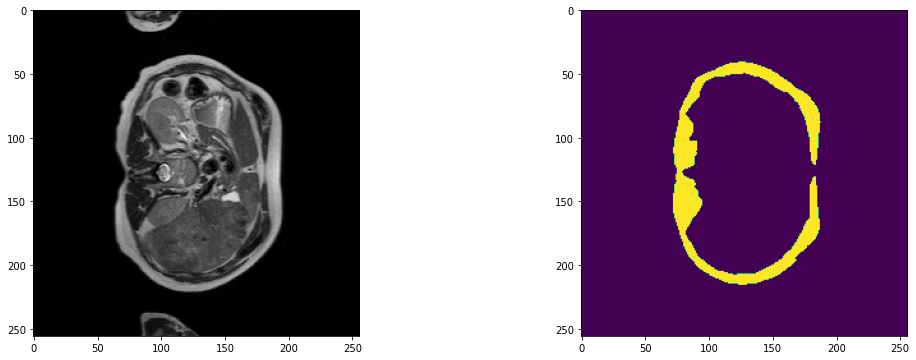

2023-07-17 11:31:29,584 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A026_v5_T2W_seg.nii.gz


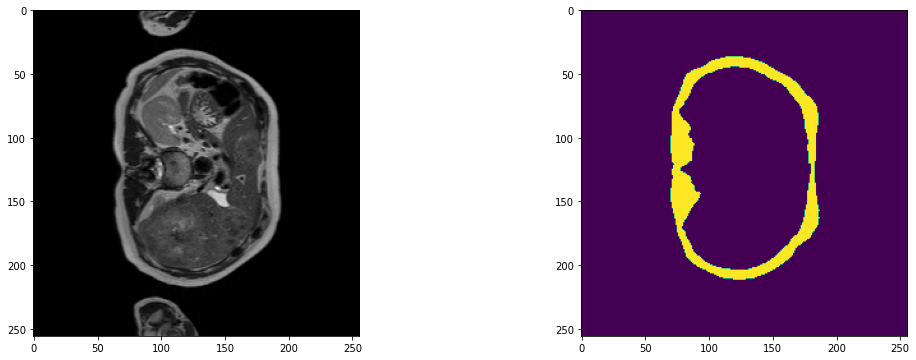

2023-07-17 11:31:32,522 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A029_v1_T2W_seg.nii.gz


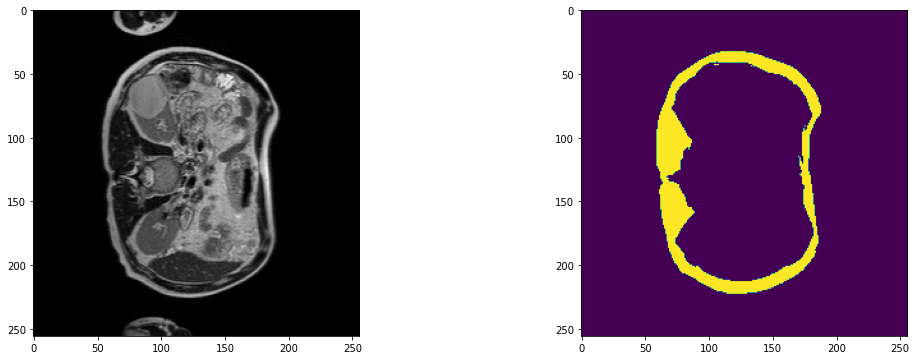

2023-07-17 11:31:35,108 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A029_v2_T2W_seg.nii.gz


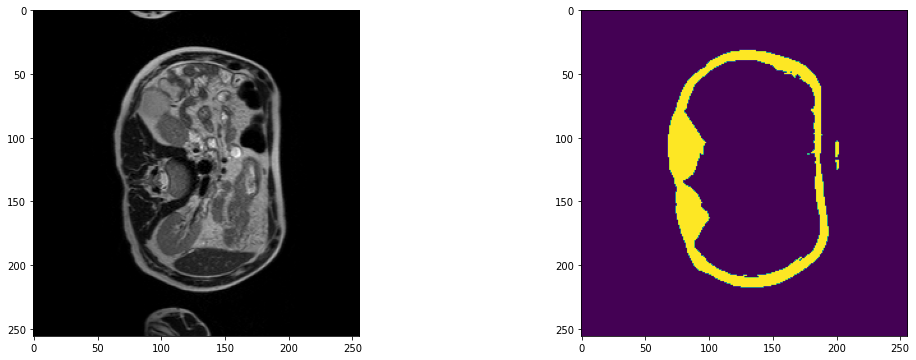

2023-07-17 11:31:38,022 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A029_v3_T2W_seg.nii.gz


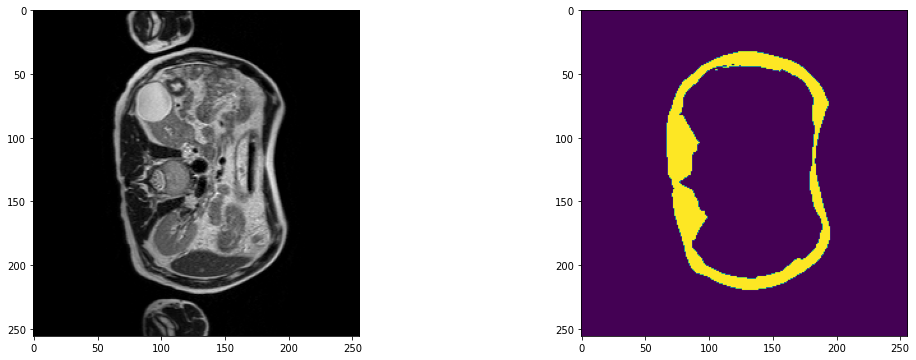

2023-07-17 11:31:40,579 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A029_v4_T2W_seg.nii.gz


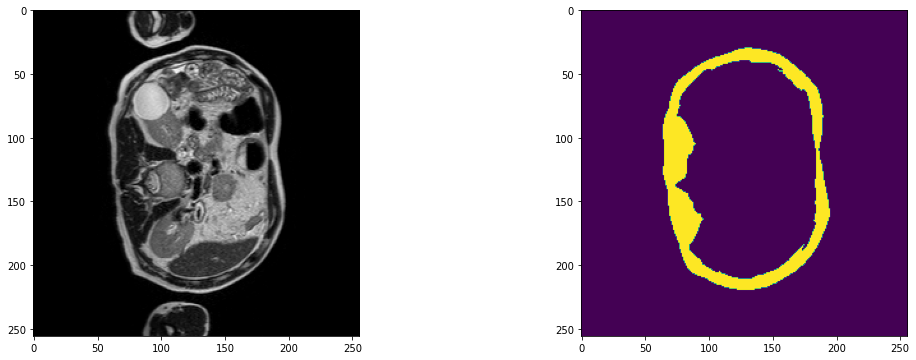

2023-07-17 11:31:43,126 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A029_v5_T2W_seg.nii.gz


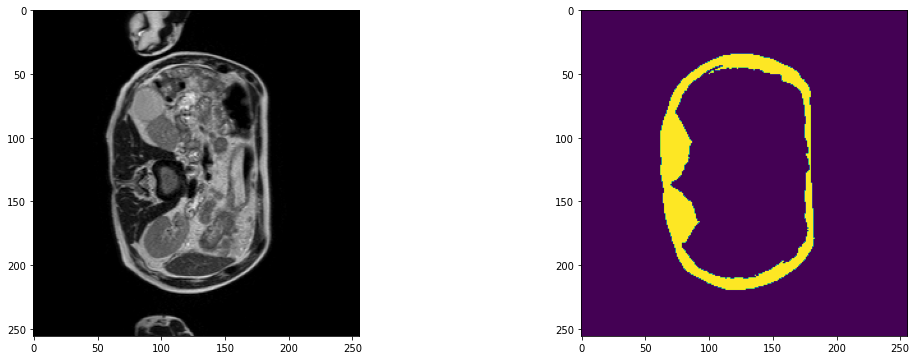

2023-07-17 11:31:46,054 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v1_T2W_seg.nii.gz


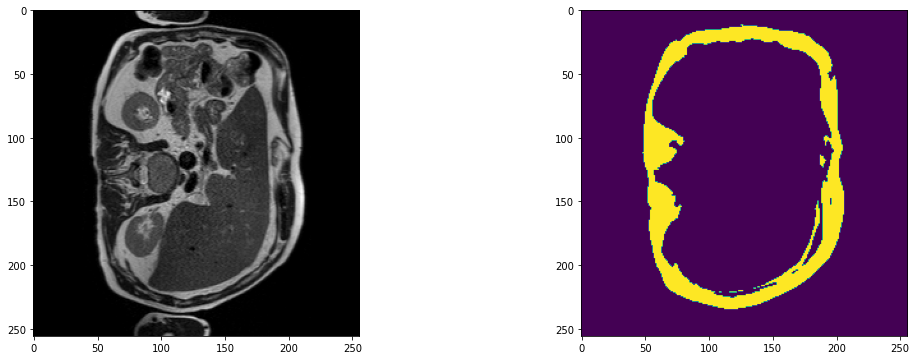

2023-07-17 11:31:48,983 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v2_T2W_seg.nii.gz


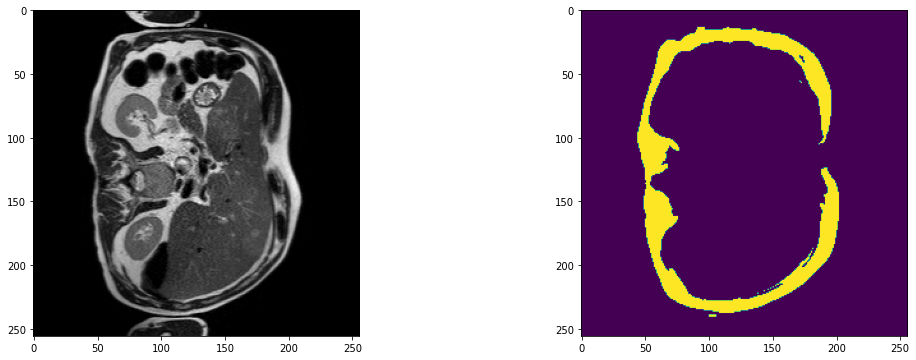

2023-07-17 11:31:51,926 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v3_T2W_seg.nii.gz


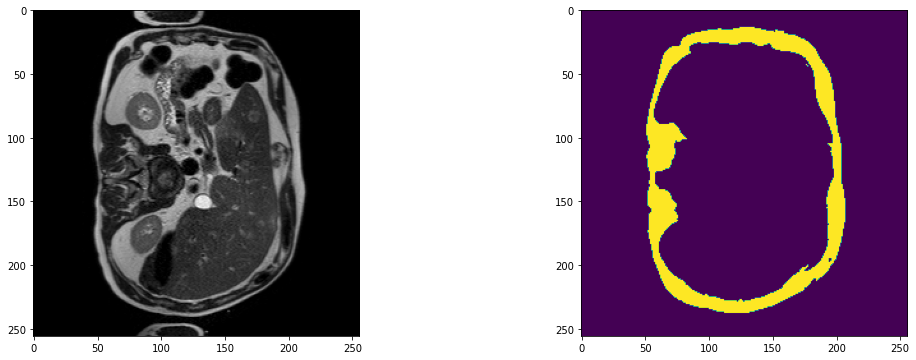

2023-07-17 11:31:54,861 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v4_T2W_seg.nii.gz


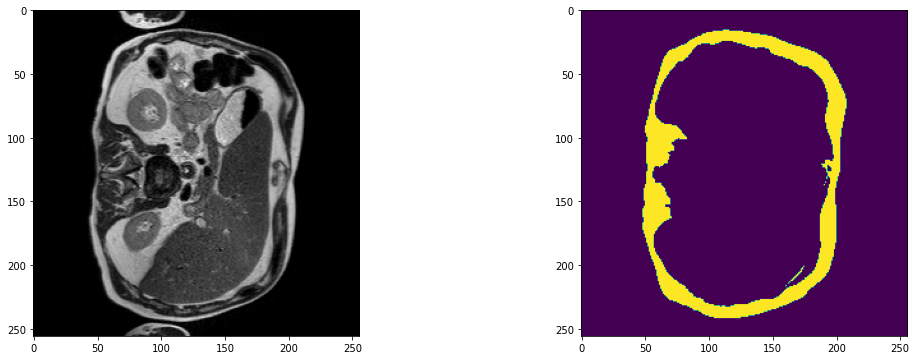

2023-07-17 11:31:57,947 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v5_T2W_seg.nii.gz


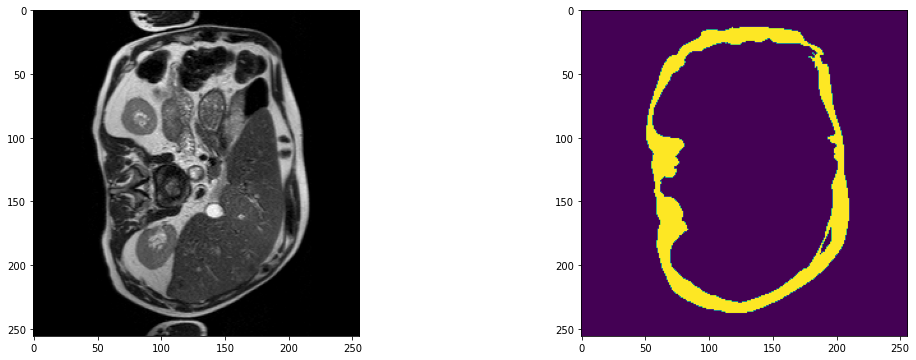

2023-07-17 11:32:00,908 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v6_T2W_seg.nii.gz


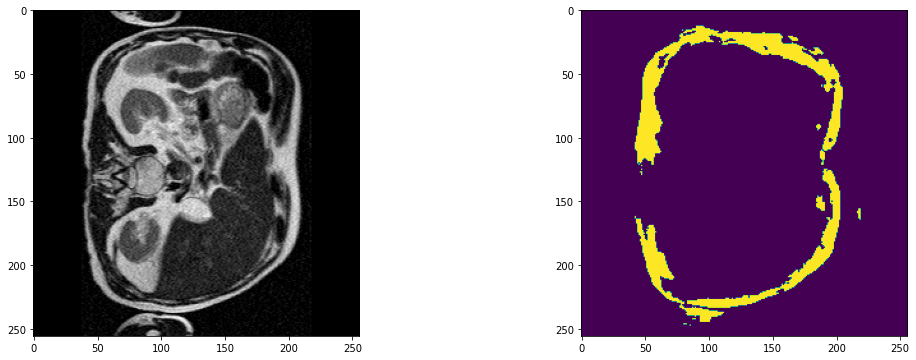

2023-07-17 11:32:03,852 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A030_v7_T2W_seg.nii.gz


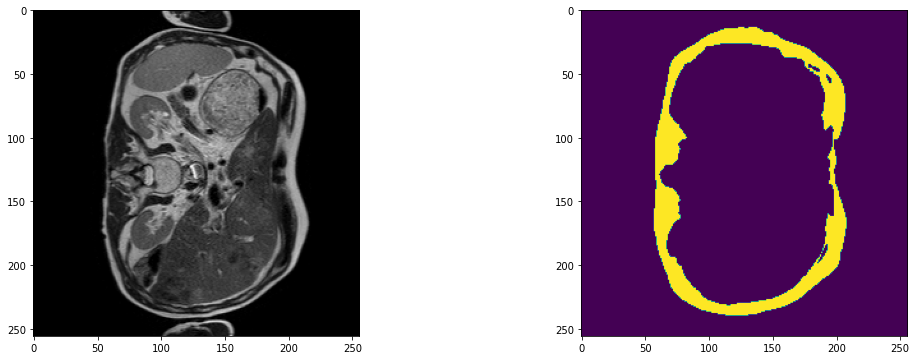

2023-07-17 11:32:06,426 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v1_T2W_seg.nii.gz


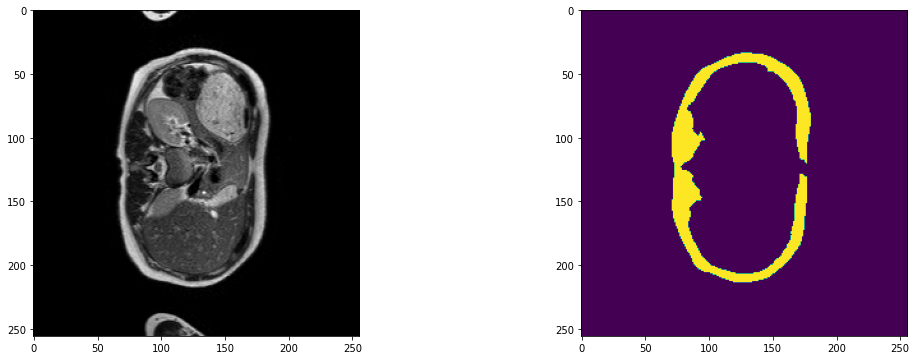

2023-07-17 11:32:09,008 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v2_T2W_seg.nii.gz


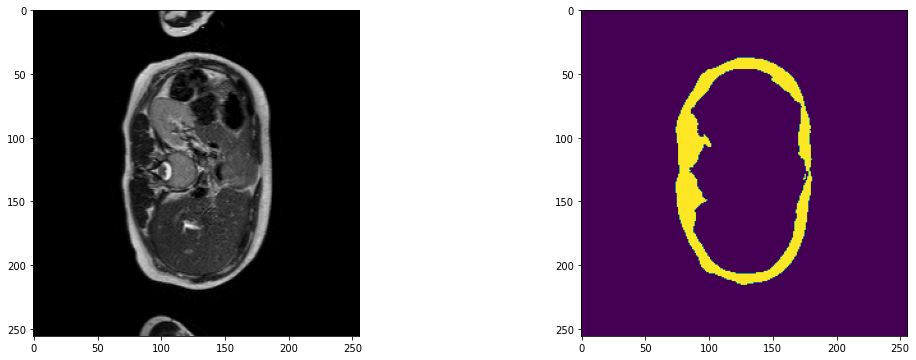

2023-07-17 11:32:11,587 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v3_T2W_seg.nii.gz


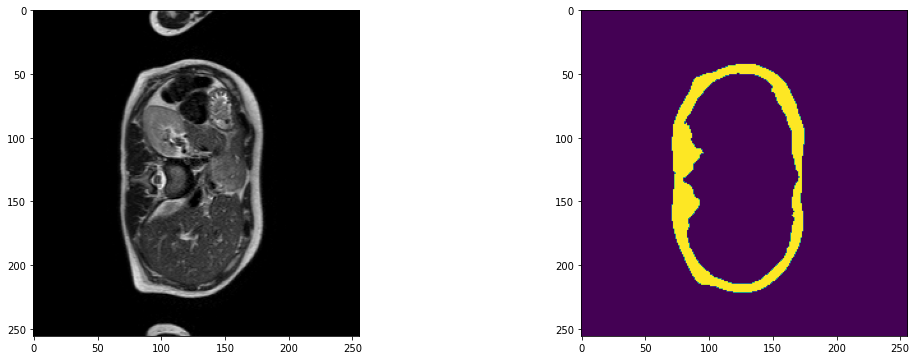

2023-07-17 11:32:14,141 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v4_T2W_seg.nii.gz


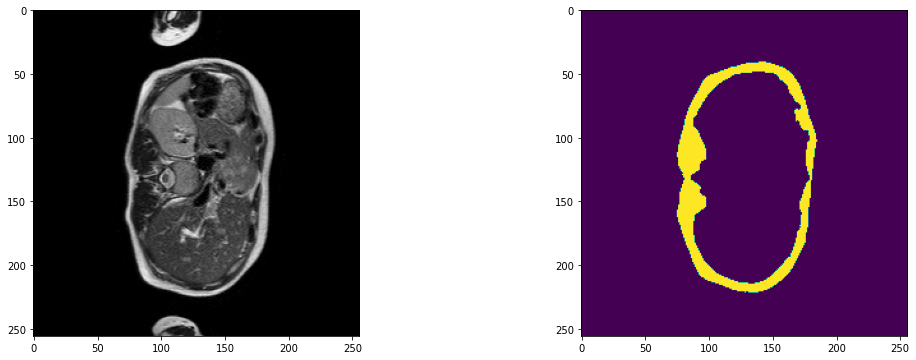

2023-07-17 11:32:16,682 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v5_T2W_seg.nii.gz


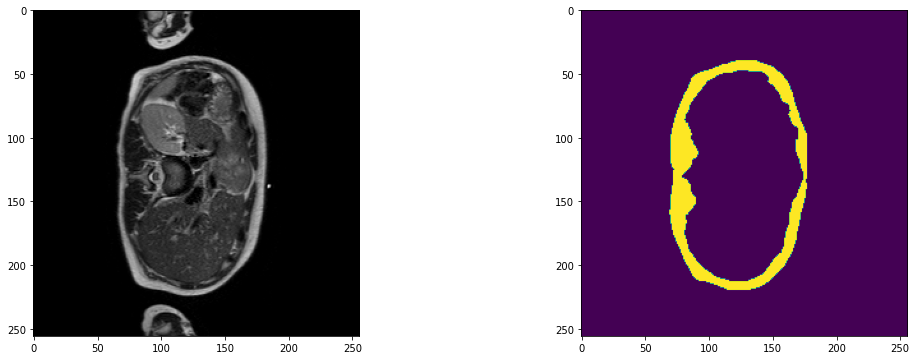

2023-07-17 11:32:19,265 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A031_v6_T2W_seg.nii.gz


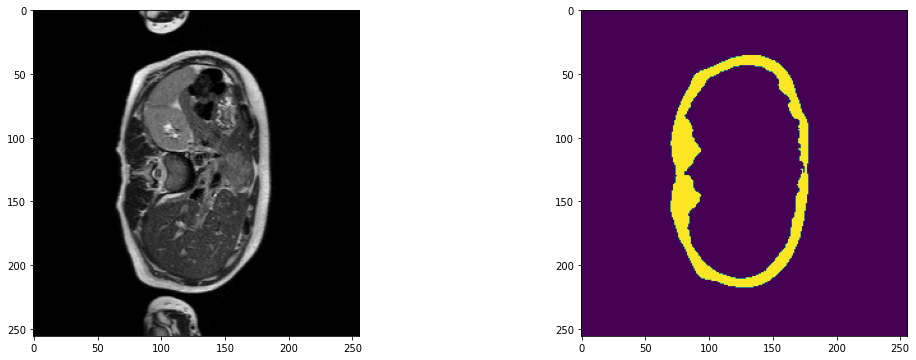

2023-07-17 11:32:27,884 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v1_T2W_seg.nii.gz


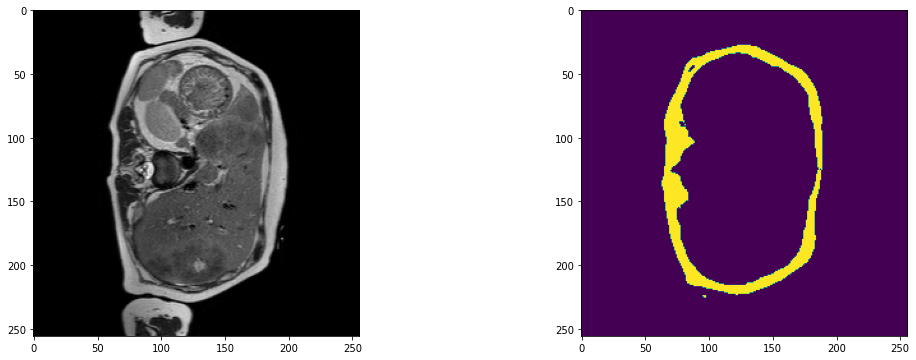

2023-07-17 11:32:36,503 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v2_T2W_seg.nii.gz


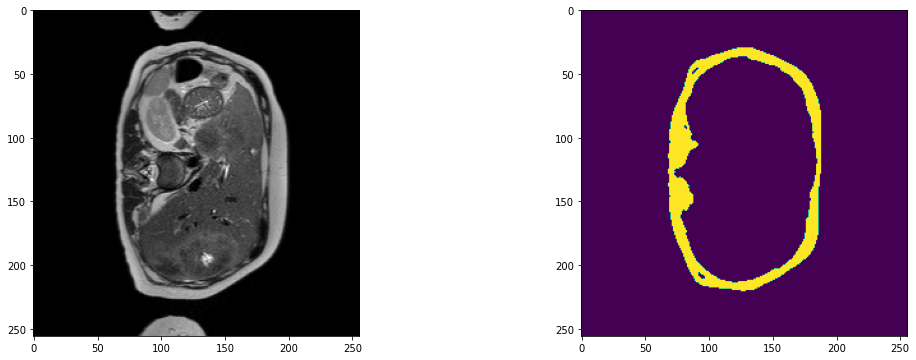

2023-07-17 11:32:45,156 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v3_T2W_seg.nii.gz


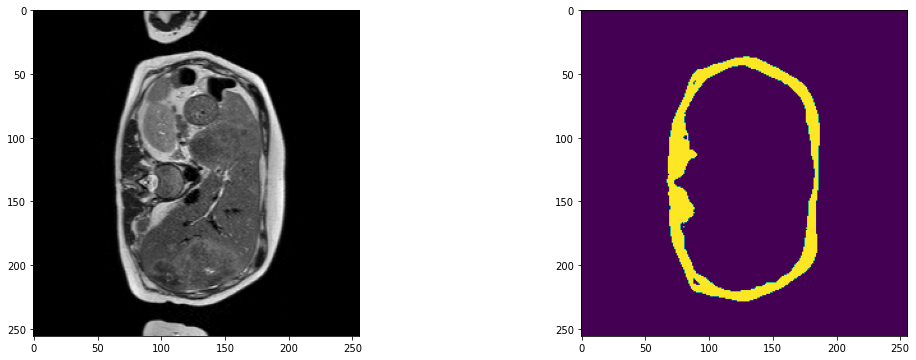

2023-07-17 11:32:53,777 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v4_T2W_seg.nii.gz


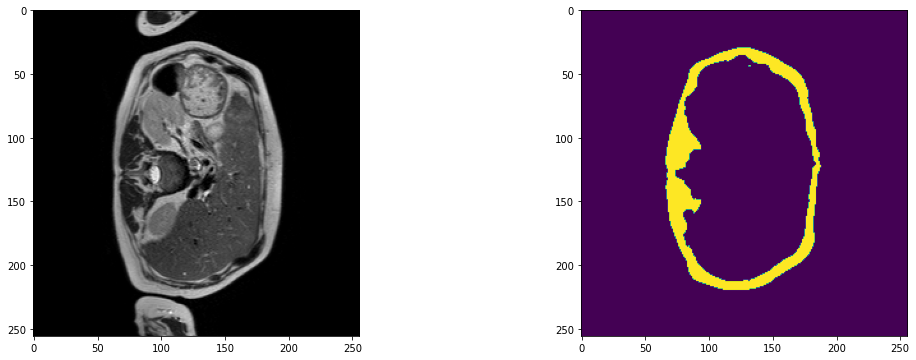

2023-07-17 11:33:02,559 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v5_T2W_seg.nii.gz


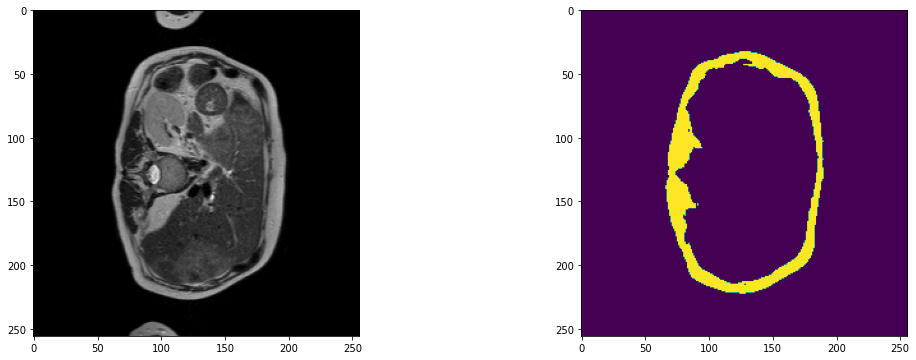

2023-07-17 11:33:10,095 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v6_T2W_seg.nii.gz


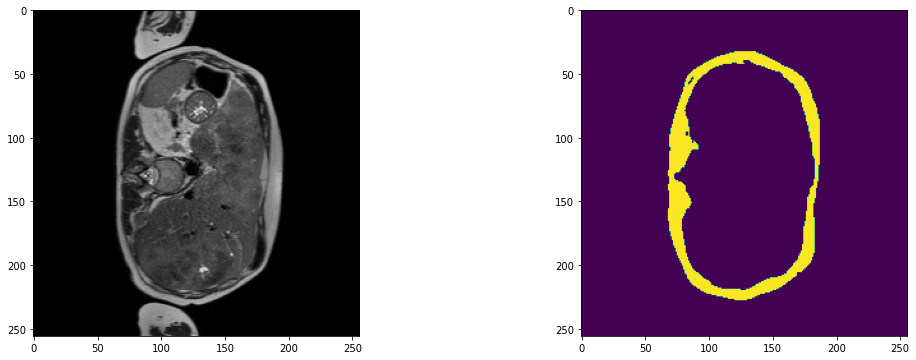

2023-07-17 11:33:17,420 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v7_T2W_seg.nii.gz


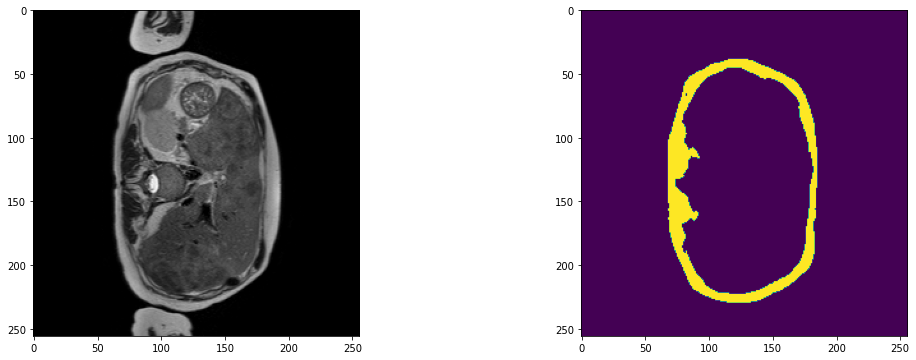

2023-07-17 11:33:24,766 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v8_T2W_seg.nii.gz


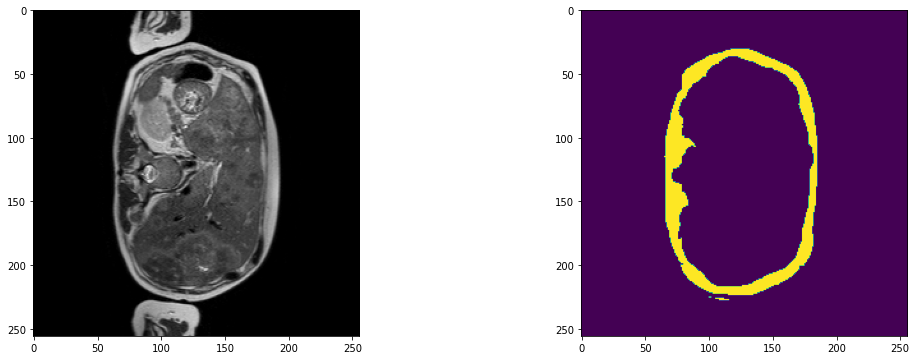

2023-07-17 11:33:33,428 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A032_v9_T2W_seg.nii.gz


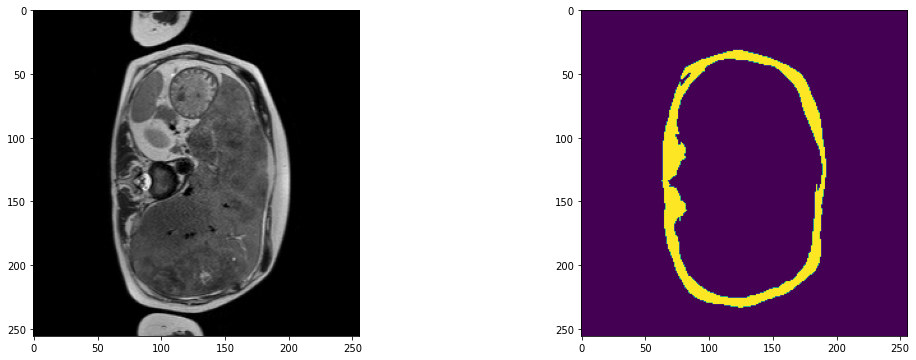

2023-07-17 11:33:42,106 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A033_v1_T2W_seg.nii.gz


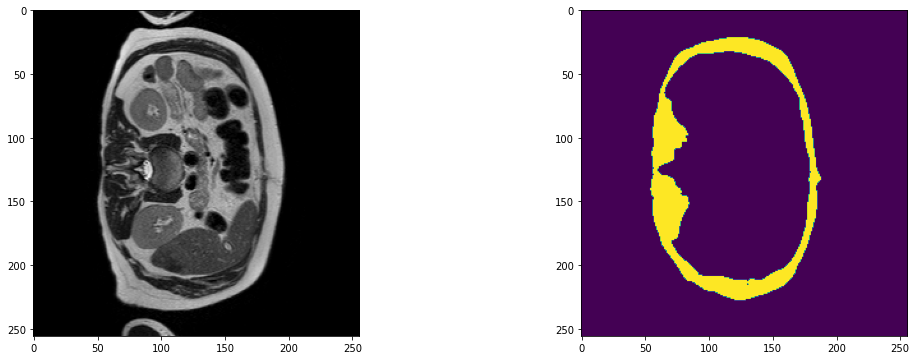

2023-07-17 11:33:50,775 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A033_v2_T2W_seg.nii.gz


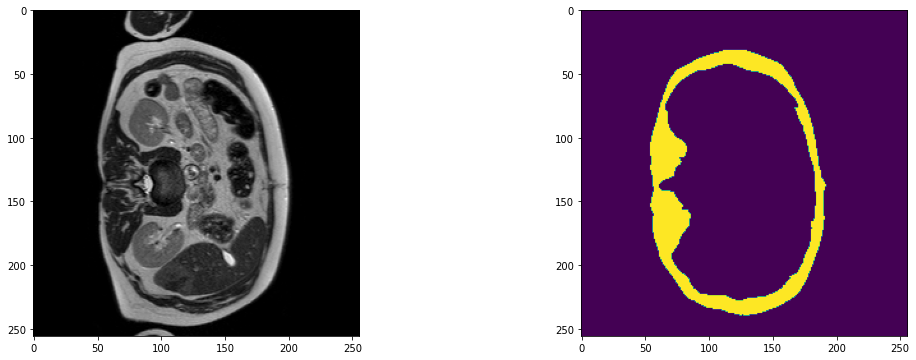

2023-07-17 11:33:59,431 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A033_v3_T2W_seg.nii.gz


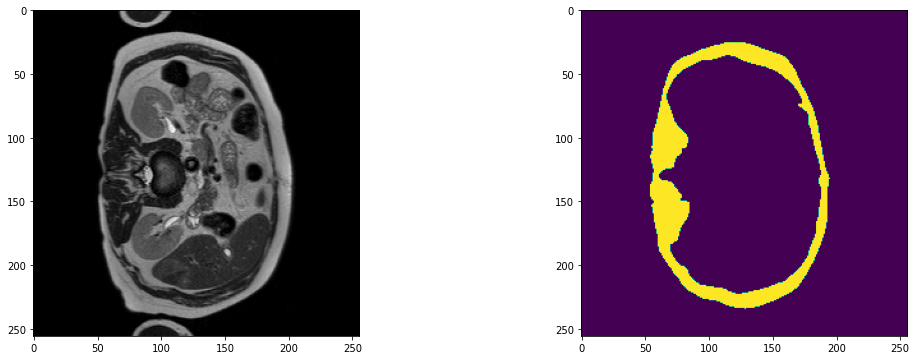

2023-07-17 11:34:08,110 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A033_v4_T2W_seg.nii.gz


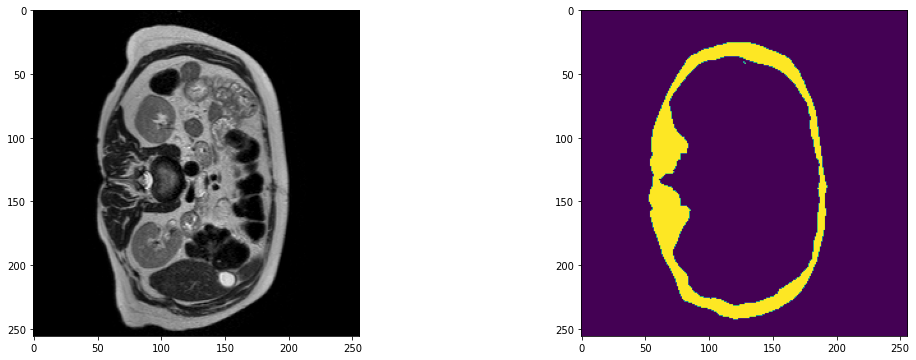

2023-07-17 11:34:16,783 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A033_v5_T2W_seg.nii.gz


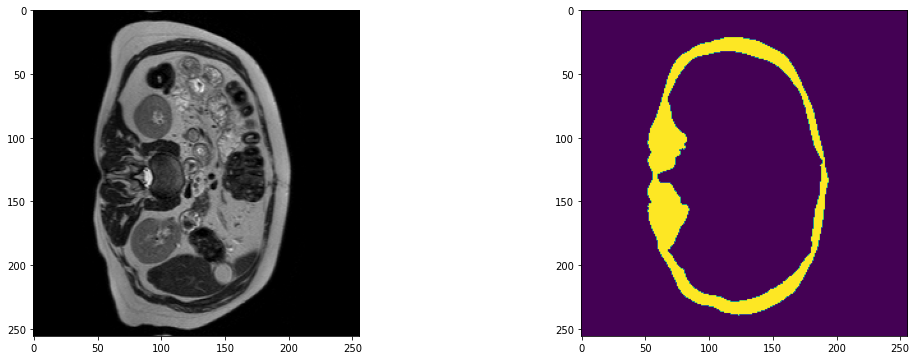

2023-07-17 11:34:25,468 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v1_T2W_seg.nii.gz


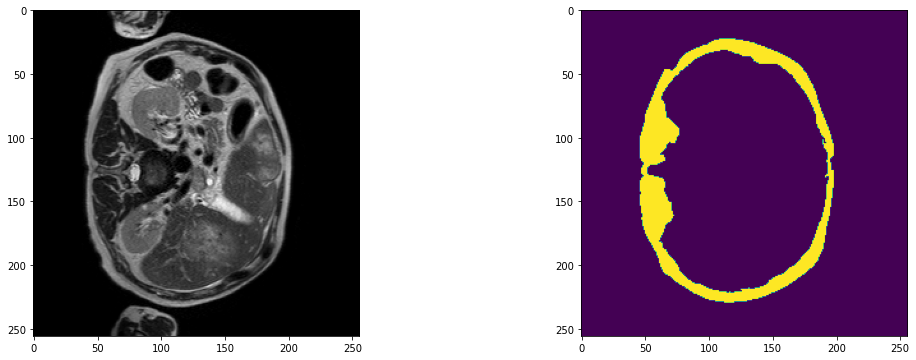

2023-07-17 11:34:34,149 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v2_T2W_seg.nii.gz


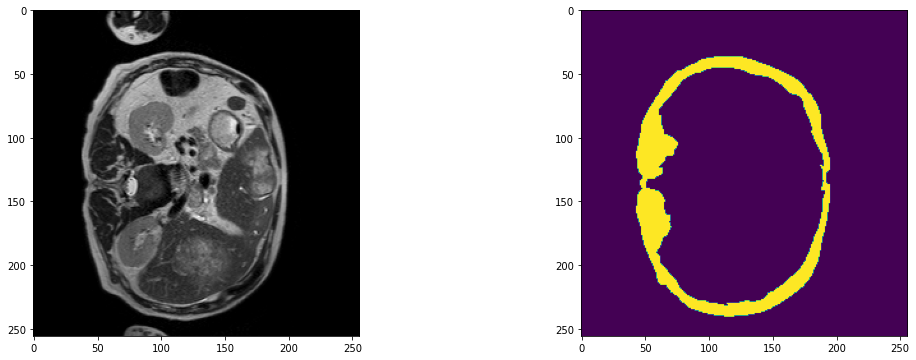

2023-07-17 11:34:42,831 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v3_T2W_seg.nii.gz


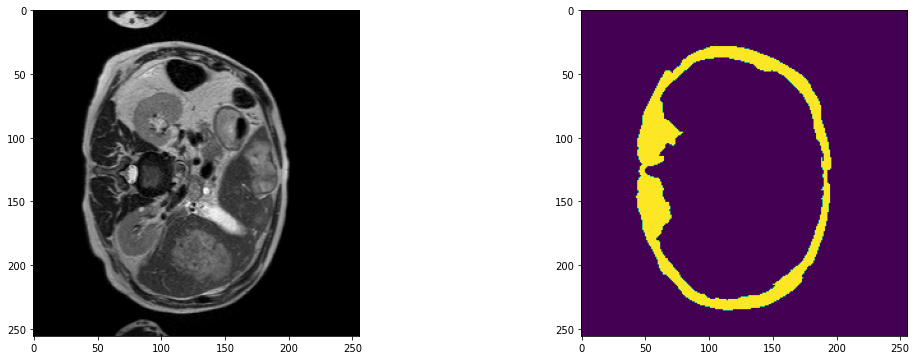

2023-07-17 11:34:51,666 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v4_T2W_seg.nii.gz


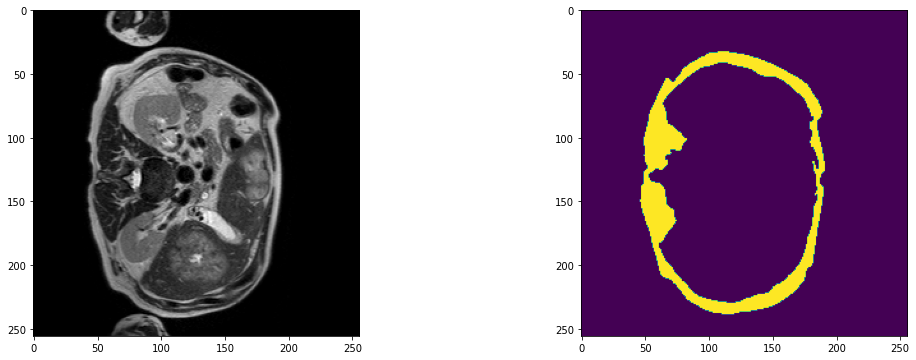

2023-07-17 11:35:00,339 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v5_T2W_seg.nii.gz


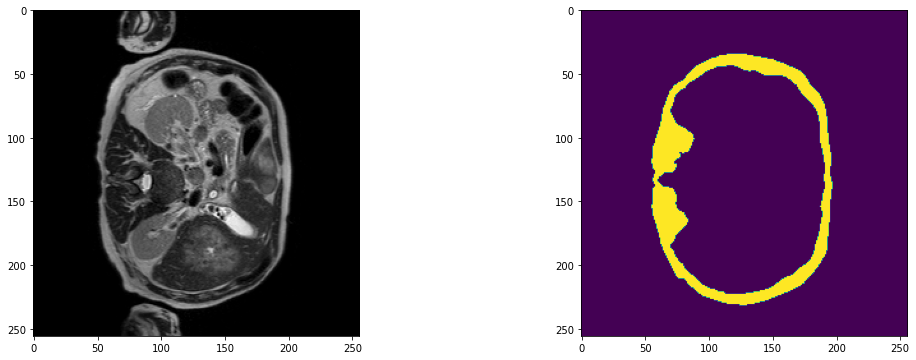

2023-07-17 11:35:08,999 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v6_T2W_seg.nii.gz


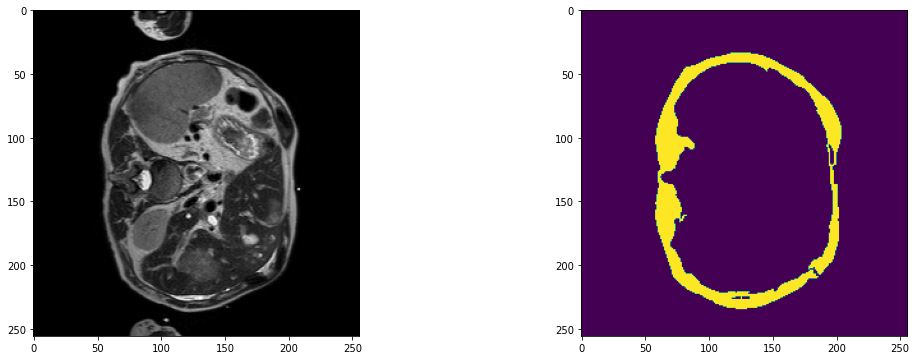

2023-07-17 11:35:17,666 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v7_T2W_seg.nii.gz


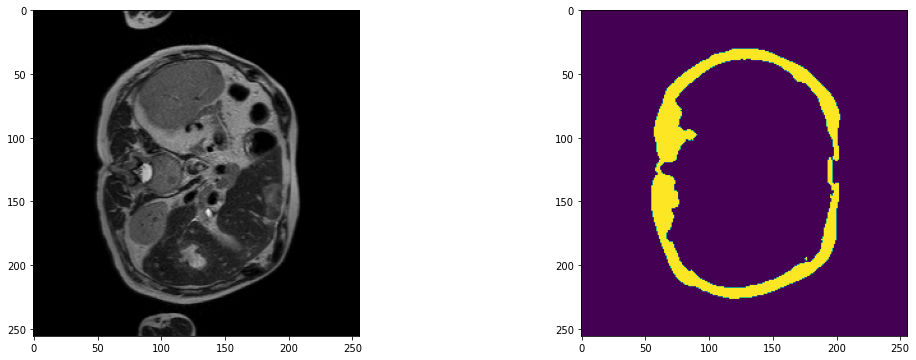

2023-07-17 11:35:26,340 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v8_T2W_seg.nii.gz


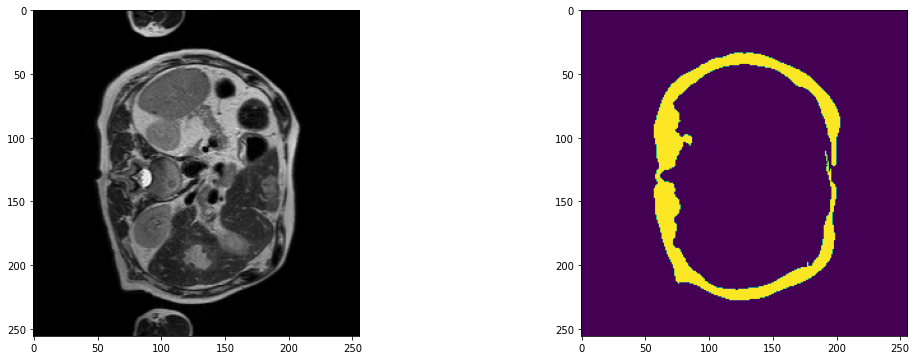

2023-07-17 11:35:35,013 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A034_v9_T2W_seg.nii.gz


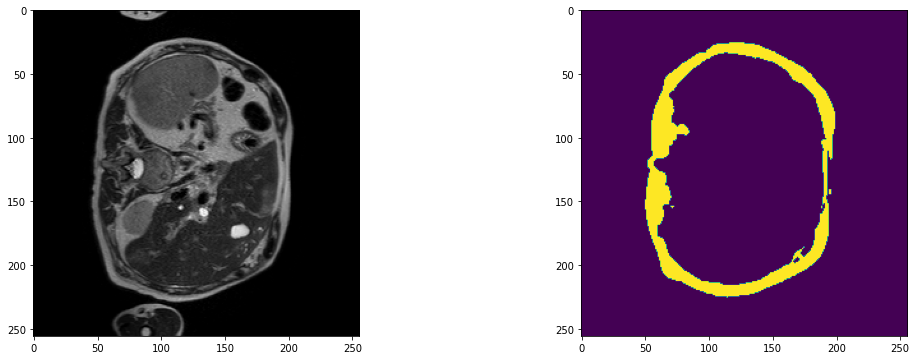

2023-07-17 11:35:42,371 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A037_v1_T2W_seg.nii.gz


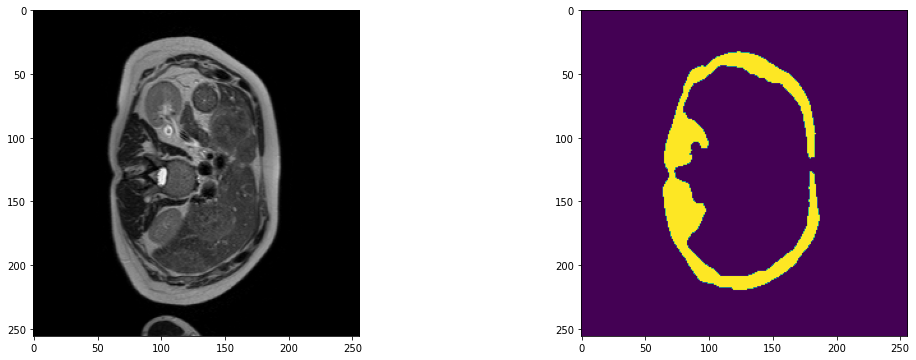

2023-07-17 11:35:51,030 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A037_v2_T2W_seg.nii.gz


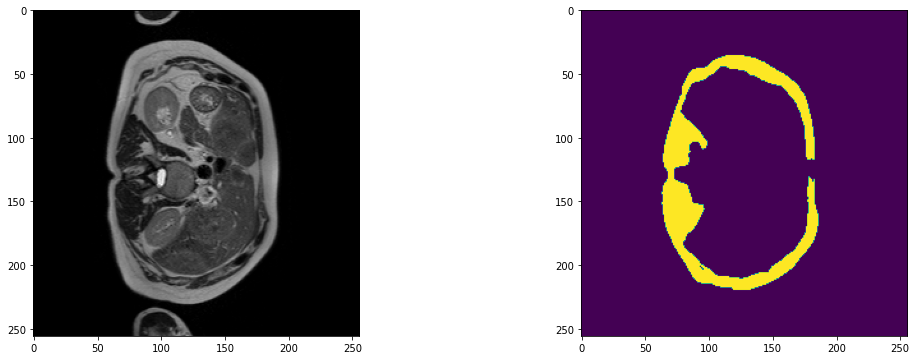

2023-07-17 11:35:59,710 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A037_v3_T2W_seg.nii.gz


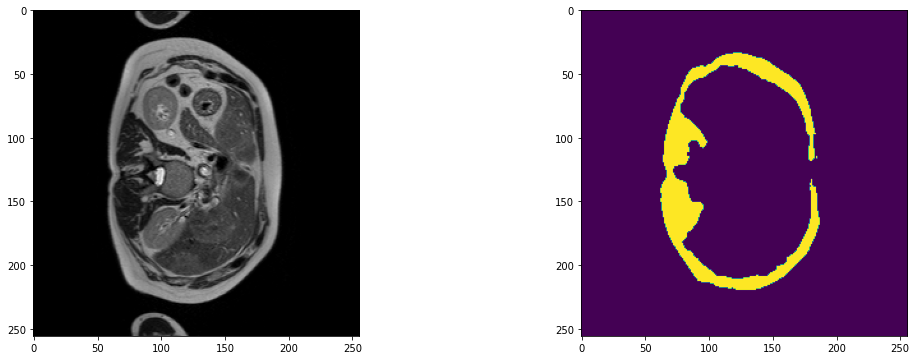

2023-07-17 11:36:07,081 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A037_v6_T2W_seg.nii.gz


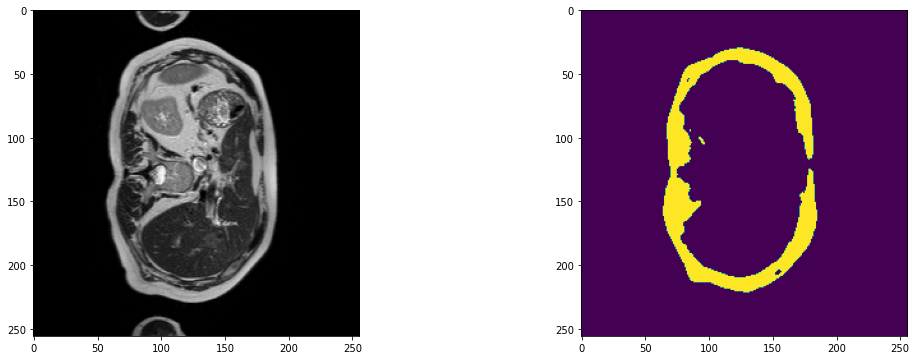

2023-07-17 11:36:14,451 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A037_v7_T2W_seg.nii.gz


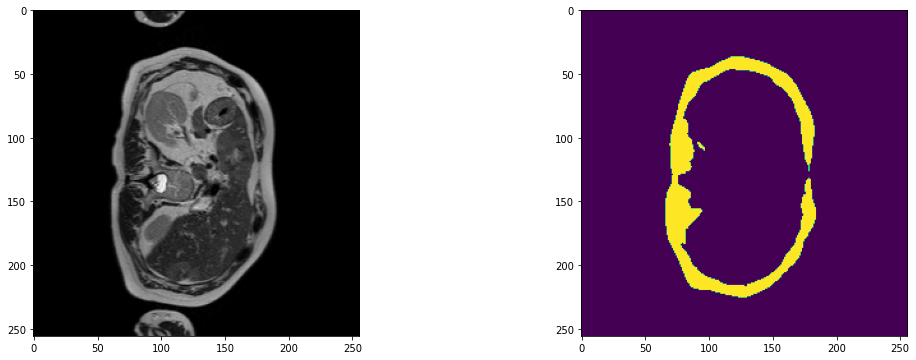

2023-07-17 11:36:17,392 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v1_T2W_seg.nii.gz


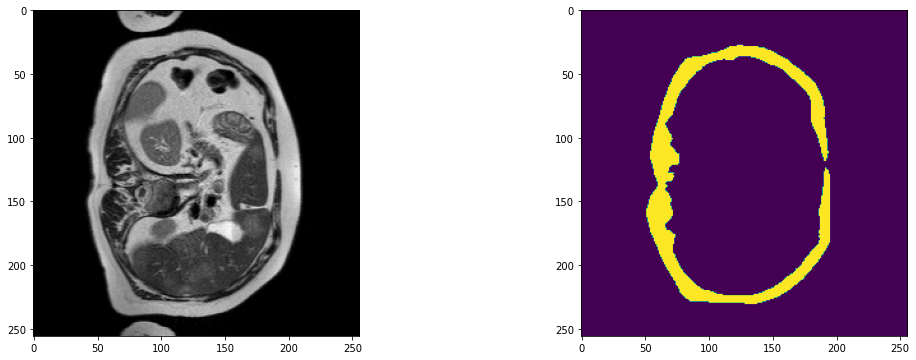

2023-07-17 11:36:20,354 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v2_T2W_seg.nii.gz


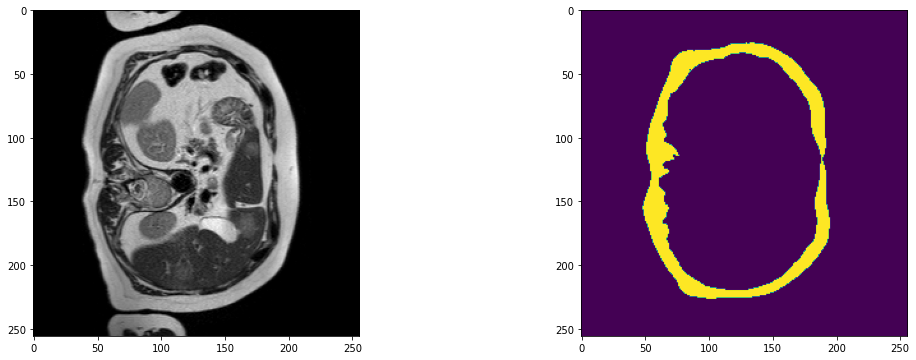

2023-07-17 11:36:23,441 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v3_T2W_seg.nii.gz


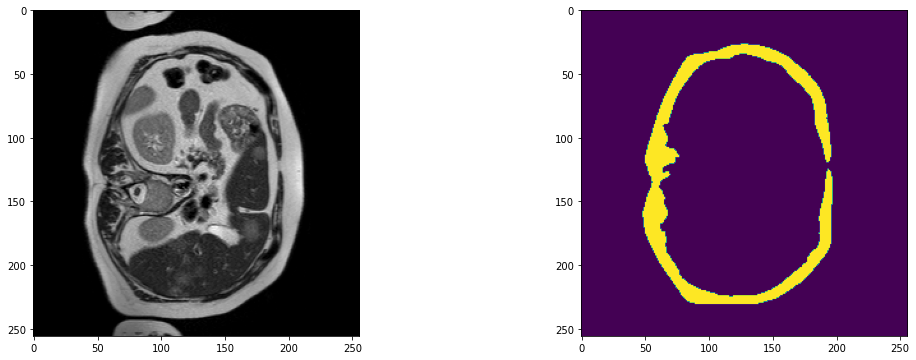

2023-07-17 11:36:26,384 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v4_T2W_seg.nii.gz


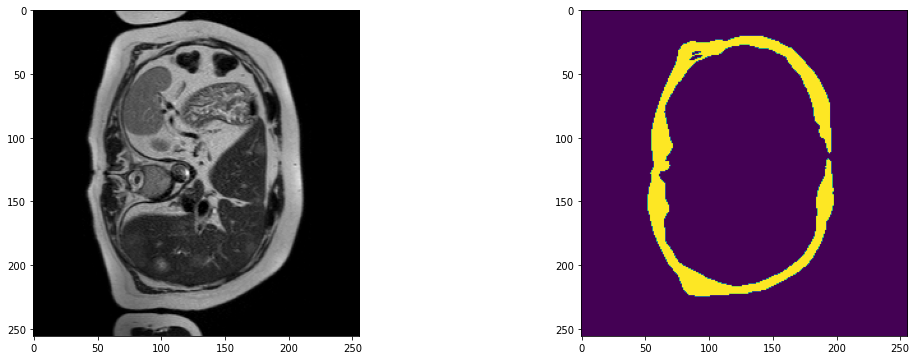

2023-07-17 11:36:29,337 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v5_T2W_seg.nii.gz


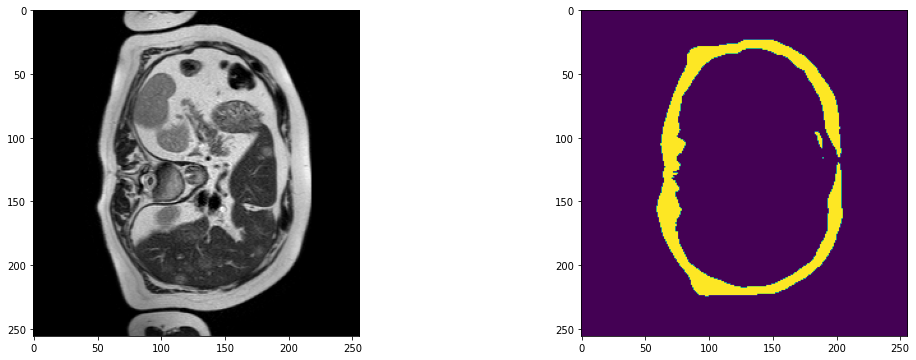

2023-07-17 11:36:32,281 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v6_T2W_seg.nii.gz


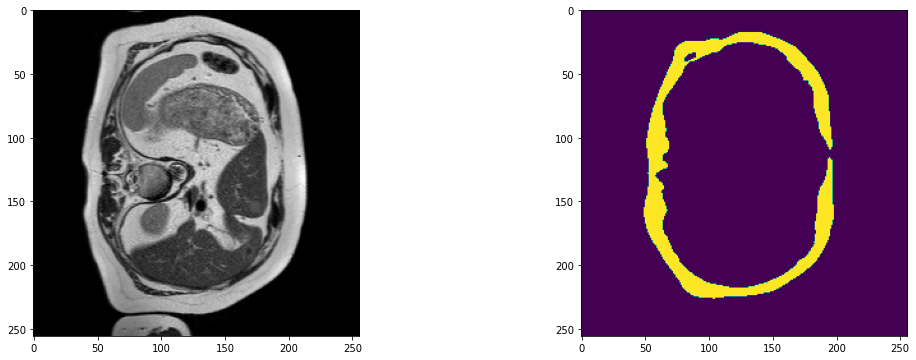

2023-07-17 11:36:35,226 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v7_T2W_seg.nii.gz


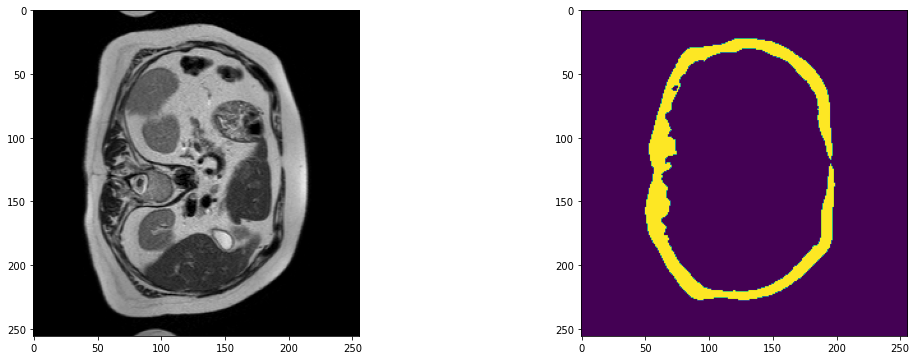

2023-07-17 11:36:38,195 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v8_T2W_seg.nii.gz


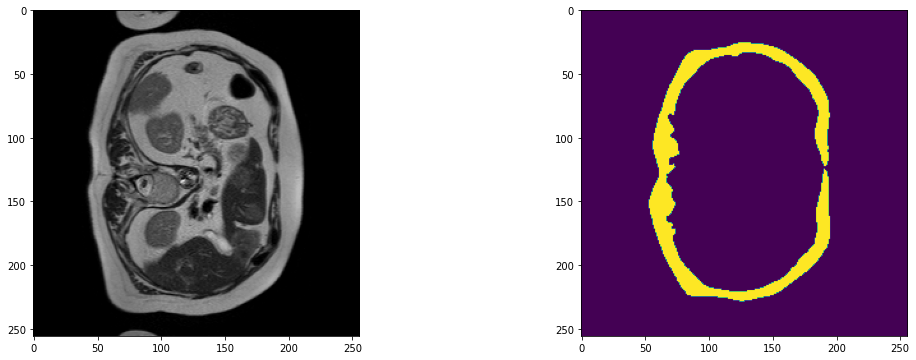

2023-07-17 11:36:41,163 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A038_v9_T2W_seg.nii.gz


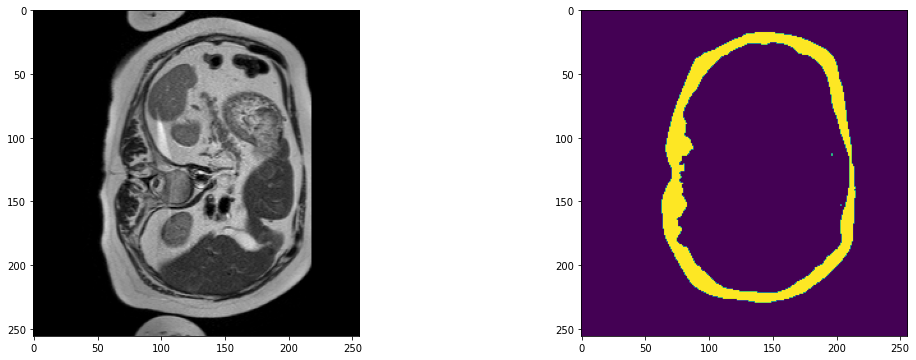

2023-07-17 11:36:43,740 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v1_T2W_seg.nii.gz


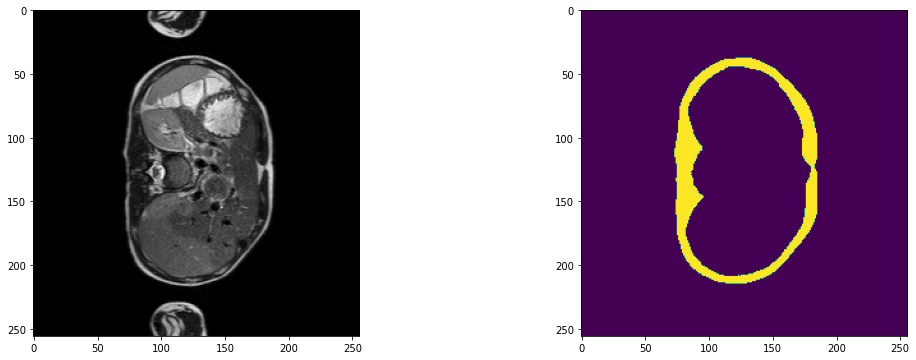

2023-07-17 11:36:45,946 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v2_T2W_seg.nii.gz


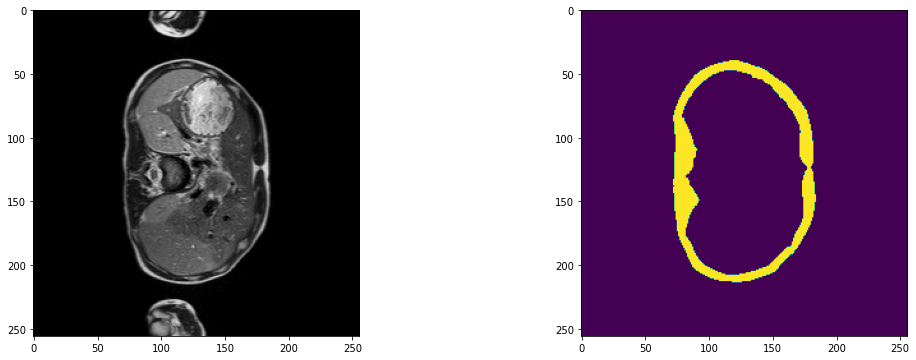

2023-07-17 11:36:48,135 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v3_T2W_seg.nii.gz


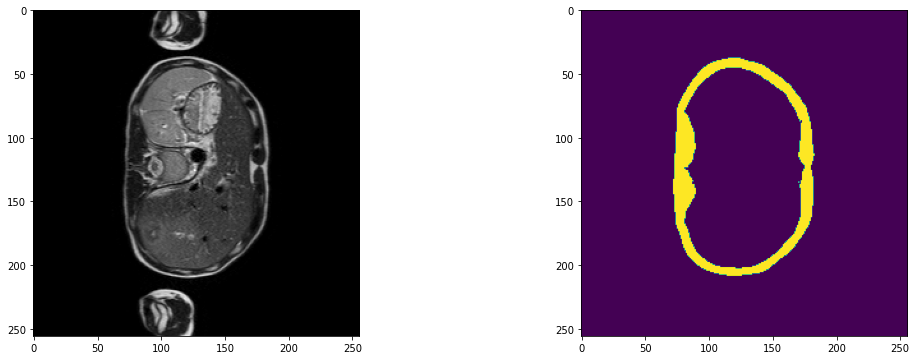

2023-07-17 11:36:50,315 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v4_T2W_seg.nii.gz


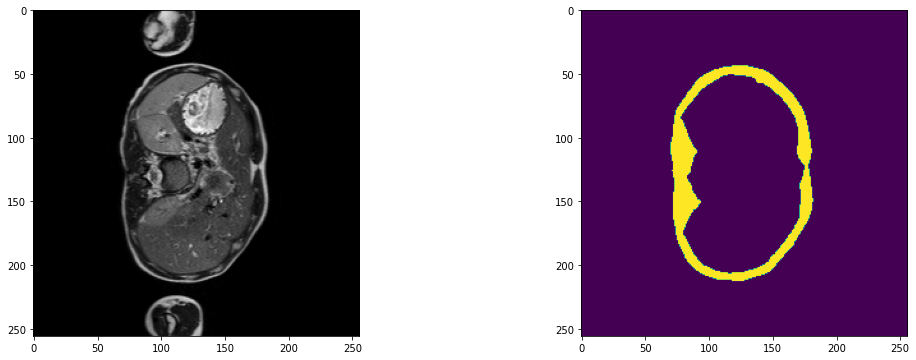

2023-07-17 11:36:52,496 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v5_T2W_seg.nii.gz


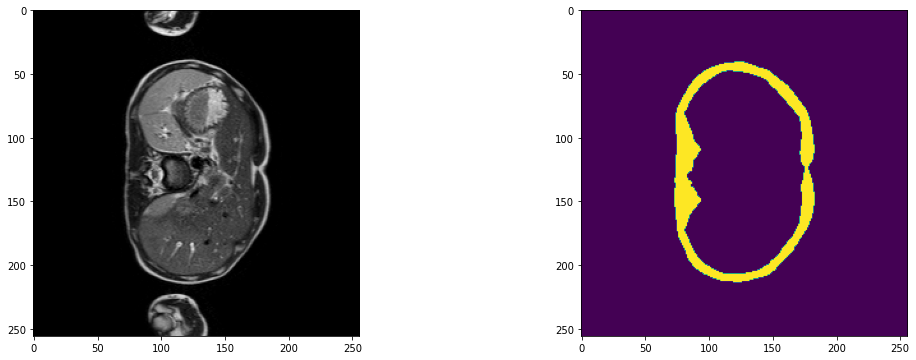

2023-07-17 11:36:55,047 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v6_T2W_seg.nii.gz


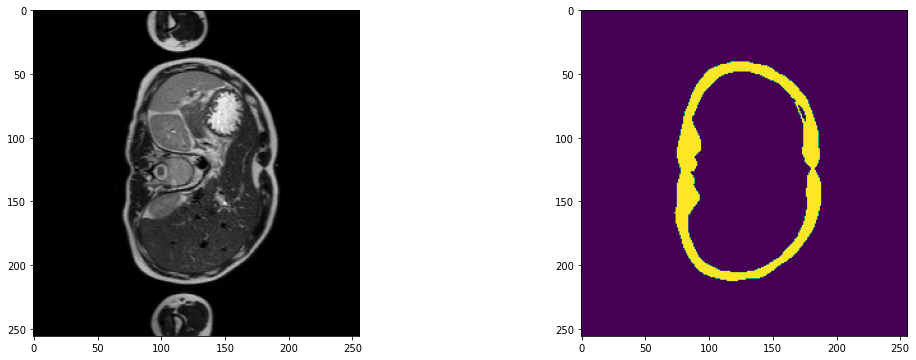

2023-07-17 11:36:57,366 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v7_T2W_seg.nii.gz


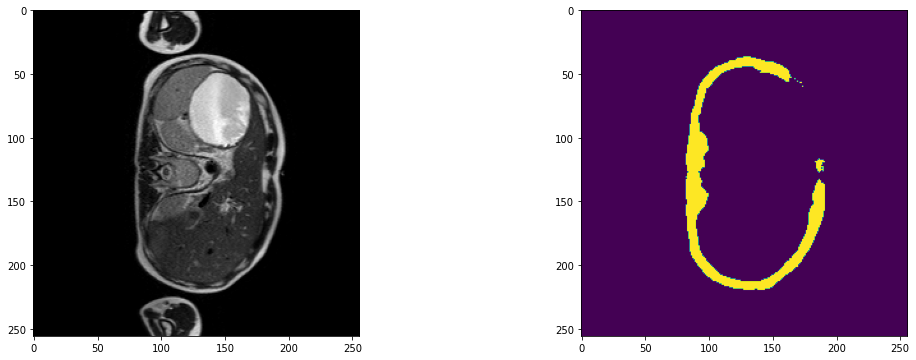

2023-07-17 11:36:59,932 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A039_v9_T2W_seg.nii.gz


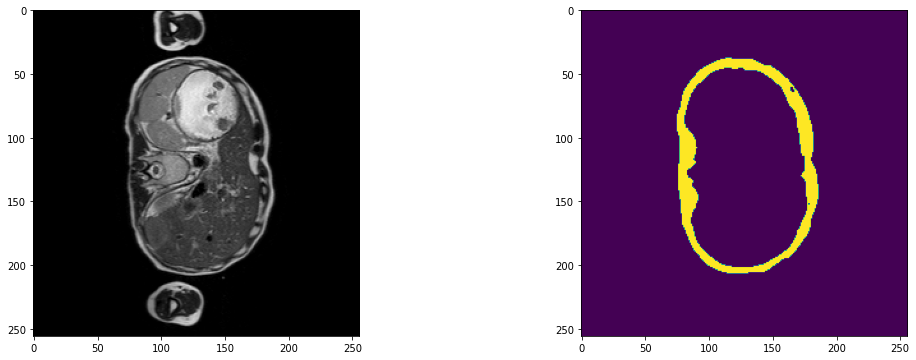

2023-07-17 11:37:08,582 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A040_v1_T2W_seg.nii.gz


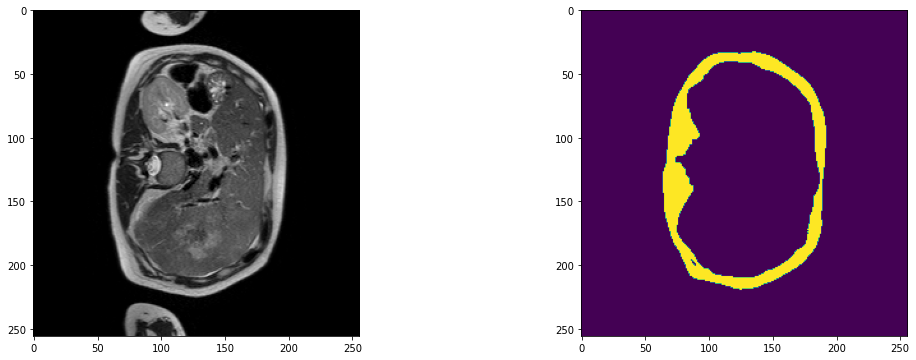

2023-07-17 11:37:17,259 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A040_v2_T2W_seg.nii.gz


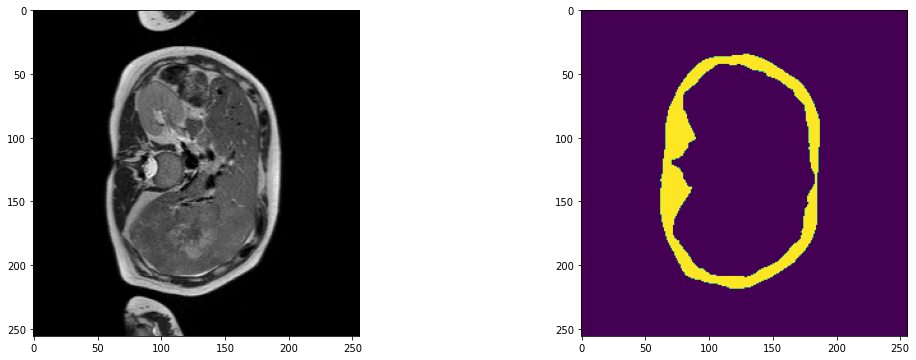

2023-07-17 11:37:25,919 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A040_v3_T2W_seg.nii.gz


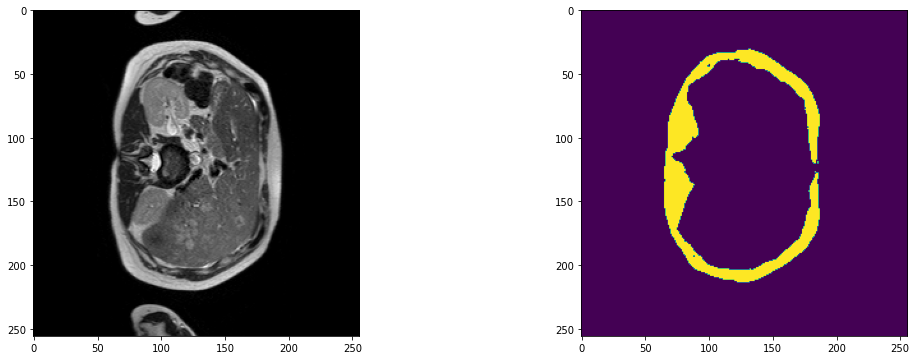

2023-07-17 11:37:33,253 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A040_v4_T2W_seg.nii.gz


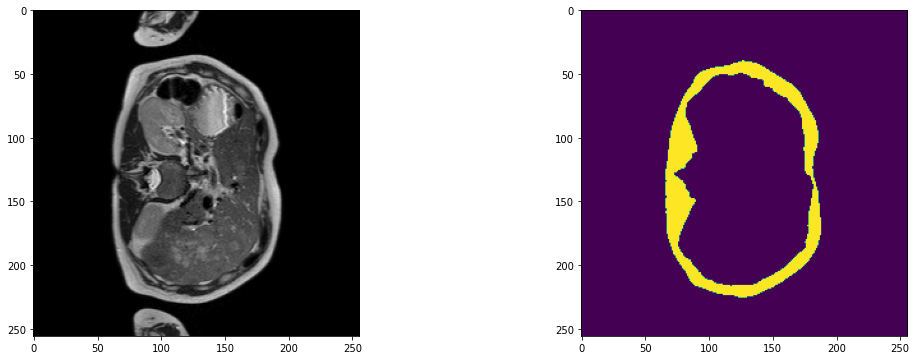

2023-07-17 11:37:40,587 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A040_v5_T2W_seg.nii.gz


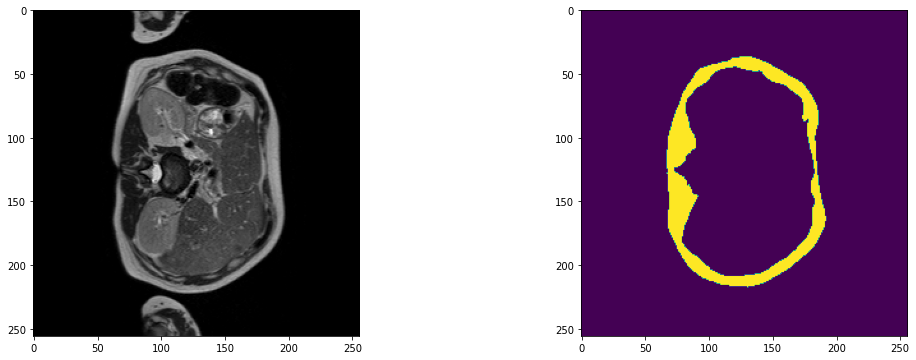

2023-07-17 11:37:43,546 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A041_v1_T2W_seg.nii.gz


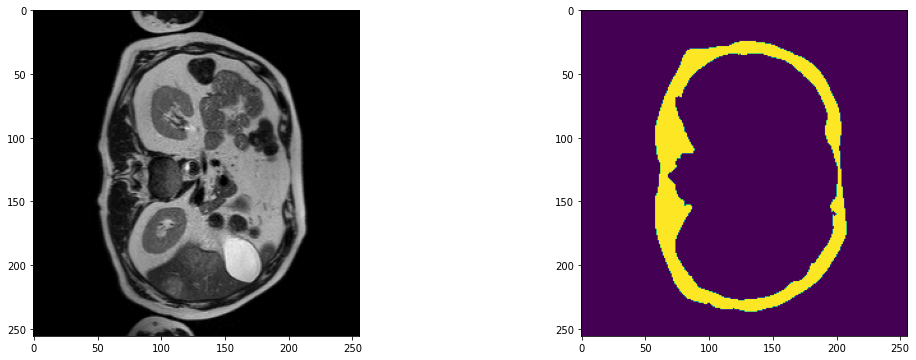

2023-07-17 11:37:46,502 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A041_v2_T2W_seg.nii.gz


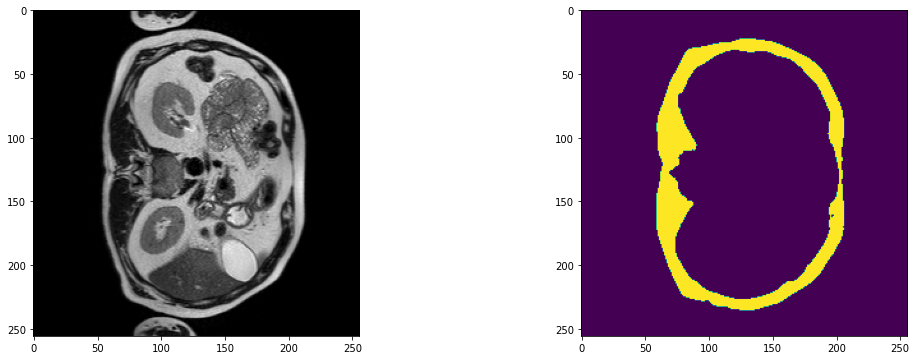

2023-07-17 11:37:49,462 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A041_v4_T2W_seg.nii.gz


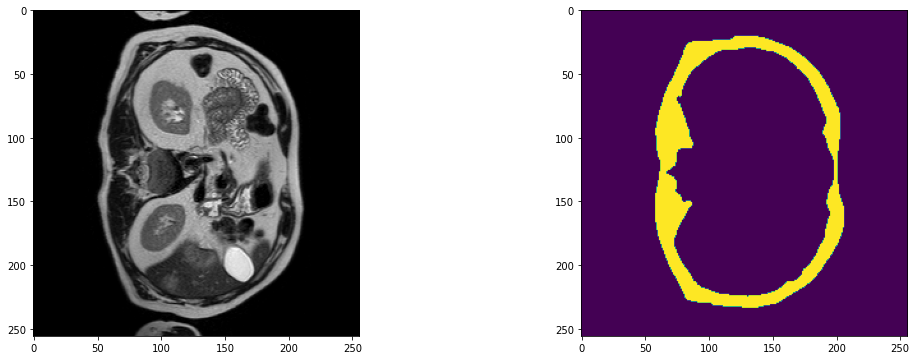

2023-07-17 11:37:52,420 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A041_v5_T2W_seg.nii.gz


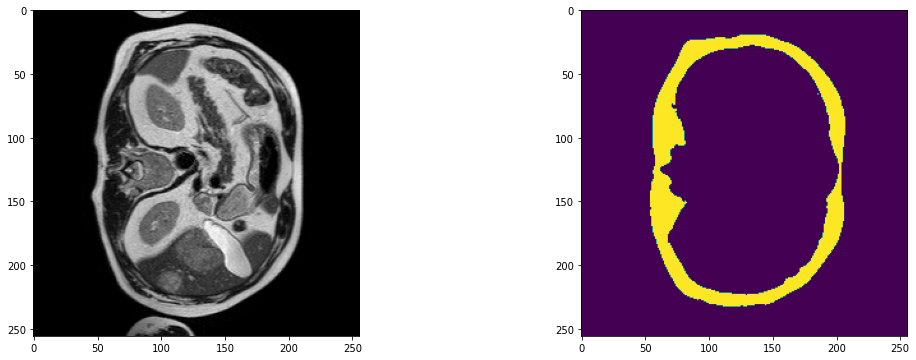

2023-07-17 11:37:55,365 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A041_v6_T2W_seg.nii.gz


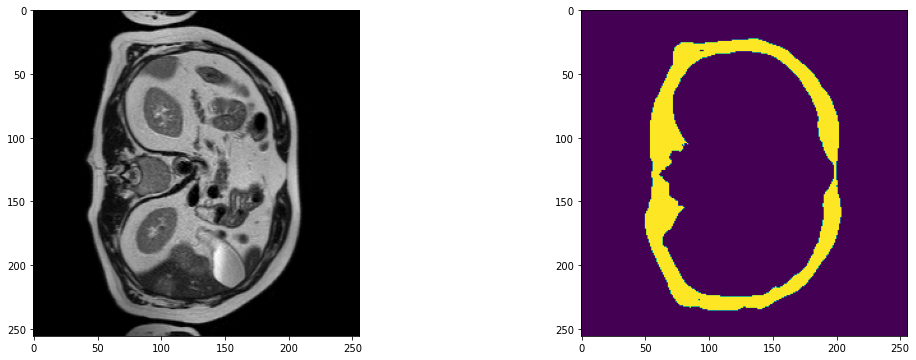

2023-07-17 11:37:58,321 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v1_T2W_seg.nii.gz


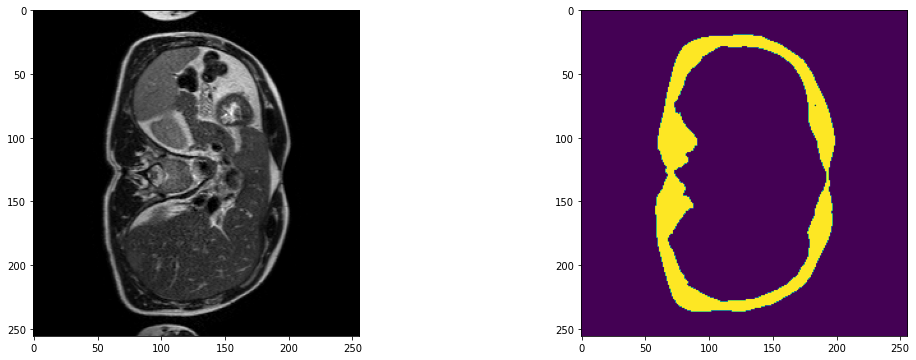

2023-07-17 11:38:01,394 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v2_T2W_seg.nii.gz


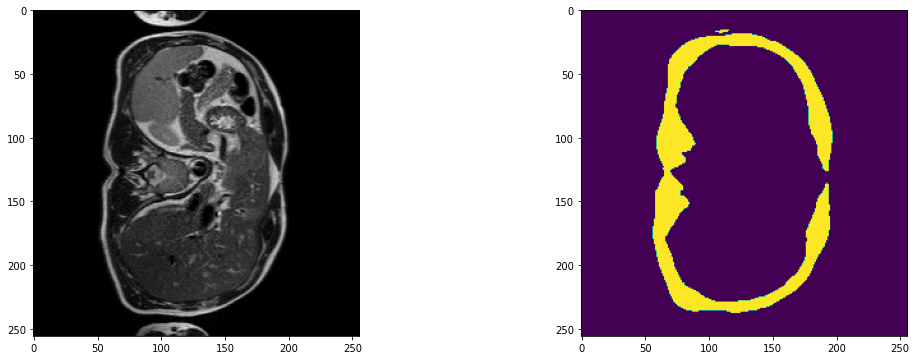

2023-07-17 11:38:03,947 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v3_T2W_seg.nii.gz


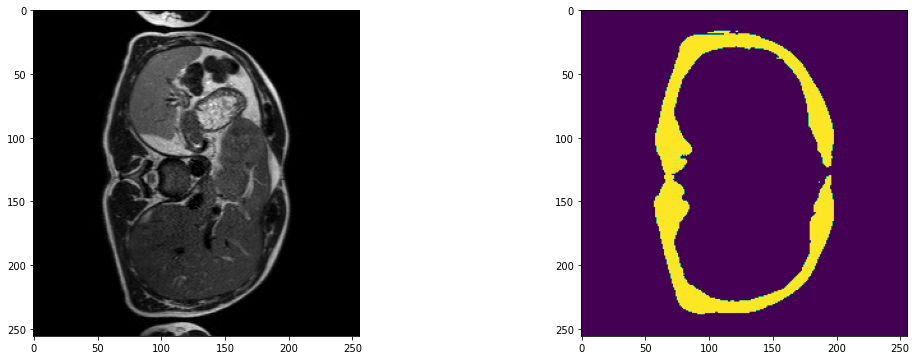

2023-07-17 11:38:06,886 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v4_T2W_seg.nii.gz


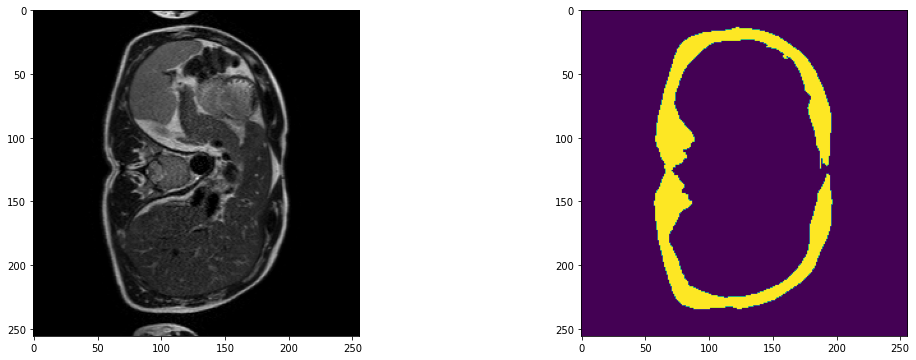

2023-07-17 11:38:09,826 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v5_T2W_seg.nii.gz


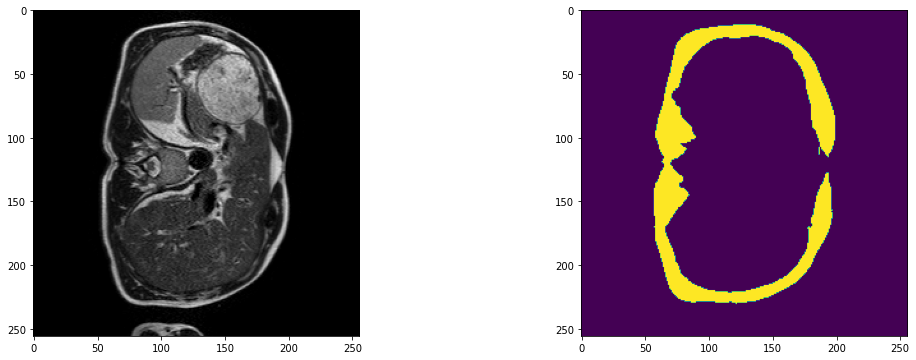

2023-07-17 11:38:12,763 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v6_T2W_seg.nii.gz


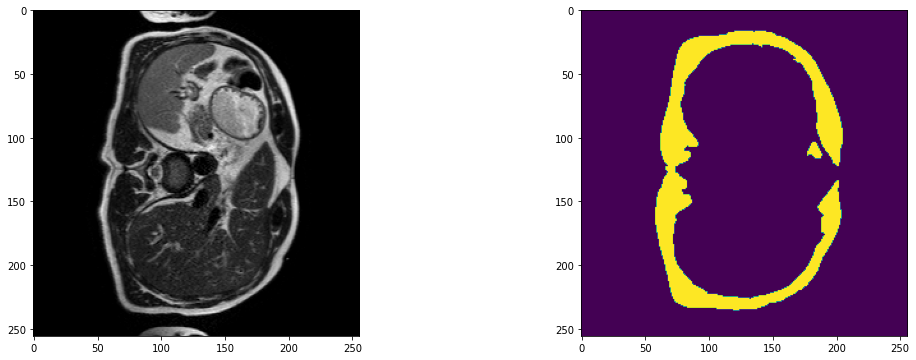

2023-07-17 11:38:15,718 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A046_v7_T2W_seg.nii.gz


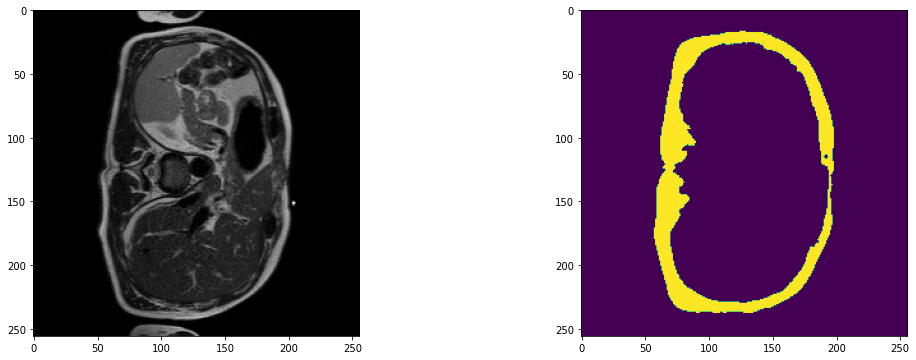

2023-07-17 11:38:18,656 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v1_T2W_seg.nii.gz


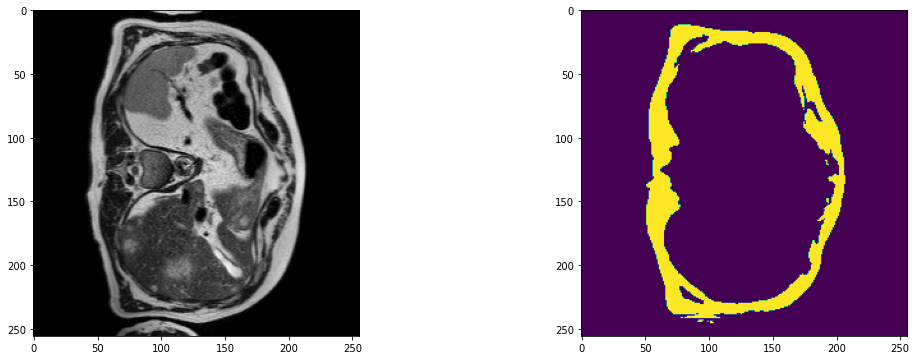

2023-07-17 11:38:21,593 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v2_T2W_seg.nii.gz


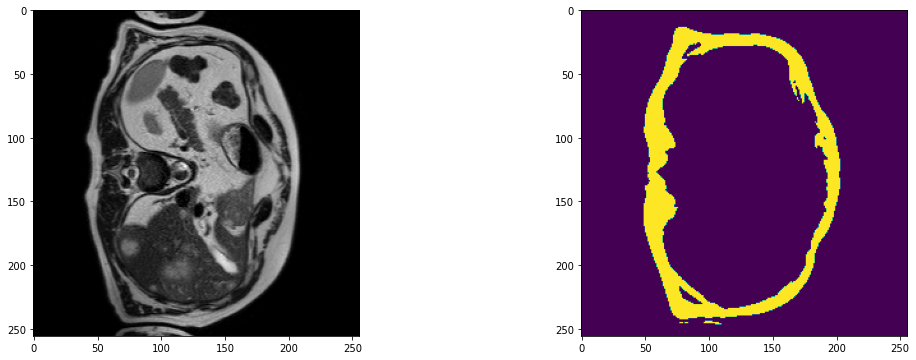

2023-07-17 11:38:24,548 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v3_T2W_seg.nii.gz


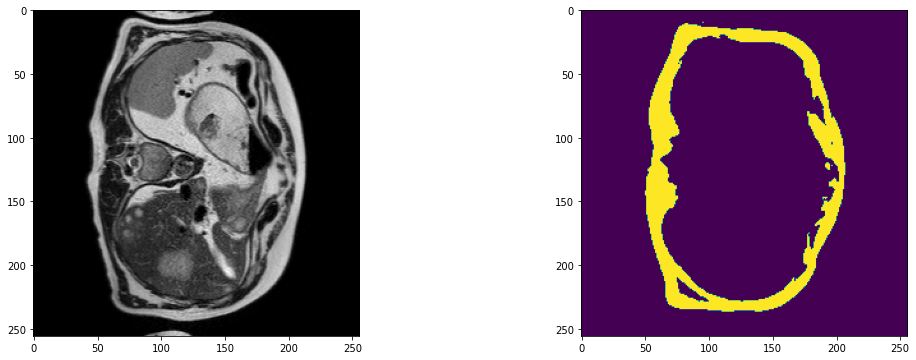

2023-07-17 11:38:27,481 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v4_T2W_seg.nii.gz


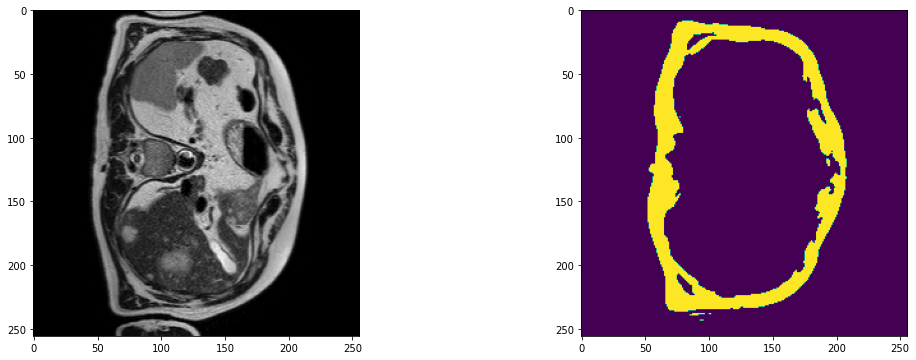

2023-07-17 11:38:30,425 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v5_T2W_seg.nii.gz


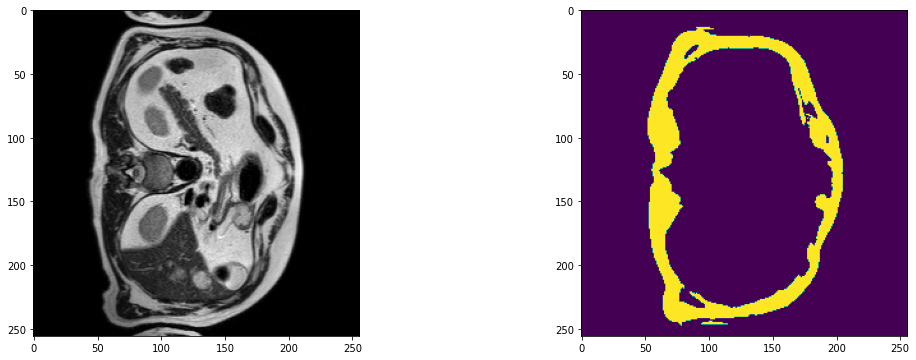

2023-07-17 11:38:33,363 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v6_T2W_seg.nii.gz


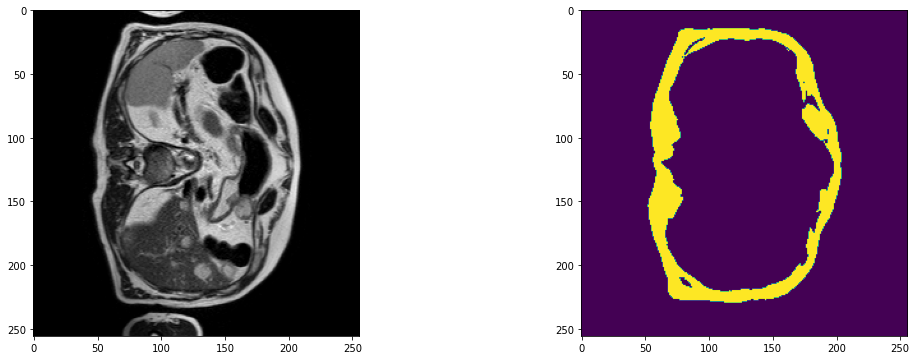

2023-07-17 11:38:36,308 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A048_v7_T2W_seg.nii.gz


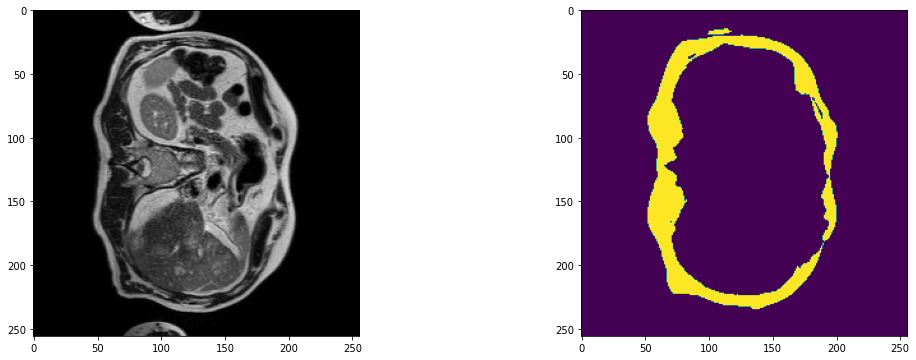

2023-07-17 11:38:39,374 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A049_v1_T2W_seg.nii.gz


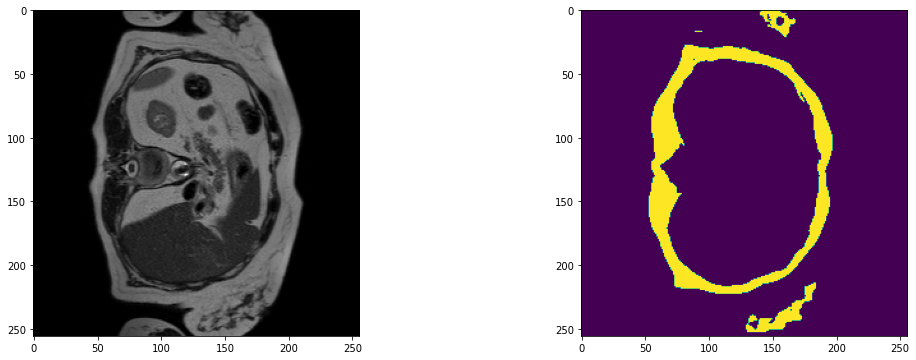

2023-07-17 11:38:42,322 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A049_v2_T2W_seg.nii.gz


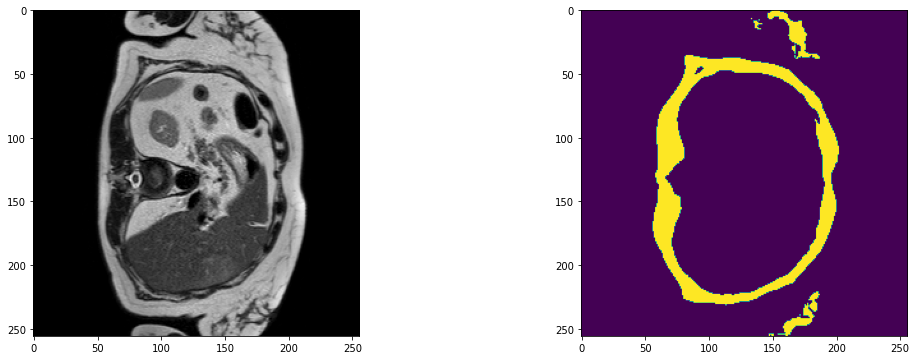

2023-07-17 11:38:45,253 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A049_v3_T2W_seg.nii.gz


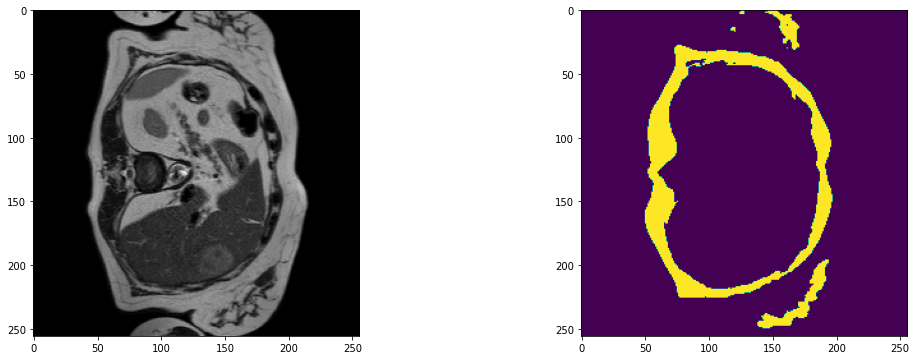

2023-07-17 11:38:48,210 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A049_v4_T2W_seg.nii.gz


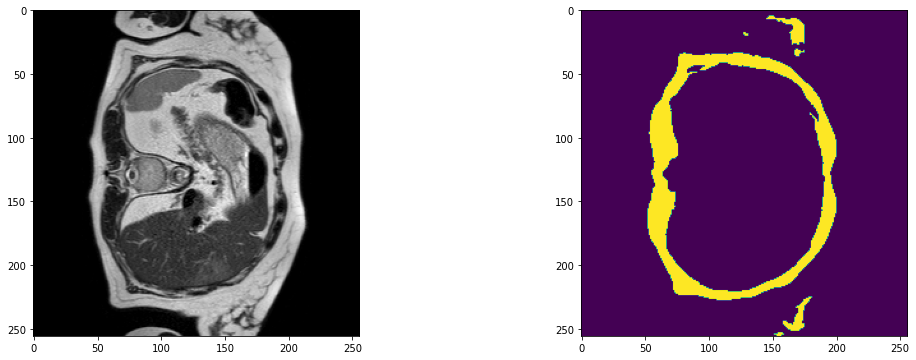

2023-07-17 11:38:51,158 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A049_v5_T2W_seg.nii.gz


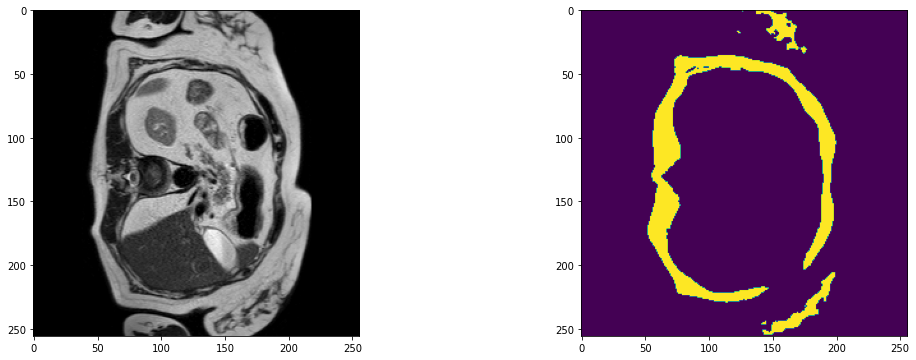

2023-07-17 11:38:59,827 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A052_v1_T2W_seg.nii.gz


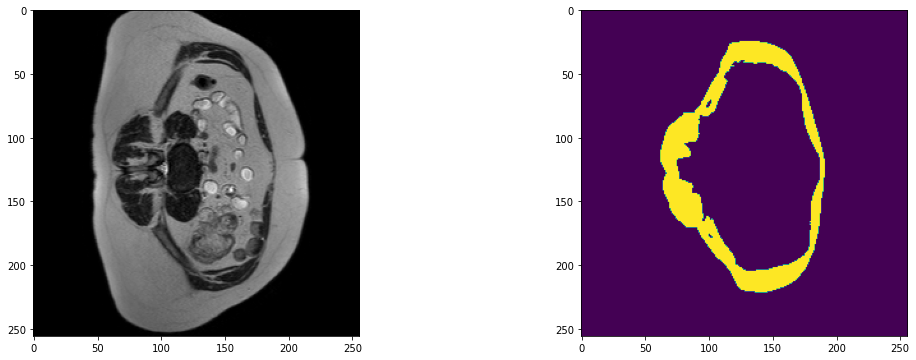

2023-07-17 11:39:08,478 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A052_v2_T2W_seg.nii.gz


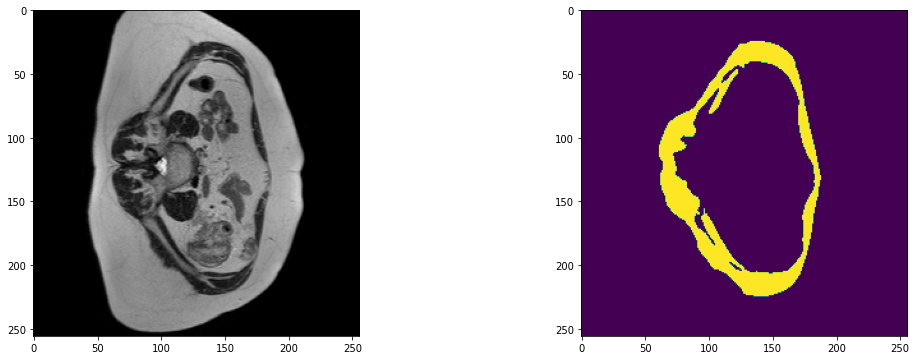

2023-07-17 11:39:17,160 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A052_v4_T2W_seg.nii.gz


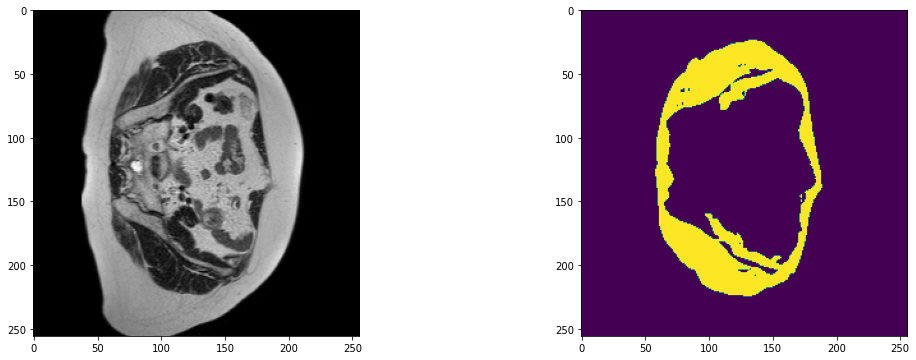

2023-07-17 11:39:25,855 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A052_v5_T2W_seg.nii.gz


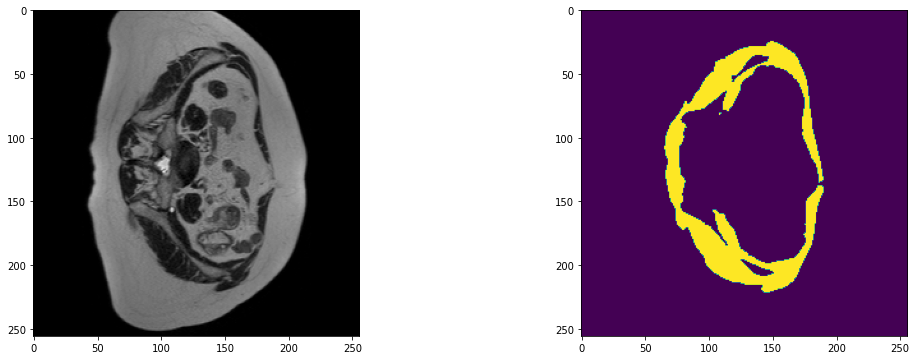

2023-07-17 11:39:28,806 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v1_T2W_seg.nii.gz


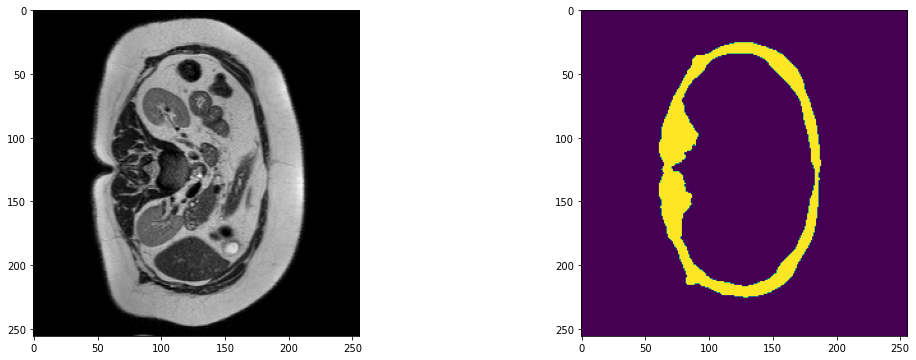

2023-07-17 11:39:31,733 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v2_T2W_seg.nii.gz


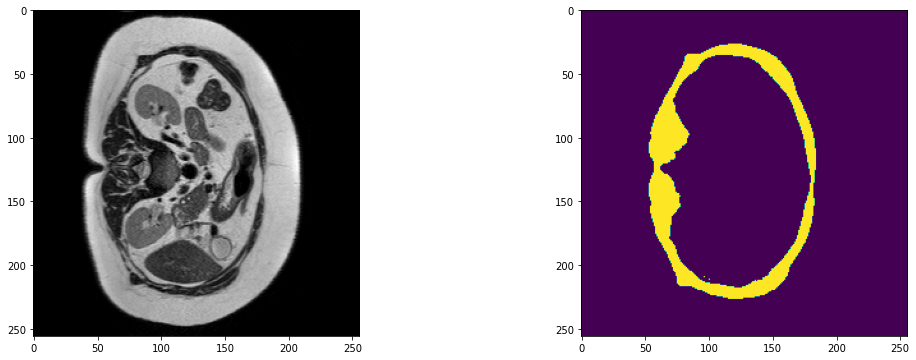

2023-07-17 11:39:34,685 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v3_T2W_seg.nii.gz


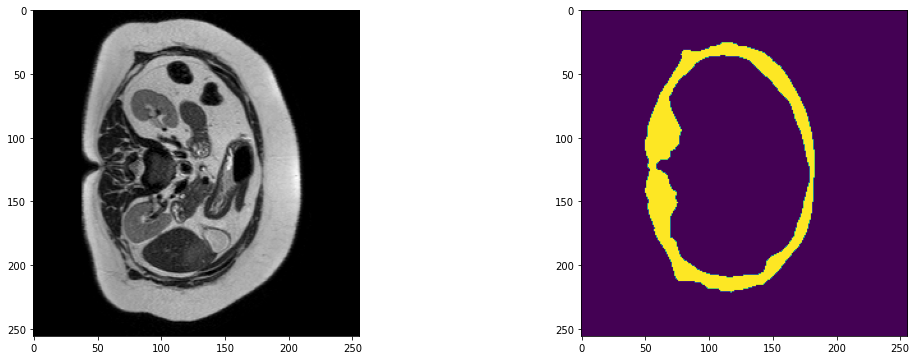

2023-07-17 11:39:37,636 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v4_T2W_seg.nii.gz


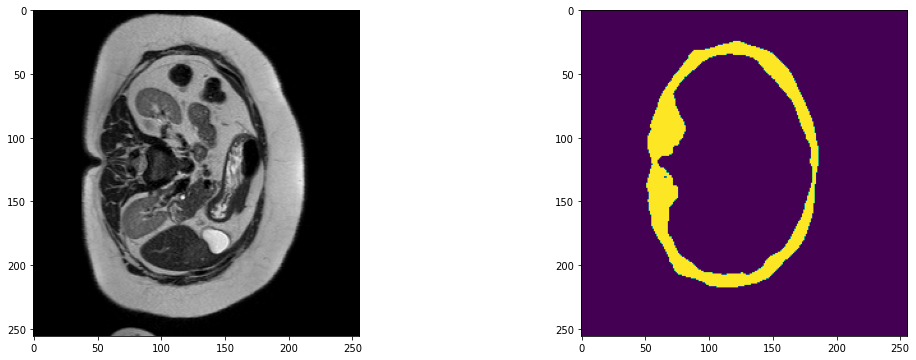

2023-07-17 11:39:40,584 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v5_T2W_seg.nii.gz


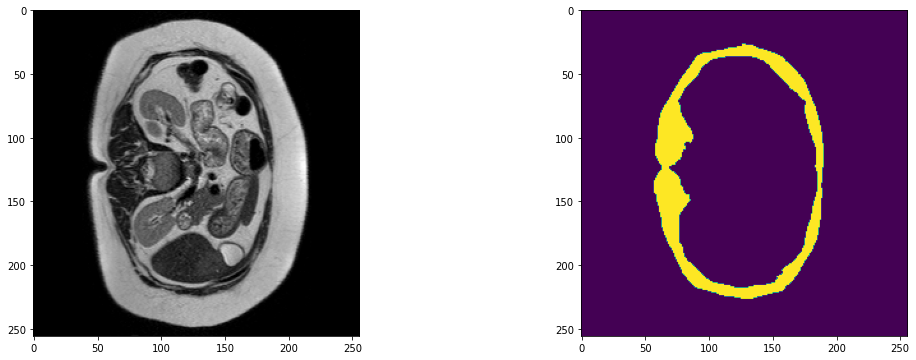

2023-07-17 11:39:43,552 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A055_v6_T2W_seg.nii.gz


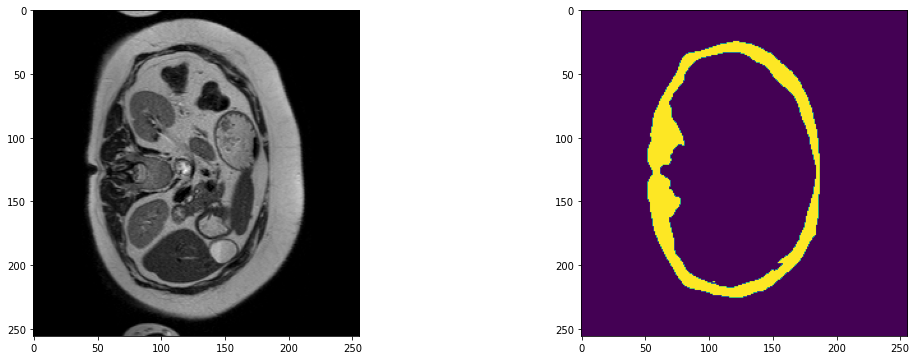

2023-07-17 11:39:46,508 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v1_T2W_seg.nii.gz


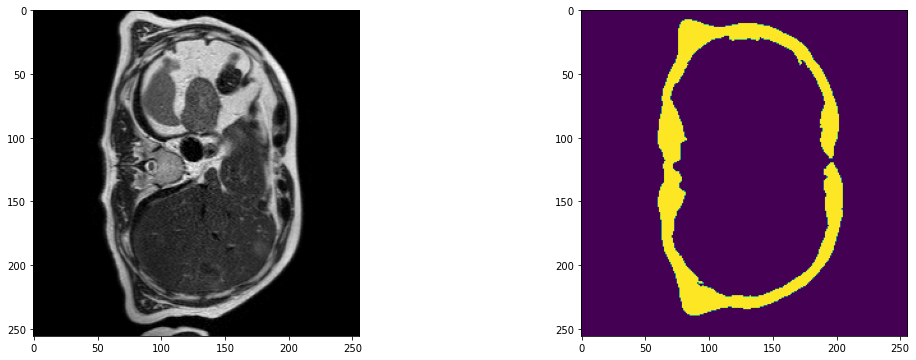

2023-07-17 11:39:49,455 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v2_T2W_seg.nii.gz


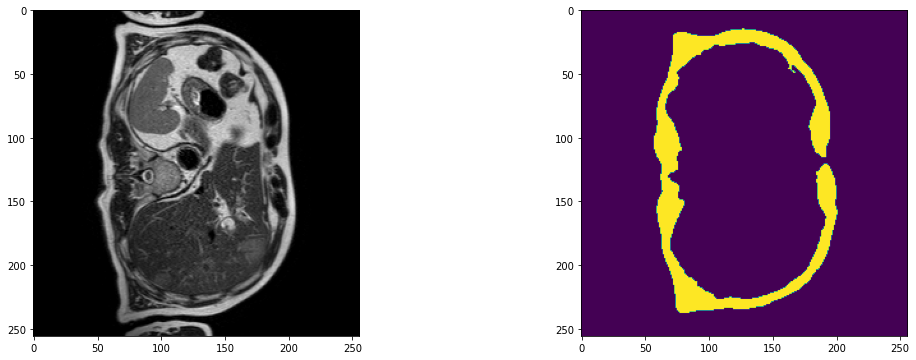

2023-07-17 11:39:52,394 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v3_T2W_seg.nii.gz


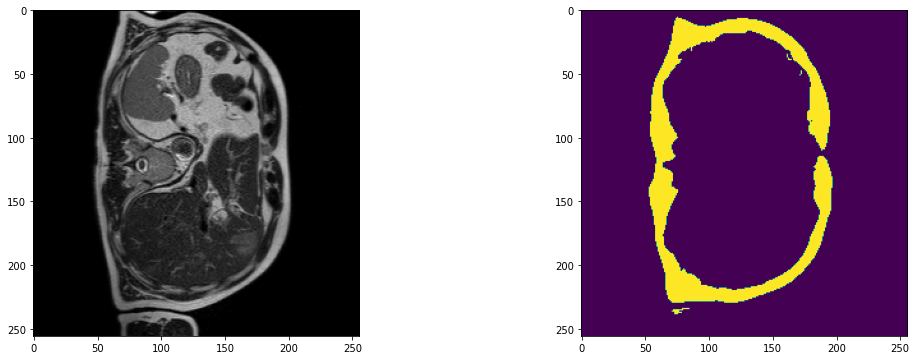

2023-07-17 11:39:55,321 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v4_T2W_seg.nii.gz


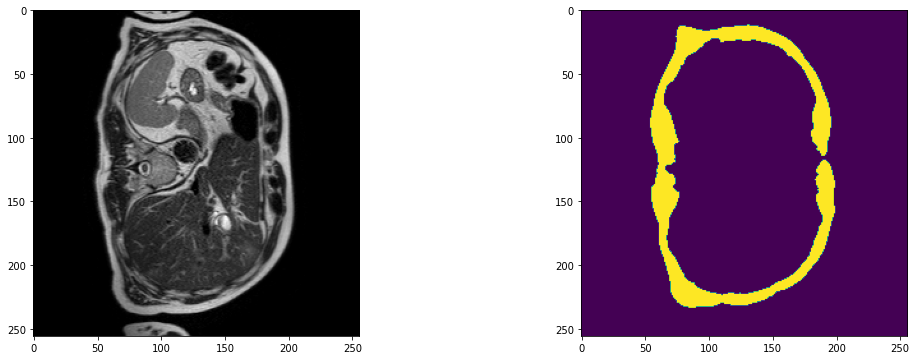

2023-07-17 11:39:58,260 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v5_T2W_seg.nii.gz


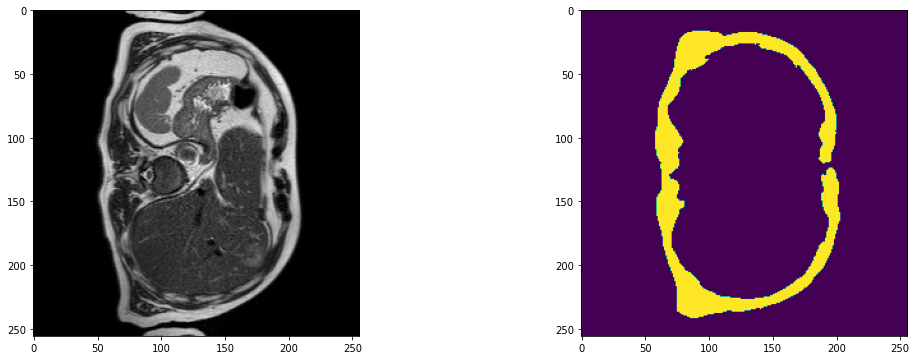

2023-07-17 11:40:01,193 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v6_T2W_seg.nii.gz


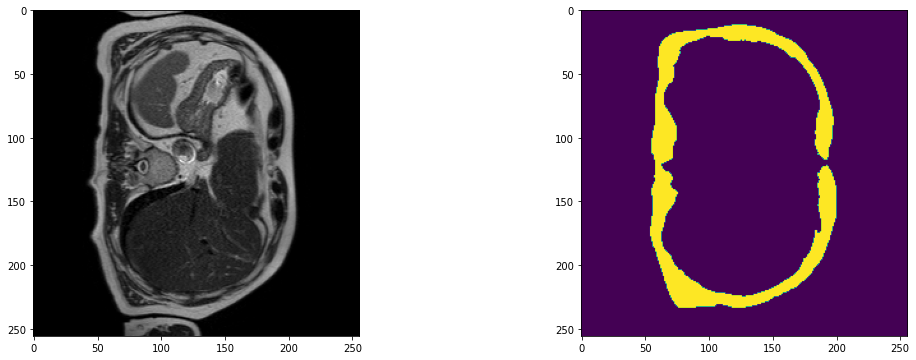

2023-07-17 11:40:04,139 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A056_v7_T2W_seg.nii.gz


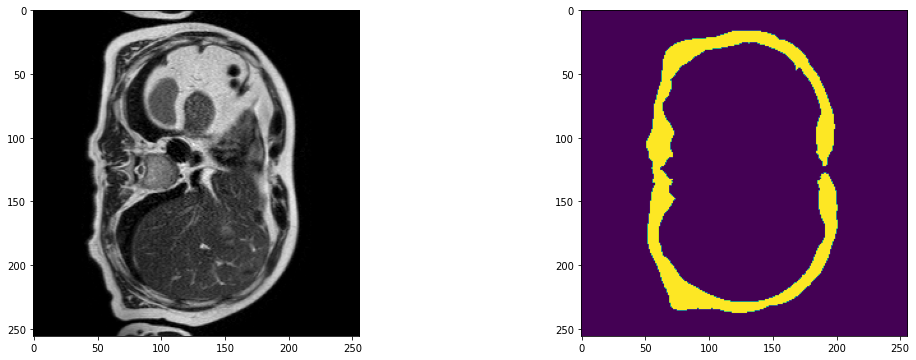

2023-07-17 11:40:07,096 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v1_T2W_seg.nii.gz


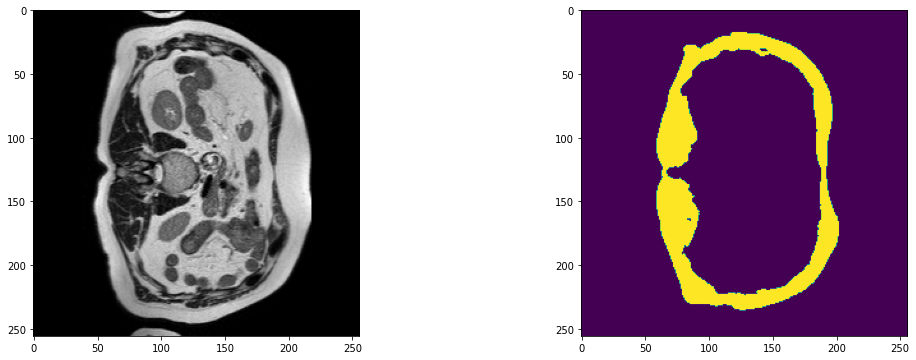

2023-07-17 11:40:10,052 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v2_T2W_seg.nii.gz


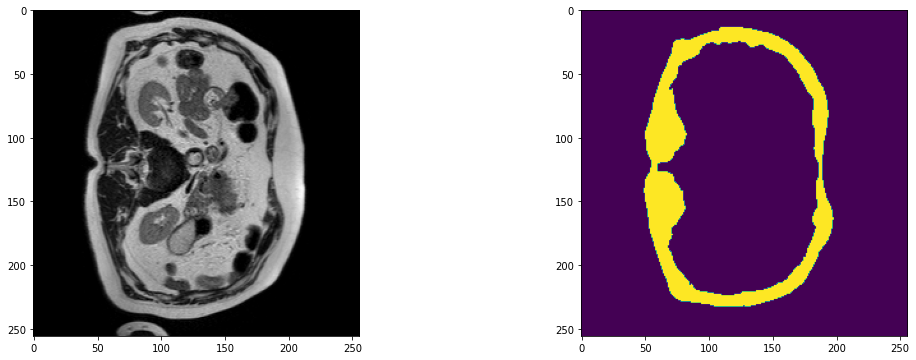

2023-07-17 11:40:12,995 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v3_T2W_seg.nii.gz


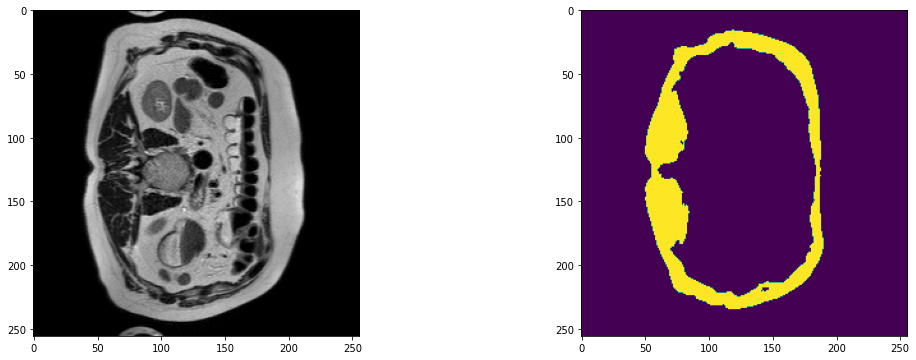

2023-07-17 11:40:15,942 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v4_T2W_seg.nii.gz


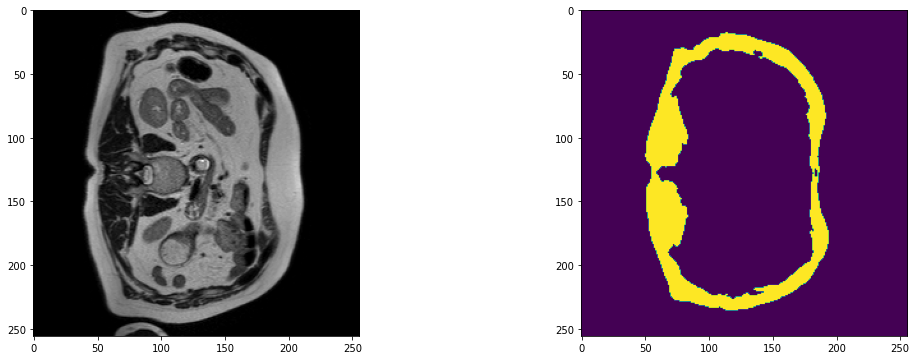

2023-07-17 11:40:19,034 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v5_T2W_seg.nii.gz


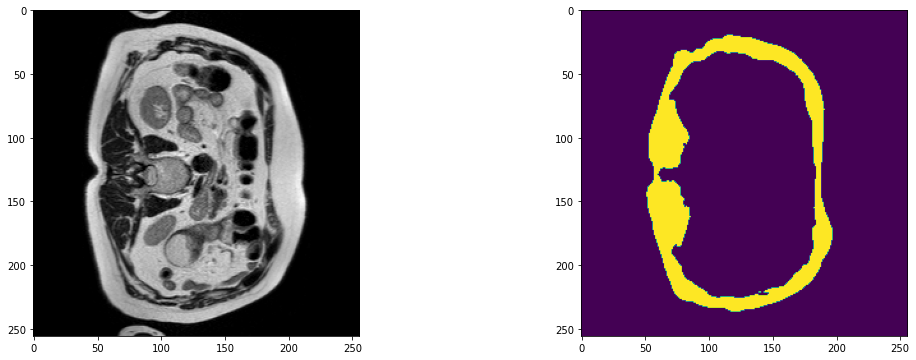

2023-07-17 11:40:21,982 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A057_v6_T2W_seg.nii.gz


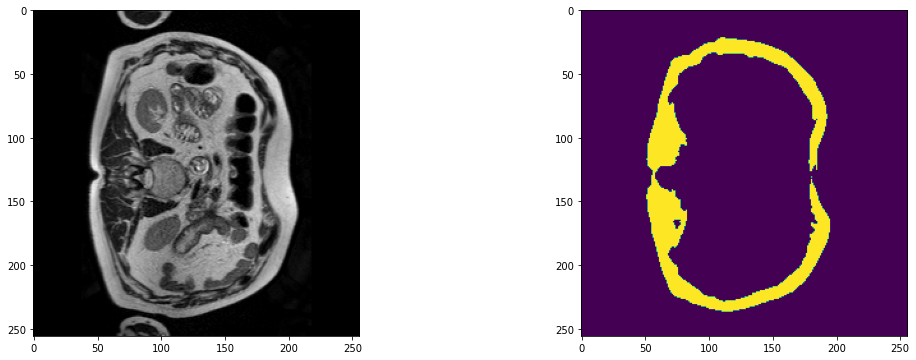

2023-07-17 11:40:30,633 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A061_v1_T2W_seg.nii.gz


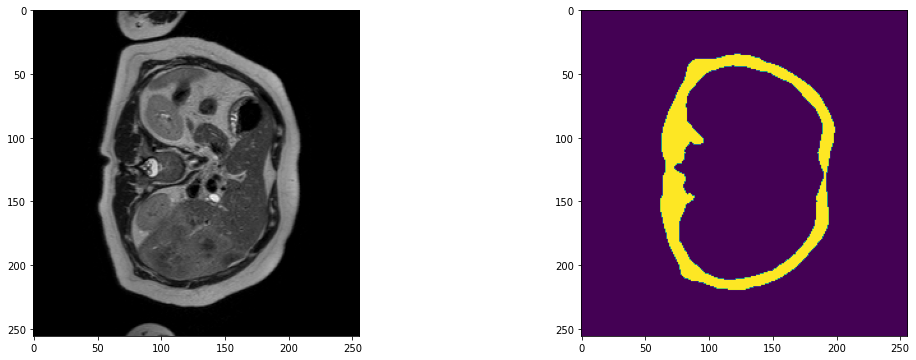

2023-07-17 11:40:39,301 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A061_v2_T2W_seg.nii.gz


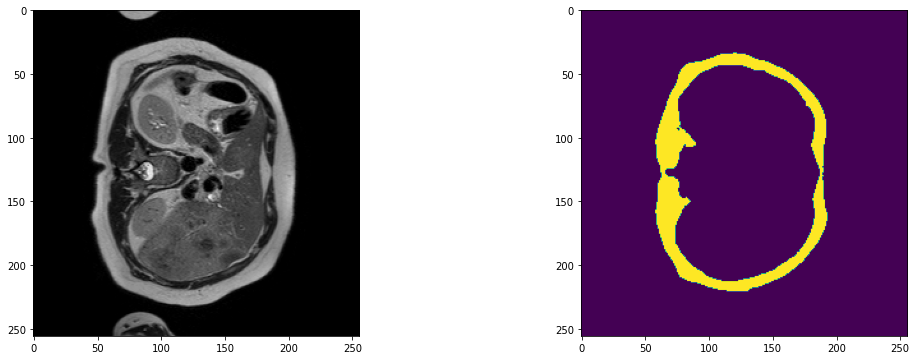

2023-07-17 11:40:47,980 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A061_v3_T2W_seg.nii.gz


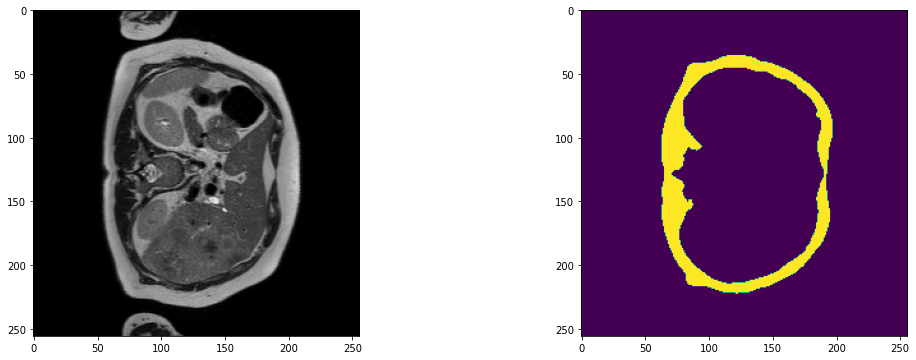

2023-07-17 11:40:56,658 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A061_v4_T2W_seg.nii.gz


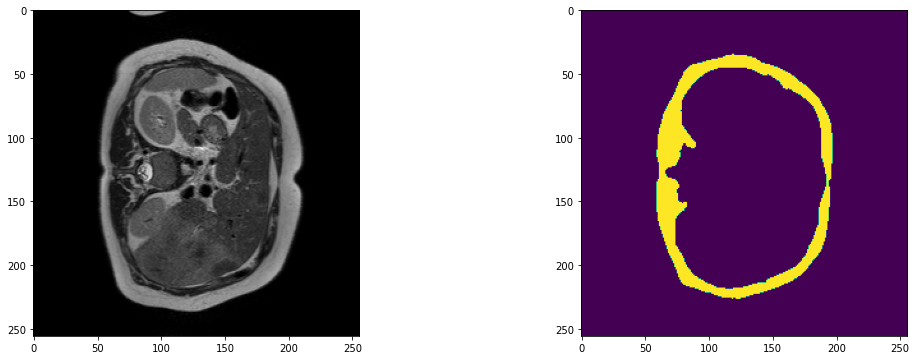

2023-07-17 11:41:05,346 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A061_v5_T2W_seg.nii.gz


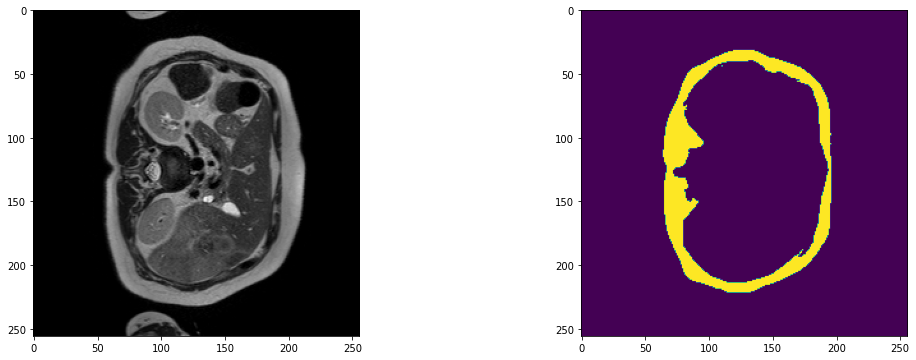

2023-07-17 11:41:07,909 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A062_v1_T2W_seg.nii.gz


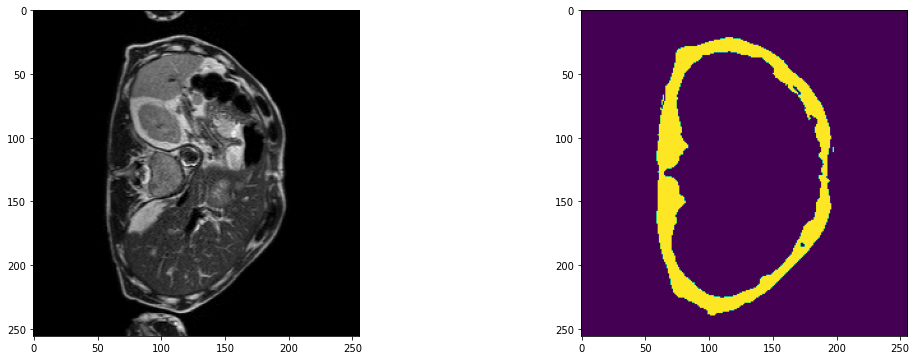

2023-07-17 11:41:10,480 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A062_v2_T2W_seg.nii.gz


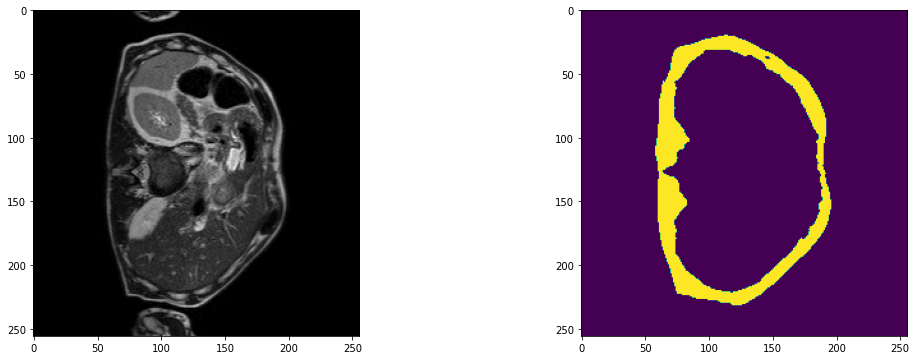

2023-07-17 11:41:13,061 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A062_v3_T2W_seg.nii.gz


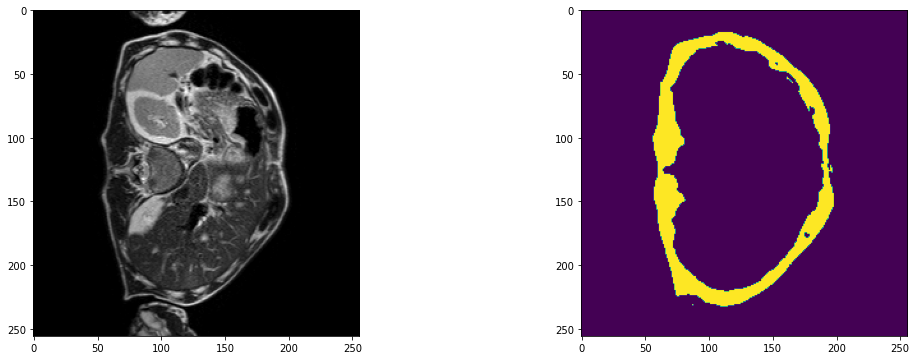

2023-07-17 11:41:16,011 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A062_v4_T2W_seg.nii.gz


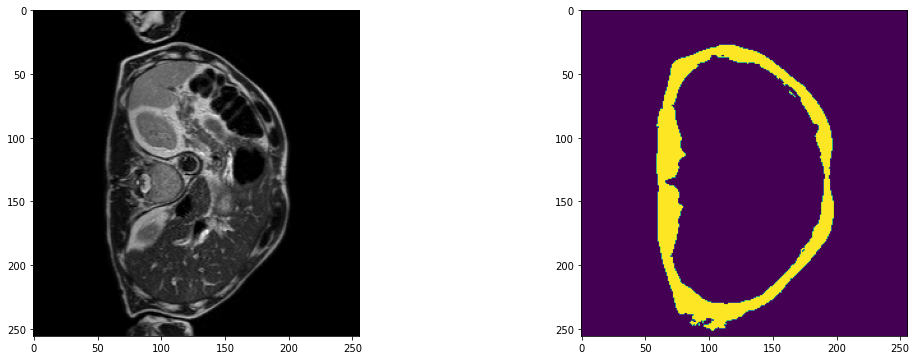

2023-07-17 11:41:18,584 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A062_v5_T2W_seg.nii.gz


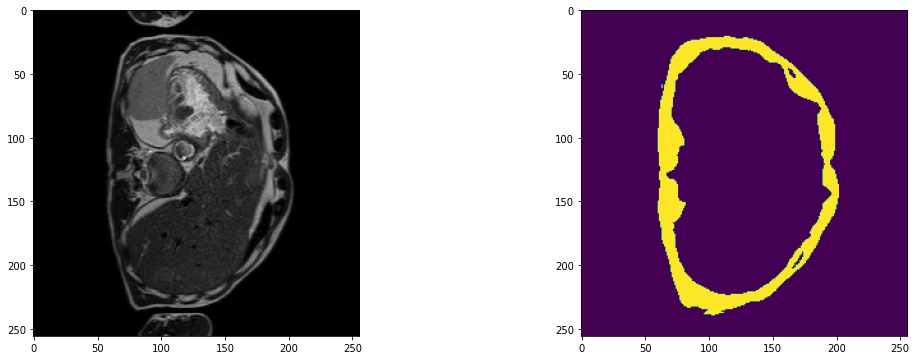

2023-07-17 11:41:21,580 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v1_T2W_seg.nii.gz


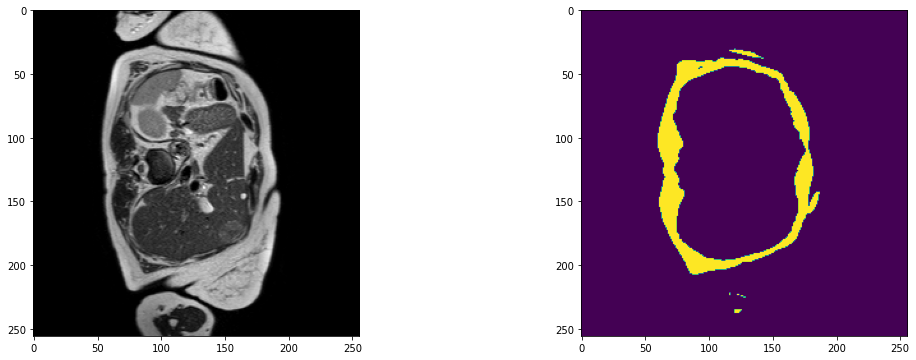

2023-07-17 11:41:24,661 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v2_T2W_seg.nii.gz


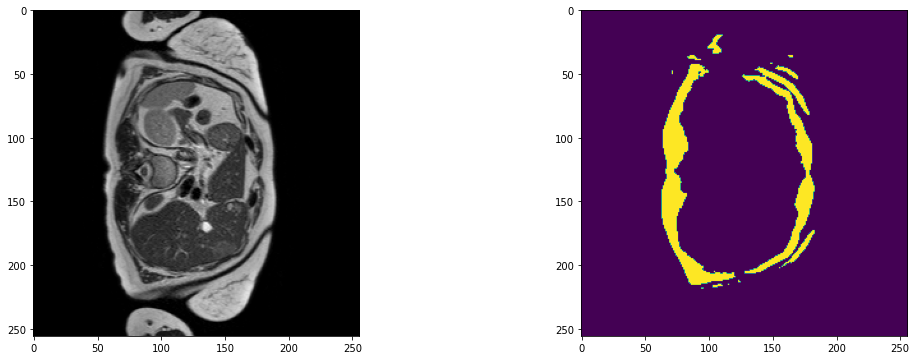

2023-07-17 11:41:27,609 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v3_T2W_seg.nii.gz


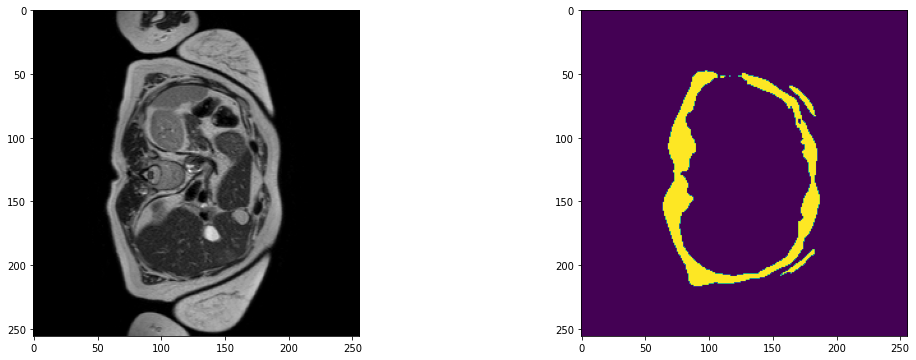

2023-07-17 11:41:30,555 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v4_T2W_seg.nii.gz


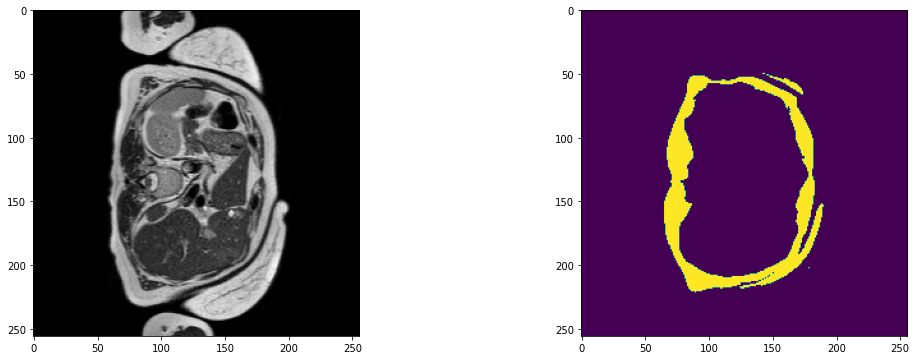

2023-07-17 11:41:33,111 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v5_T2W_seg.nii.gz


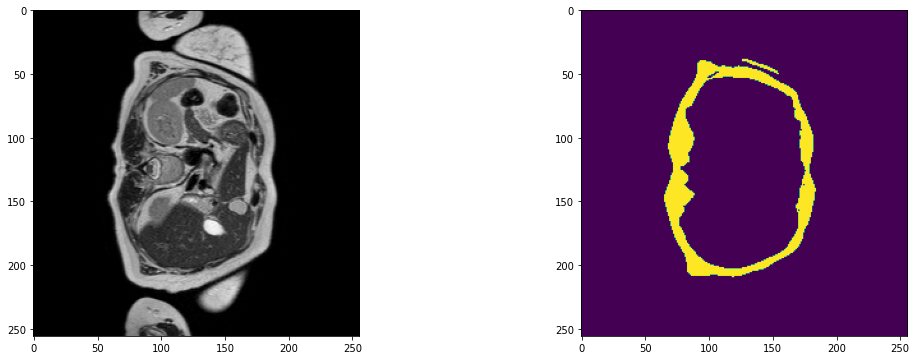

2023-07-17 11:41:35,667 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v6_T2W_seg.nii.gz


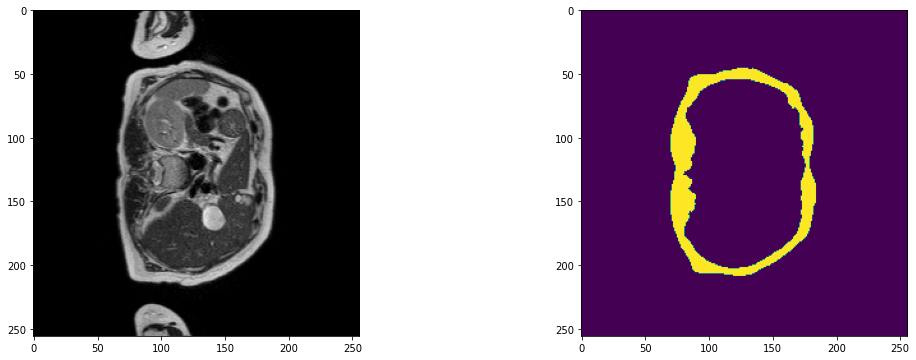

2023-07-17 11:41:38,234 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v7_T2W_seg.nii.gz


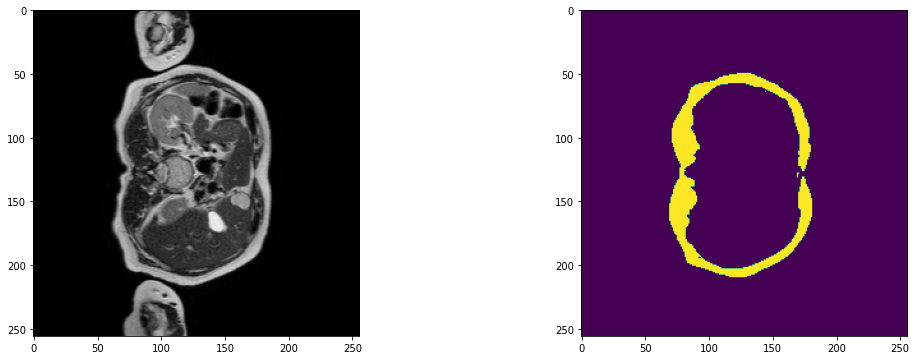

2023-07-17 11:41:40,801 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v8_T2W_seg.nii.gz


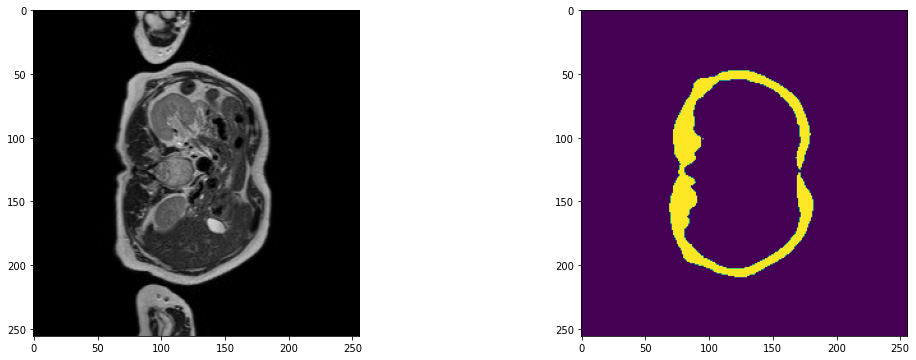

2023-07-17 11:41:43,719 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A063_v9_T2W_seg.nii.gz


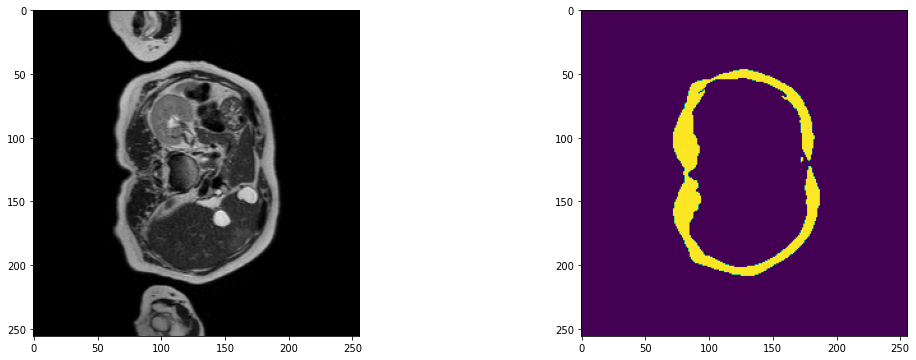

2023-07-17 11:41:46,671 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v1_T2W_seg.nii.gz


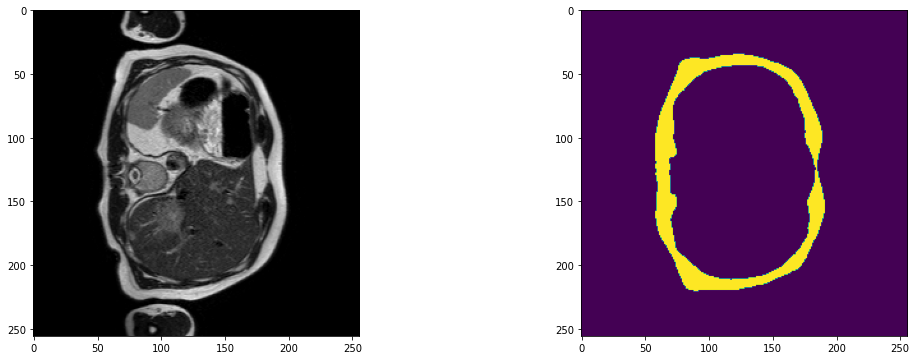

2023-07-17 11:41:49,620 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v2_T2W_seg.nii.gz


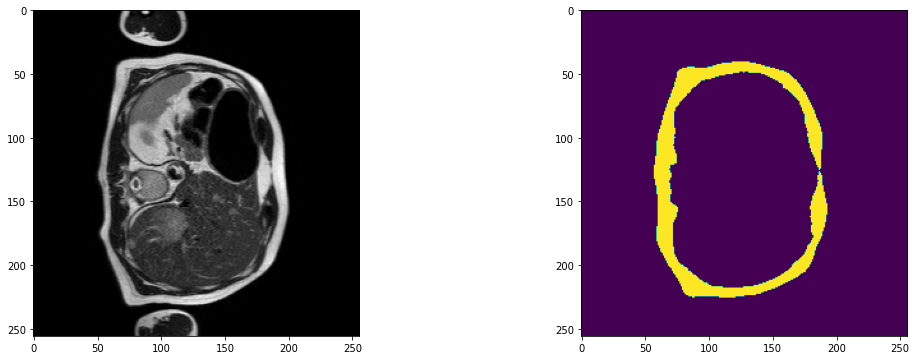

2023-07-17 11:41:52,551 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v3_T2W_seg.nii.gz


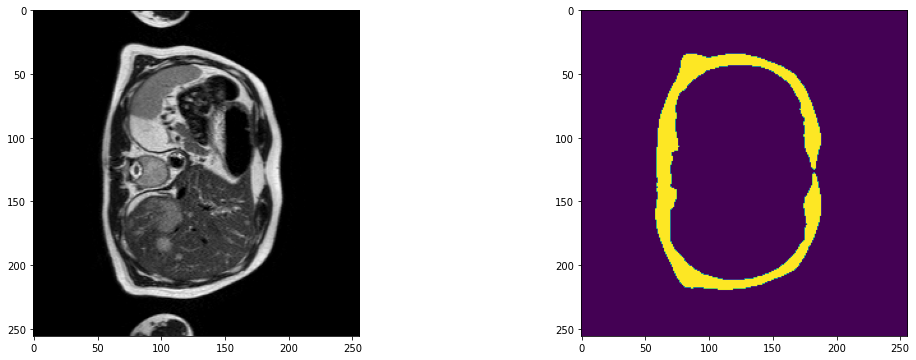

2023-07-17 11:41:55,482 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v4_T2W_seg.nii.gz


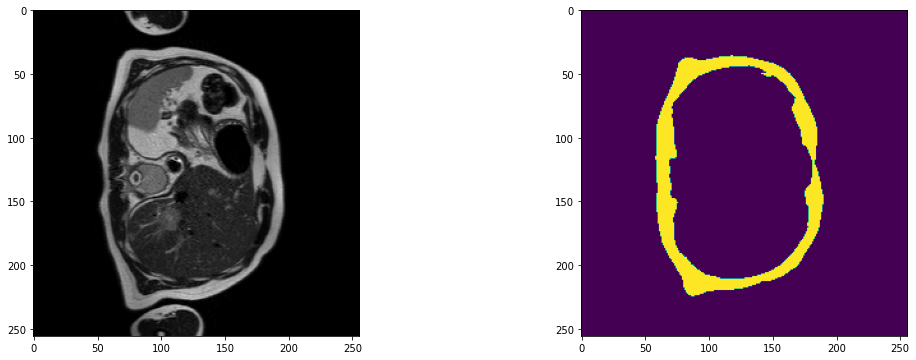

2023-07-17 11:41:58,426 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v5_T2W_seg.nii.gz


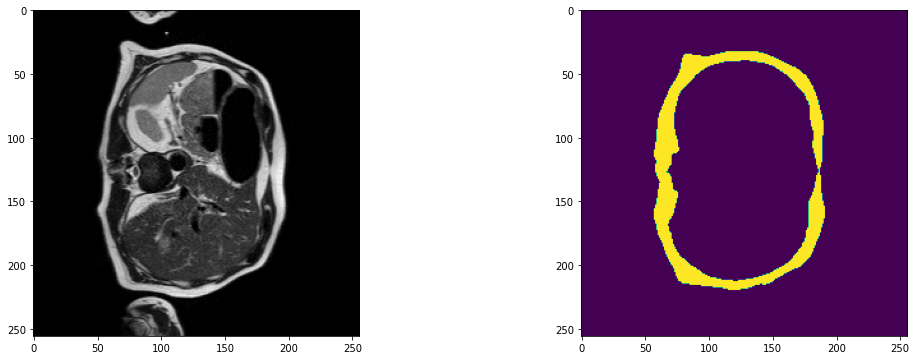

2023-07-17 11:42:01,512 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v6_T2W_seg.nii.gz


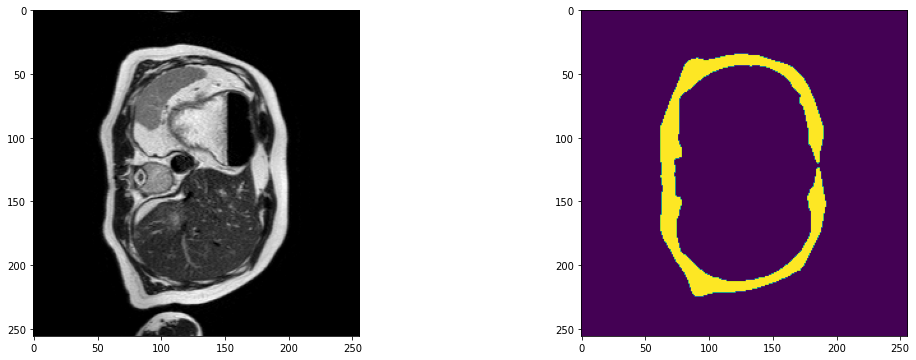

2023-07-17 11:42:04,444 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v7_T2W_seg.nii.gz


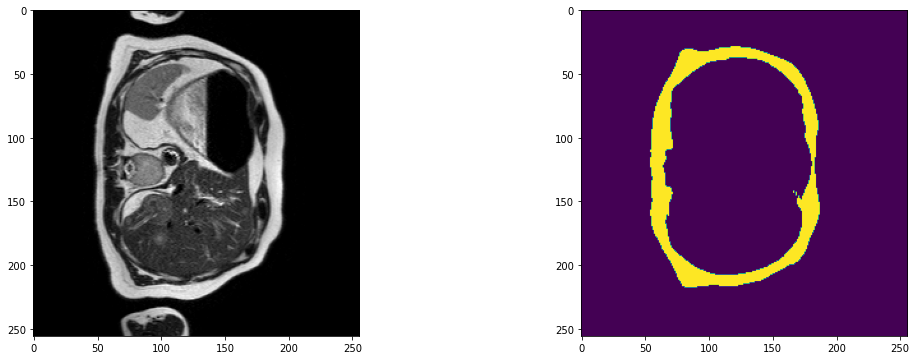

2023-07-17 11:42:07,392 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A064_v8_T2W_seg.nii.gz


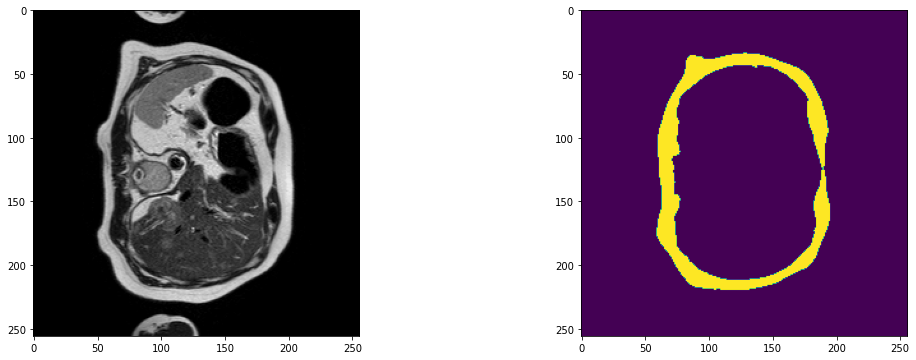

2023-07-17 11:42:10,339 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v1_T2W_seg.nii.gz


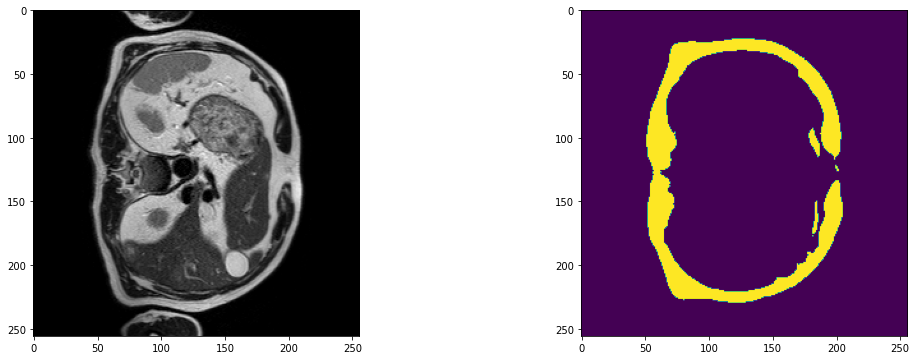

2023-07-17 11:42:13,283 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v2_T2W_seg.nii.gz


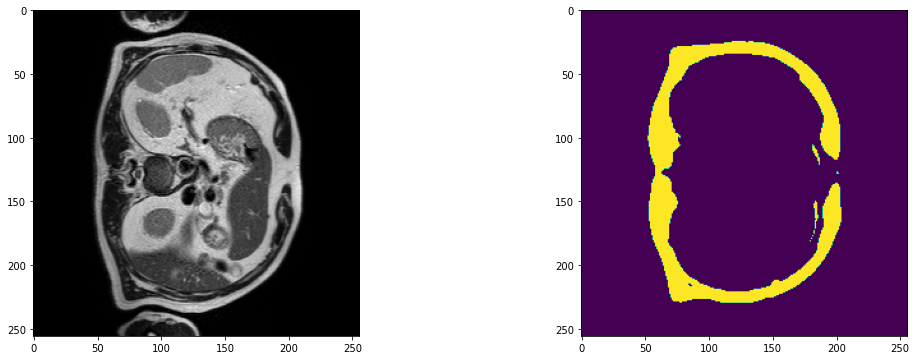

2023-07-17 11:42:16,243 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v3_T2W_seg.nii.gz


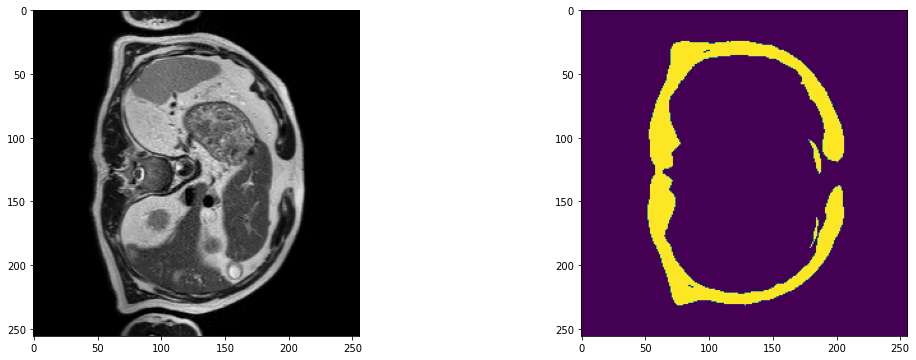

2023-07-17 11:42:19,201 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v4_T2W_seg.nii.gz


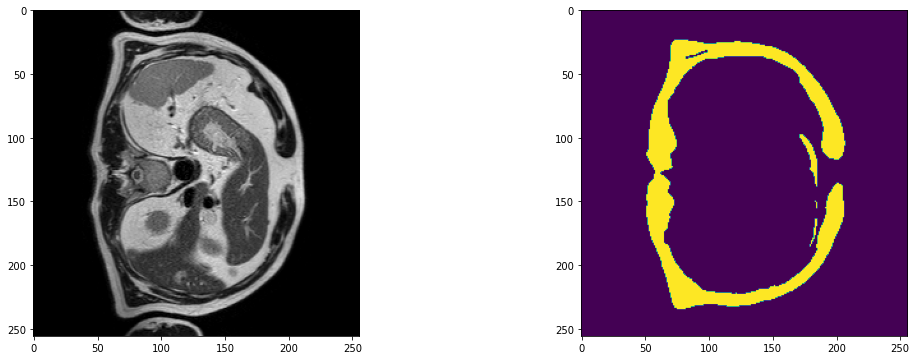

2023-07-17 11:42:22,167 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v5_T2W_seg.nii.gz


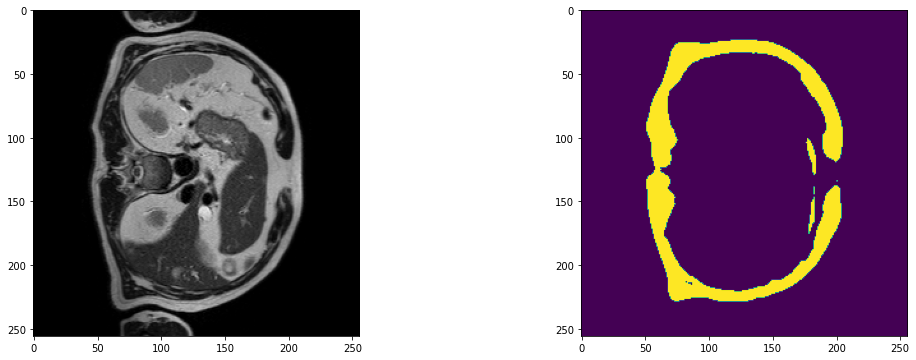

2023-07-17 11:42:25,152 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A066_v6_T2W_seg.nii.gz


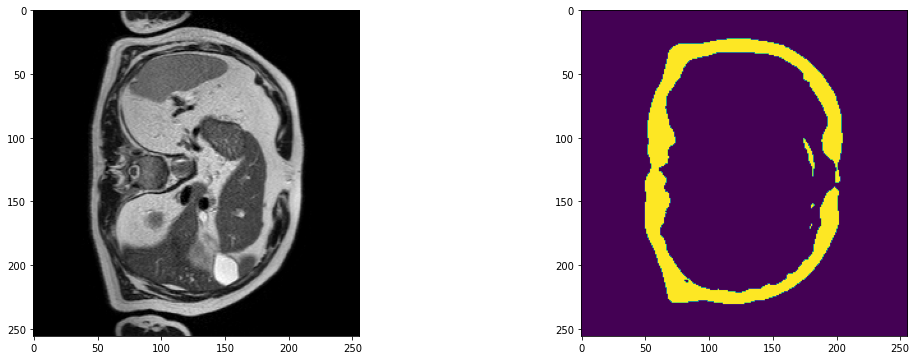

2023-07-17 11:42:28,095 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v1_T2W_seg.nii.gz


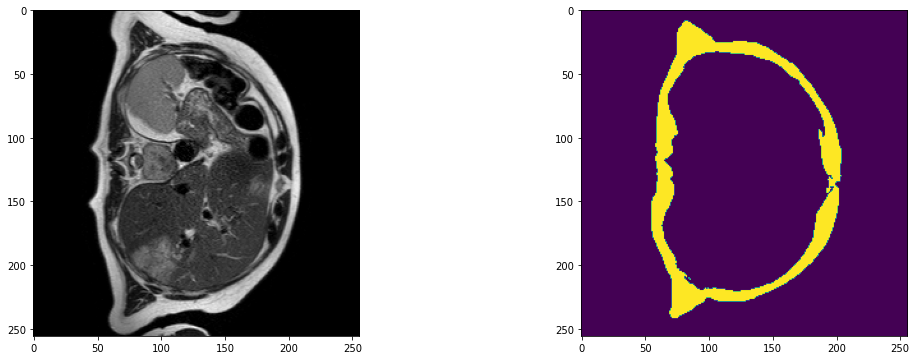

2023-07-17 11:42:31,073 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v2_T2W_seg.nii.gz


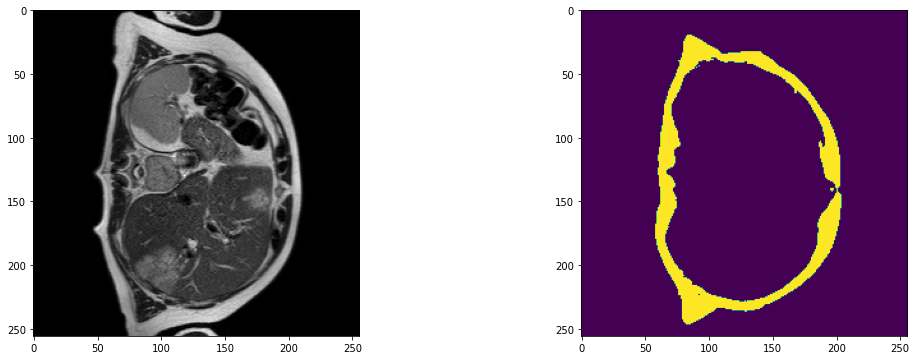

2023-07-17 11:42:34,039 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v3_T2W_seg.nii.gz


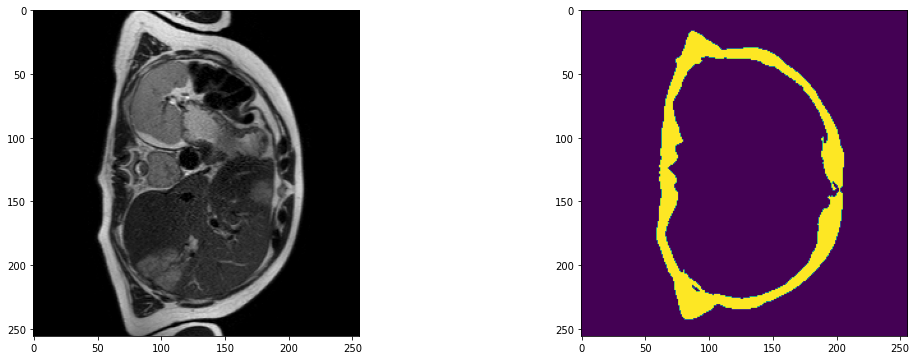

2023-07-17 11:42:36,982 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v4_T2W_seg.nii.gz


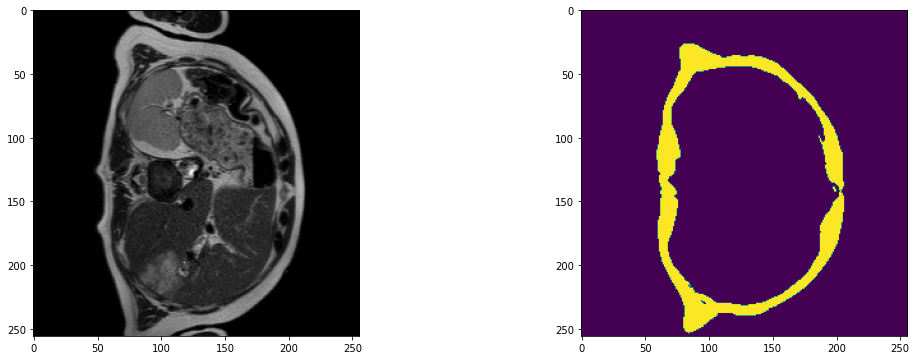

2023-07-17 11:42:40,052 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v5_T2W_seg.nii.gz


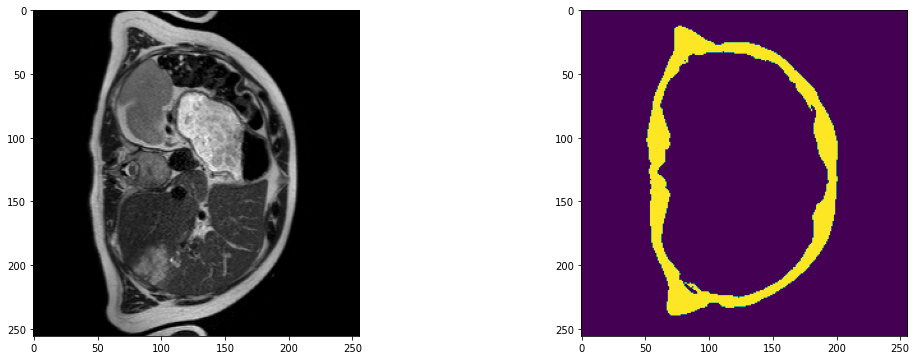

2023-07-17 11:42:42,990 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A067_v6_T2W_seg.nii.gz


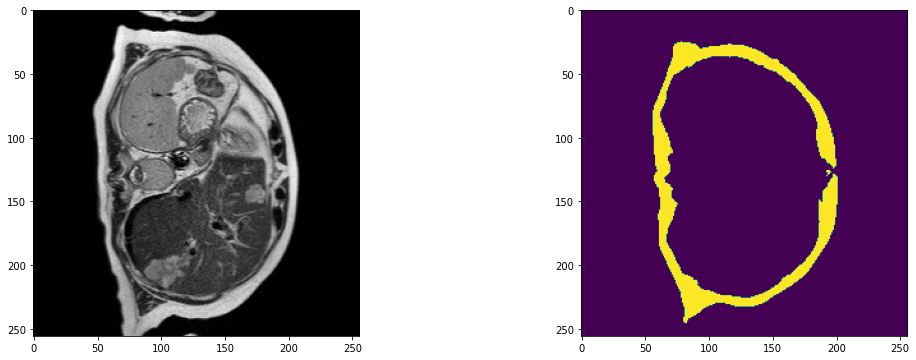

2023-07-17 11:42:45,378 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v1_T2W_seg.nii.gz


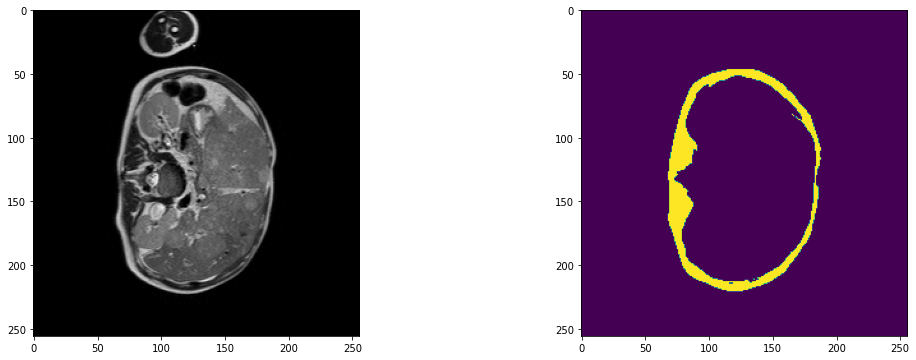

2023-07-17 11:42:47,936 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v2_T2W_seg.nii.gz


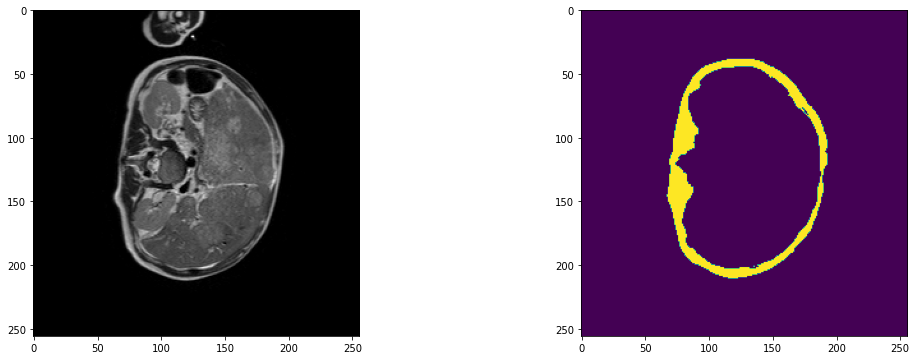

2023-07-17 11:42:50,484 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v3_T2W_seg.nii.gz


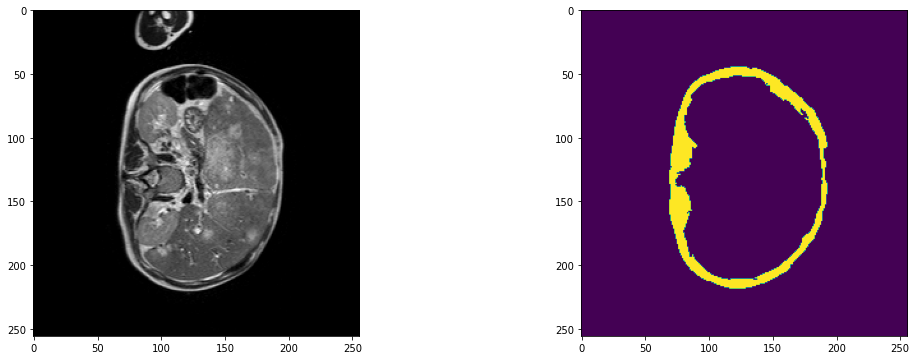

2023-07-17 11:42:53,035 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v4_T2W_seg.nii.gz


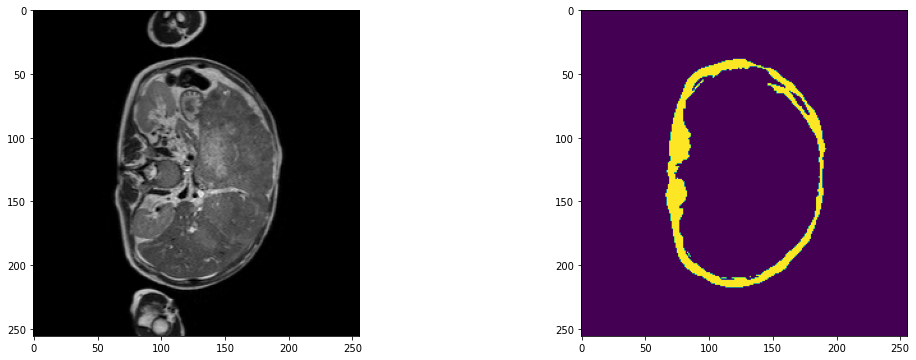

2023-07-17 11:42:55,588 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v5_T2W_seg.nii.gz


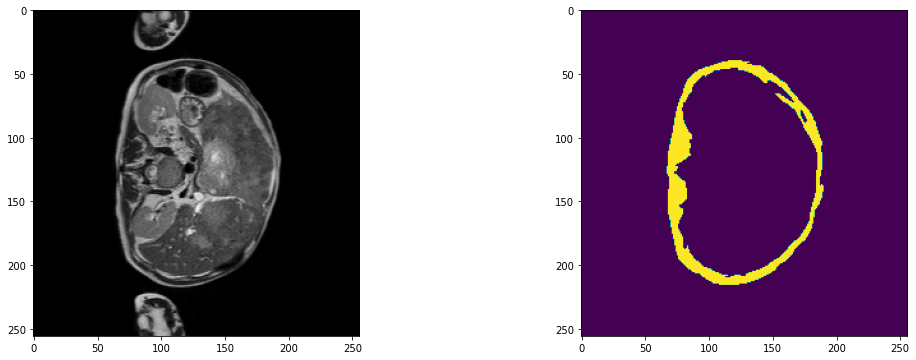

2023-07-17 11:42:58,166 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v6_T2W_seg.nii.gz


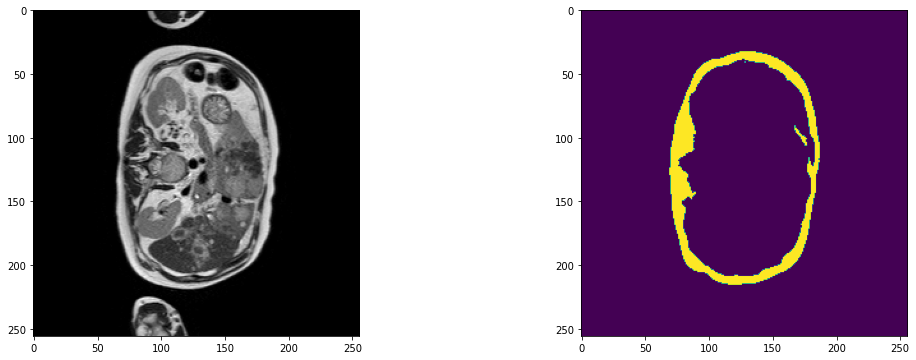

2023-07-17 11:43:01,098 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v7_T2W_seg.nii.gz


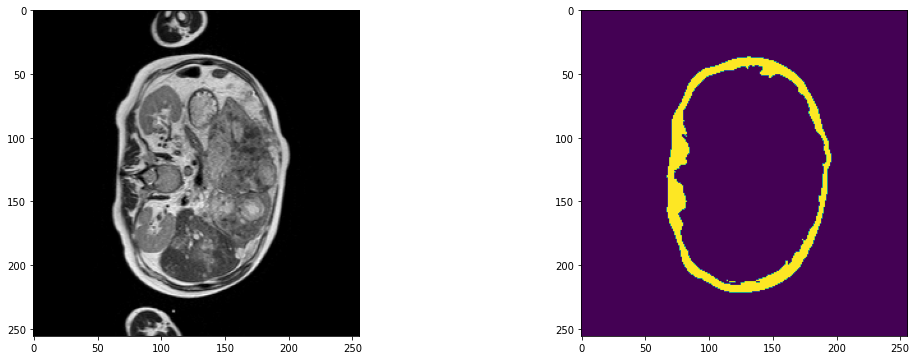

2023-07-17 11:43:03,676 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v8_T2W_seg.nii.gz


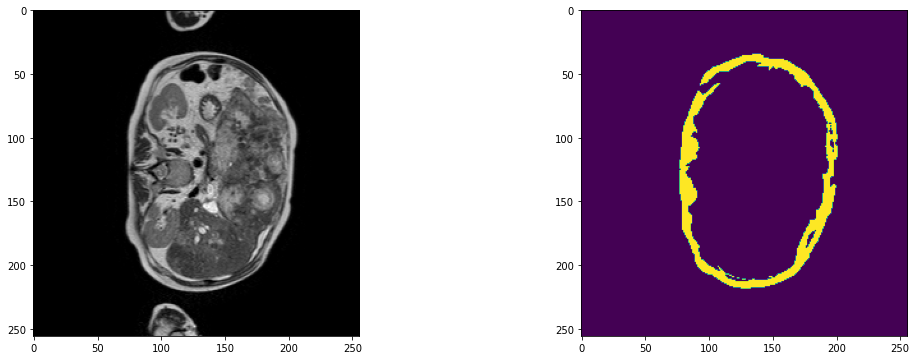

2023-07-17 11:43:06,616 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A068_v9_T2W_seg.nii.gz


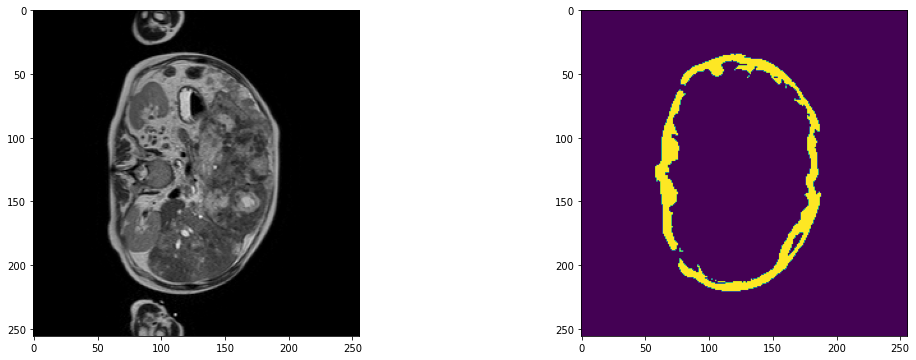

2023-07-17 11:43:13,956 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v1_T2W_seg.nii.gz


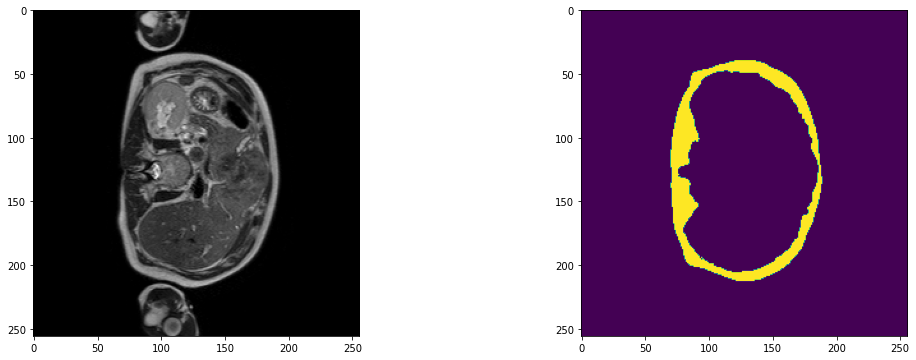

2023-07-17 11:43:21,315 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v2_T2W_seg.nii.gz


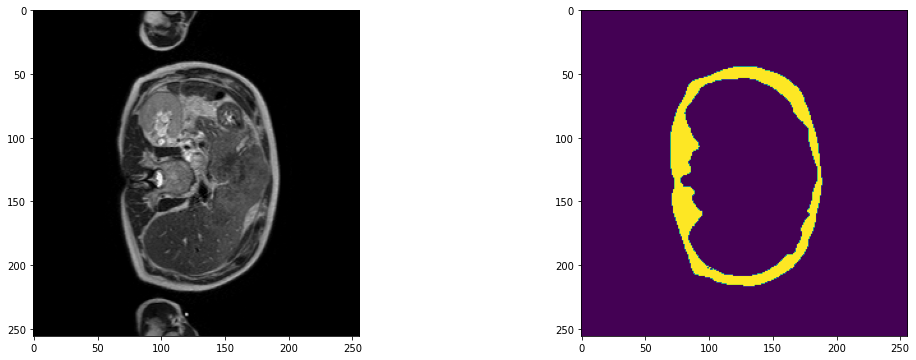

2023-07-17 11:43:28,796 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v3_T2W_seg.nii.gz


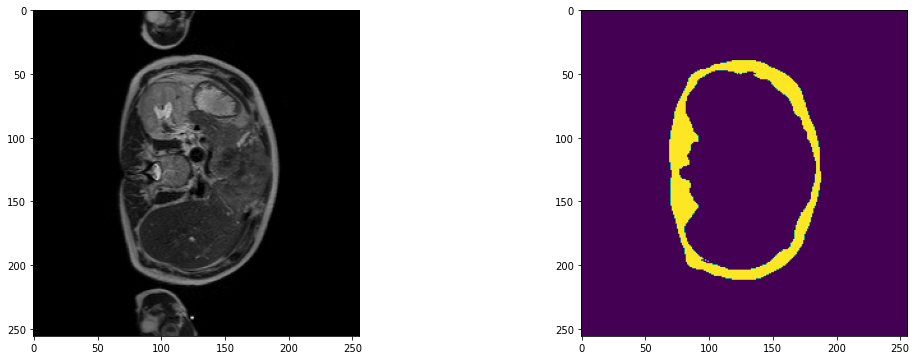

2023-07-17 11:43:37,467 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v4_T2W_seg.nii.gz


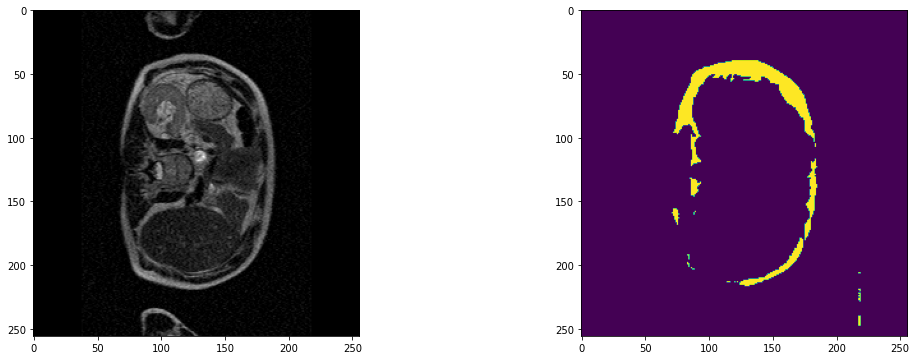

2023-07-17 11:43:44,797 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v5_T2W_seg.nii.gz


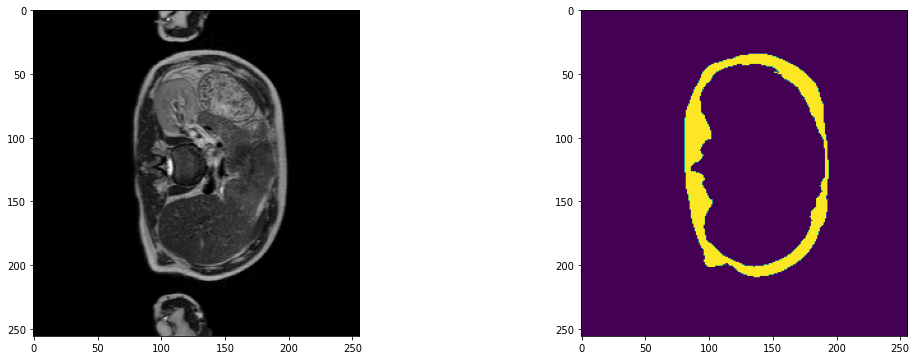

2023-07-17 11:43:52,146 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v6_T2W_seg.nii.gz


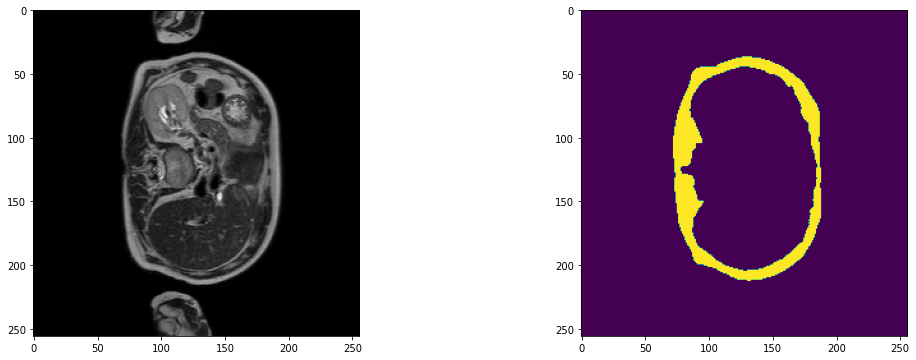

2023-07-17 11:43:59,491 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v7_T2W_seg.nii.gz


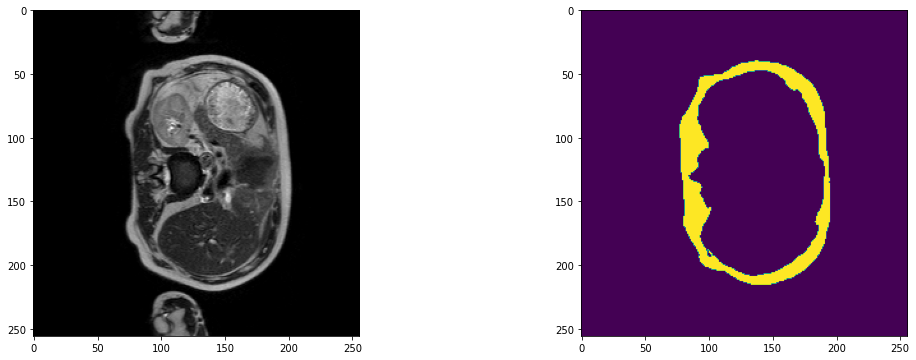

2023-07-17 11:44:06,849 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A071_v9_T2W_seg.nii.gz


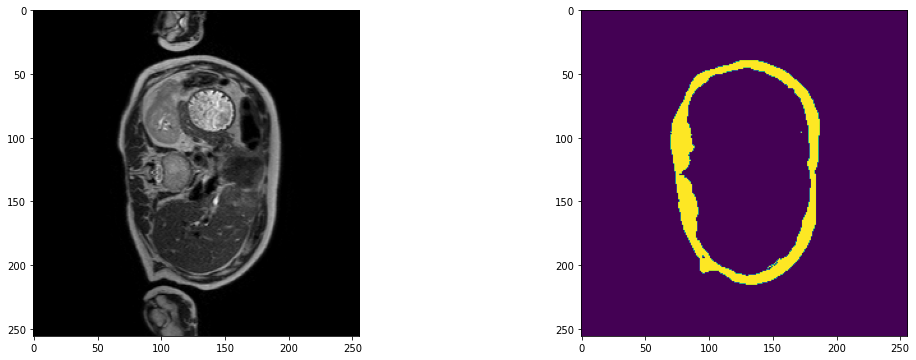

2023-07-17 11:44:14,216 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v1_T2W_seg.nii.gz


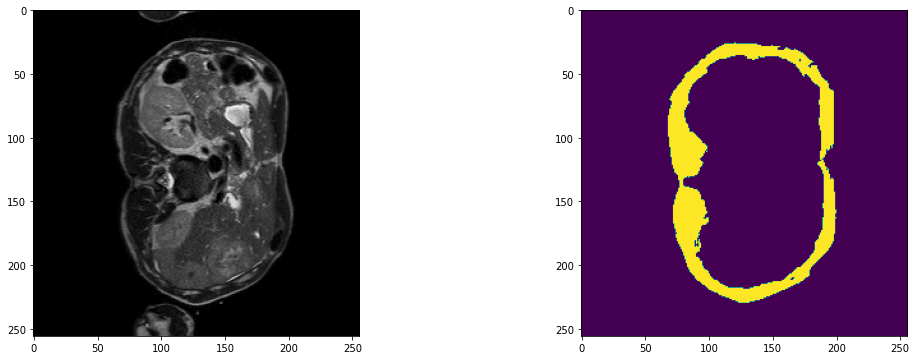

2023-07-17 11:44:22,927 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v2_T2W_seg.nii.gz


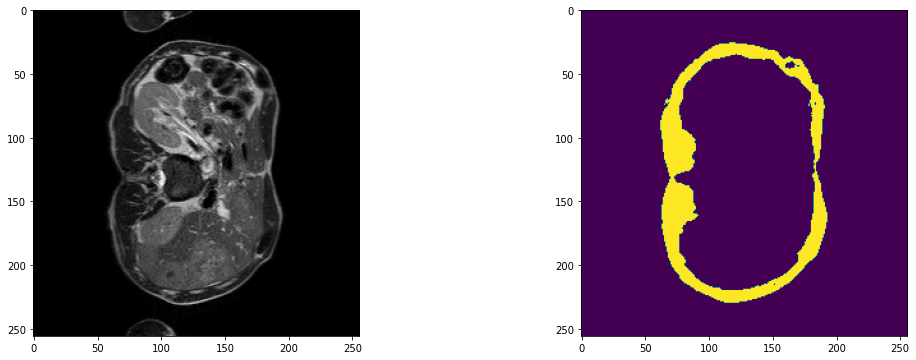

2023-07-17 11:44:31,607 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v3_T2W_seg.nii.gz


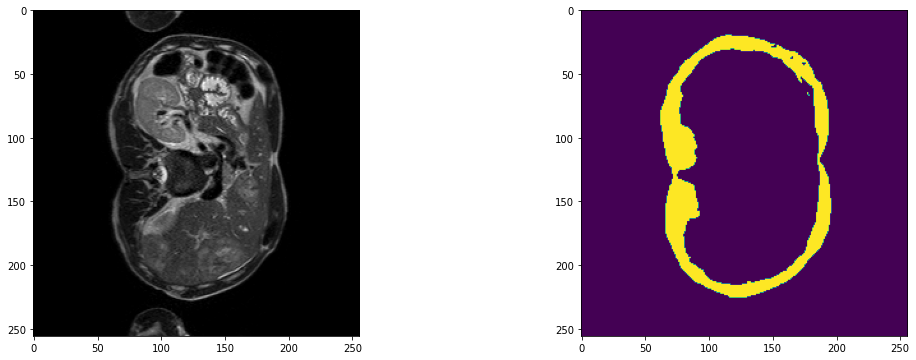

2023-07-17 11:44:38,988 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v4_T2W_seg.nii.gz


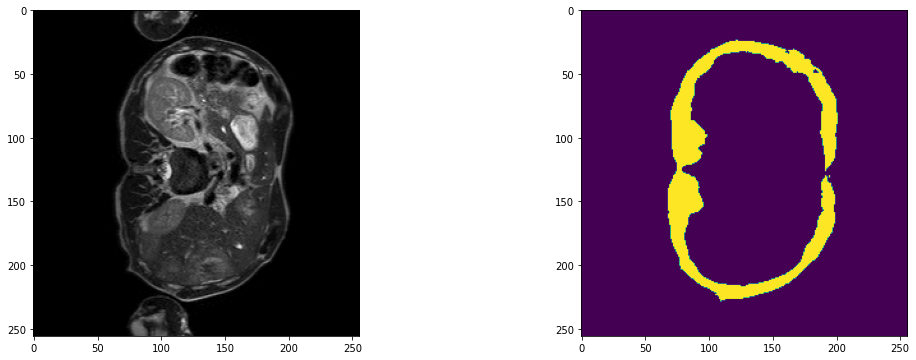

2023-07-17 11:44:46,340 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v5_T2W_seg.nii.gz


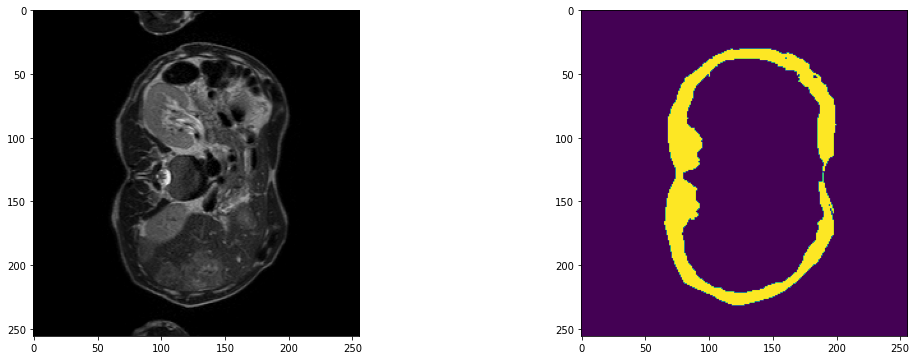

2023-07-17 11:44:53,691 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v6_T2W_seg.nii.gz


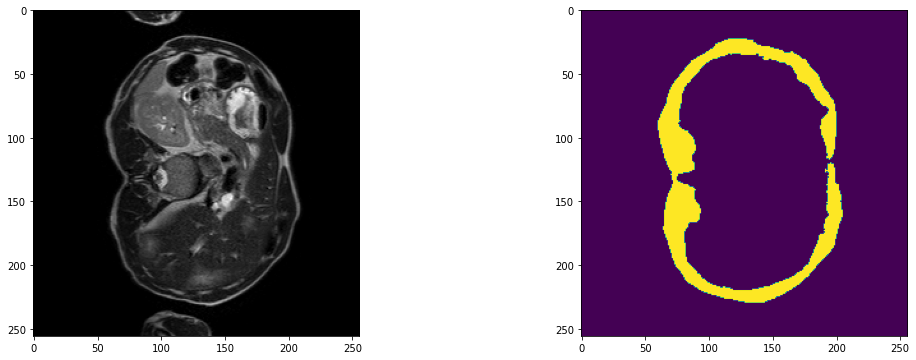

2023-07-17 11:45:02,357 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A074_v7_T2W_seg.nii.gz


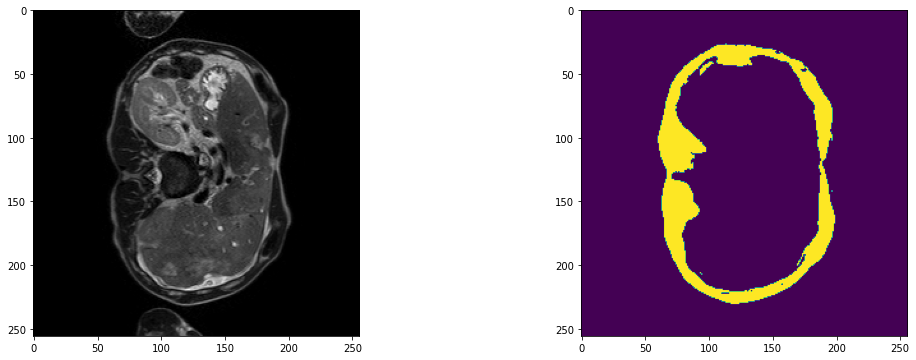

2023-07-17 11:45:05,054 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v1_T2W_seg.nii.gz


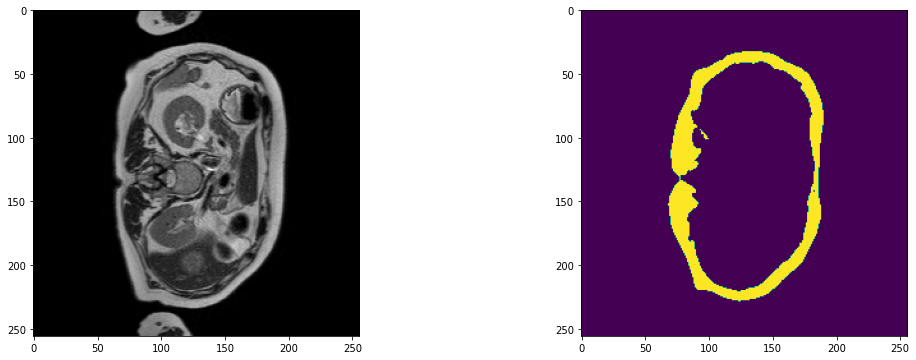

2023-07-17 11:45:08,017 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v2_T2W_seg.nii.gz


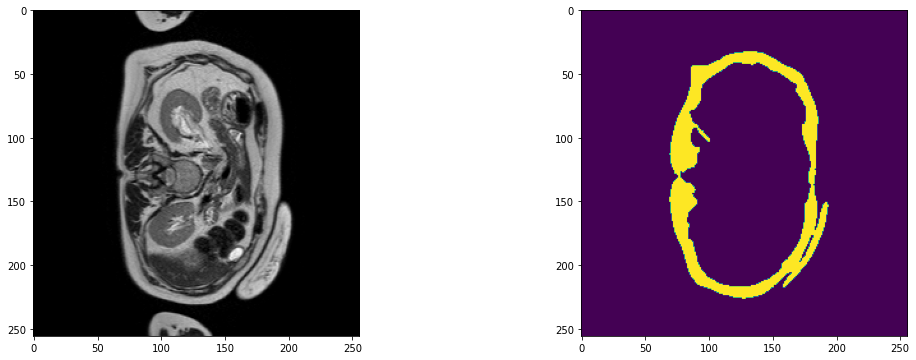

2023-07-17 11:45:10,581 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v3_T2W_seg.nii.gz


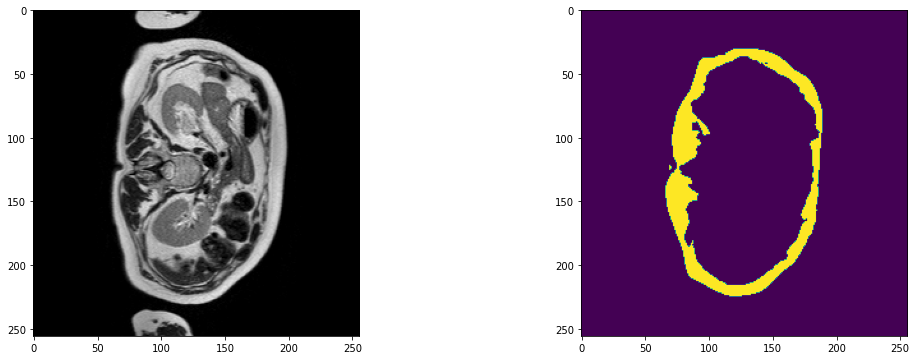

2023-07-17 11:45:13,530 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v4_T2W_seg.nii.gz


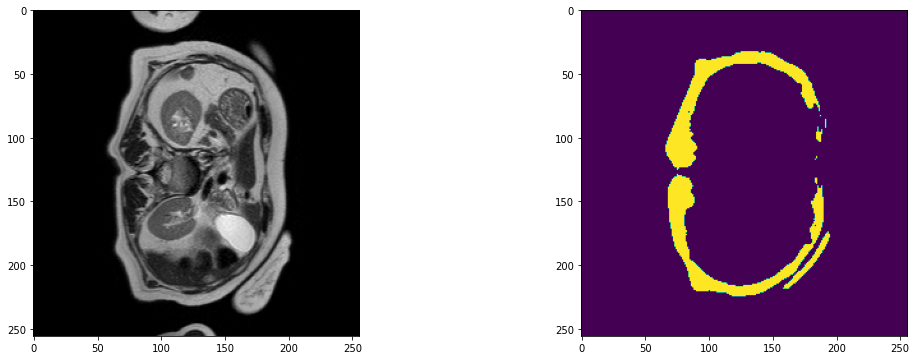

2023-07-17 11:45:16,475 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v5_T2W_seg.nii.gz


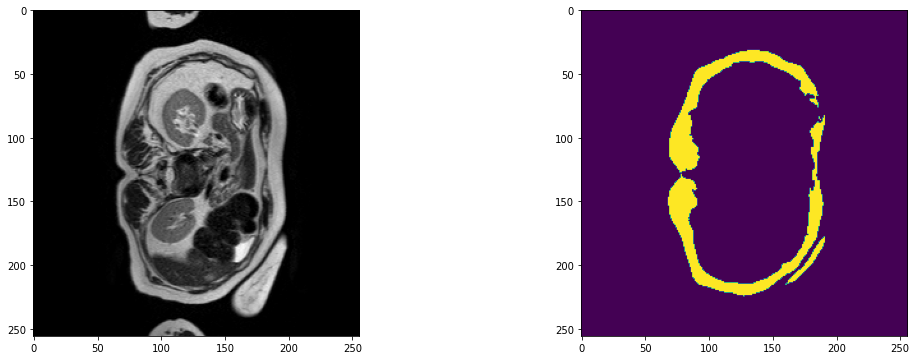

2023-07-17 11:45:19,445 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v6_T2W_seg.nii.gz


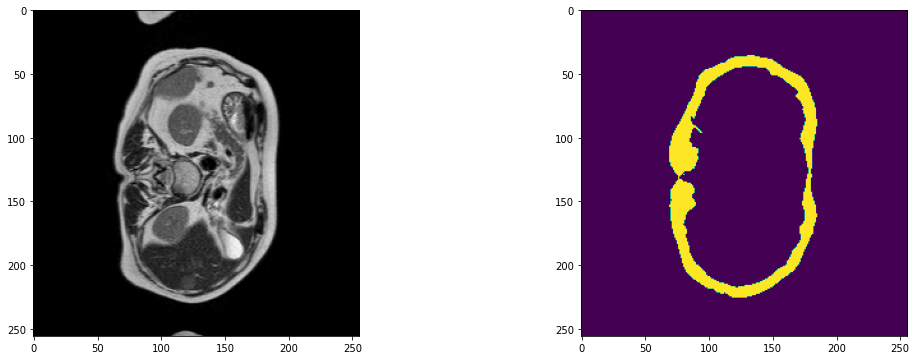

2023-07-17 11:45:22,391 INFO image_writer.py:194 - writing: outMR02_Jul23_plotcohorts/A076_v7_T2W_seg.nii.gz


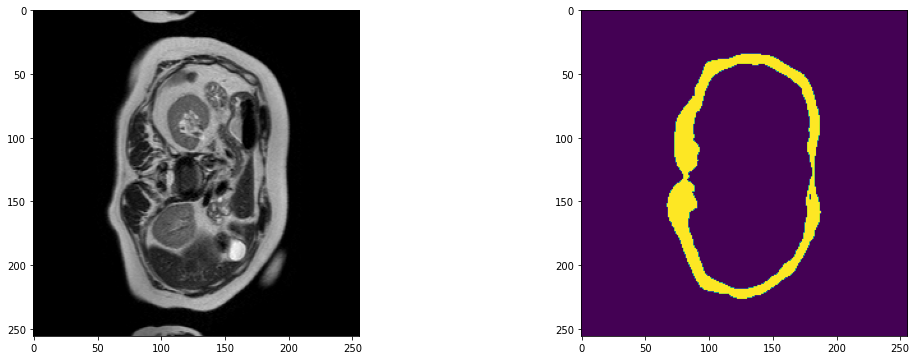

In [10]:
# # uncomment the following lines to visualize the predicted results
from monai.transforms import LoadImage
loader = LoadImage()

model.load_state_dict(torch.load(
    os.path.join(data_dir, "best_metric_model_multiclassUNetR_MR02_May23.pth")))
model.eval()

with torch.no_grad():
    for test_data in test_org_loader:
        test_inputs = test_data["image"].to(device)
        roi_size = (96, 96, 48)
        sw_batch_size = 4
        test_data["pred"] = sliding_window_inference(
            test_inputs, roi_size, sw_batch_size, model, overlap=0.8)

        test_data = [post_transforms(i) for i in decollate_batch(test_data)]

#         # uncomment the following lines to visualize the predicted results
        test_output = from_engine(["pred"])(test_data)

        original_image = loader(test_data[0]["image_meta_dict"]["filename_or_obj"])[0]

        plt.figure("check", (18, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(original_image[:, :, 8], cmap="gray")
        plt.subplot(1, 2, 2)
        plt.imshow(test_output[0].detach().cpu()[5, :, :, 8])
        plt.show()

In [ ]:
# Testing code modified  (Based on validation block)

from monai.transforms import LoadImage
loader = LoadImage()

model.load_state_dict(torch.load(
    os.path.join(data_dir, "best_metric_model_multiclassUNetR_MR02_May23.pth")))
model.eval()

with torch.no_grad():
    for test_data in test_org_loader:
        test_inputs = test_data["image"].to(device)
        roi_size = (96, 96, 48)
        sw_batch_size = 4
        test_outputs = sliding_window_inference(
            test_inputs, roi_size, sw_batch_size, model, overlap=0.8
    )
#     plt.figure("check", (18, 6))
#     plt.subplot(1, 2, 1)
#     plt.title("image")
#     plt.imshow(test_inputs.cpu().numpy()[0, 0, :, :, 40], cmap="gray")
#     plt.subplot(1, 2, 2)
#     plt.title("output")
#     plt.imshow(
#         torch.argmax(test_outputs, dim=1).detach().cpu()[0, :, :, 40]
#     )
#     plt.show()      

In [11]:
!tar -cvzf outMR02_Jul23_plotcohorts.tar.gz outMR02_Jul23_plotcohorts

outMR02_Jul23_plotcohorts/
outMR02_Jul23_plotcohorts/A026_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A066_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A074_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A022_v9_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A011_v2_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A003_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A022_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A034_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A066_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A049_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A017_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A071_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A017_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A057_v2_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A016_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A031_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A033_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A076_v7_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A067_v6_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A011_v1_T2W_seg.

outMR02_Jul23_plotcohorts/A011_v7_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A074_v2_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A071_v9_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A009_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A003_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A009_v2_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A057_v4_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A011_v6_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A048_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A067_v5_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A024_v2_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A026_v3_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A009_v4_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A032_v6_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A022_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A062_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A003_v4_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A022_v8_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A061_v1_T2W_seg.nii.gz
outMR02_Jul23_plotcohorts/A021_v6_T2W_seg.nii.gz
outMR02_Jul23_plotco

In [17]:
!pwd

/home/adminbthomas/Downloads


In [ ]:
plt.figure("check", (18, 6))
plt.subplot(1, 2, 1)
plt.title("image")
plt.imshow(test_inputs.cpu().numpy()[0, 0, :, :, 20], cmap="gray")
plt.subplot(1, 2, 2)
plt.title("output")
plt.imshow(
    torch.argmax(test_outputs, dim=1).detach().cpu()[0, :, :, 20]
)
plt.show()

In [ ]:
print(test_output[0].shape)

In [ ]:
slno = 20
plt.figure("check1", (18, 6))
plt.imshow(original_image[:, :, slno], cmap="gray")
plt.figure("check2", (18, 6))
plt.subplot(3, 3, 1)
plt.imshow(test_output[0].detach().cpu()[0, :, :, slno])
plt.subplot(3, 3, 2)
plt.imshow(test_output[0].detach().cpu()[1, :, :, slno])
plt.subplot(3, 3, 3)
plt.imshow(test_output[0].detach().cpu()[2, :, :, slno])
plt.subplot(3, 3, 4)
plt.imshow(test_output[0].detach().cpu()[3, :, :, slno])
plt.subplot(3, 3, 5)
plt.imshow(test_output[0].detach().cpu()[4, :, :, slno])
plt.subplot(3, 3, 6)
plt.imshow(test_output[0].detach().cpu()[5, :, :, slno])
plt.subplot(3, 3, 7)
plt.imshow(test_output[0].detach().cpu()[6, :, :, slno])
plt.subplot(3, 3, 8)
plt.imshow(test_output[0].detach().cpu()[7, :, :, slno])
plt.subplot(3, 3, 9)
plt.imshow(test_output[0].detach().cpu()[8, :, :, slno])
plt.show()